 <center> <h1> <b> Pattern Recognition and Machine Learning (EE5610 - EE2802 - AI2000 - AI5000) </b> </h1> </center>

<b> Programming Assignment - 03 : Classification</b>


This programming assignment offers you an opportunity to implement various linear classification models. You'll begin with straightforward algorithms like Least Squares classification, LDA, and FDA. Subsequently, you'll delve into implementing the perceptron algorithm. Lastly, you'll tackle probabilistic approaches for classification. To deepen your understanding of these methods, you'll compare their performance and application scenarios critically.

<b> Instructions </b>
1. Plagiarism is strictly prohibited.
2. Delayed submissions will be penalized with a scaling factor of 0.5 per day.
3. Please DO NOT use any machine learning libraries unless and otherwise specified.








**Part-1) Least squares approach to classification**

a). Data generation: Consider a classification scenario with two classes. Class 1 follows a Gaussian distribution with a mean vector $\begin{bmatrix} 1  \\ 1  \end{bmatrix}$ and a covariance matrix $\begin{bmatrix} 0.3 & 0.0  \\ 0.0 & 0.3 \end{bmatrix}$. Class 2 follows a Gaussian distribution with a mean vector $\begin{bmatrix} 2  \\ 2  \end{bmatrix}$ and a covariance matrix $\begin{bmatrix} 0.3 & 0.0  \\ 0.0 & 0.3 \end{bmatrix}$. Employ these class distributions to generate 50 samples per class for training and 200 samples for testing.

b). Find the decision boundary: Assign the target value "0" to all data points in class 1 and the target value "1" to all data points in class 2. Implement the pseudo-inverse solution to determine the weight vector, which represents the decision boundary.


c). Evaluate the quality of decision boundary: A decision boundary is deemed effective if it correctly classifies all data points. Accuracy measures the performance of a classification problem. Calculate the accuracy of the test data using the decision boundary obtained from the pseudo-inverse solution.


d). Visualize the decision boundary: You can either display the decision hyperplane or use different colors to distinguish regions corresponding to the two classes on a 2D plane. Superimpose the test points onto the decision boundary plot.

e). Assign the value "-1" to class1 and the value "+1" to class 2. Repeat the experiments.

f). Experiment with Laplacian distribution and compare the performance of it with the Gaussian distribution experiments

g. Report your observations.




In [ ]:
#All imports
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import random
import math

Gaussian Distributions
Accuracy of the Model:
0.9075


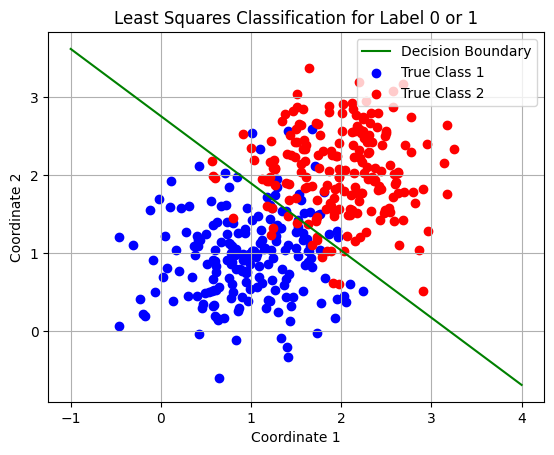

Accuracy of the Model:
0.9225


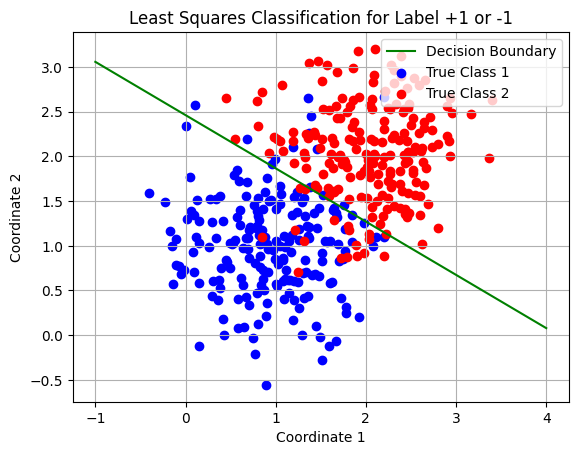

Laplacian Distributions
Accuracy of the Model:
0.9025


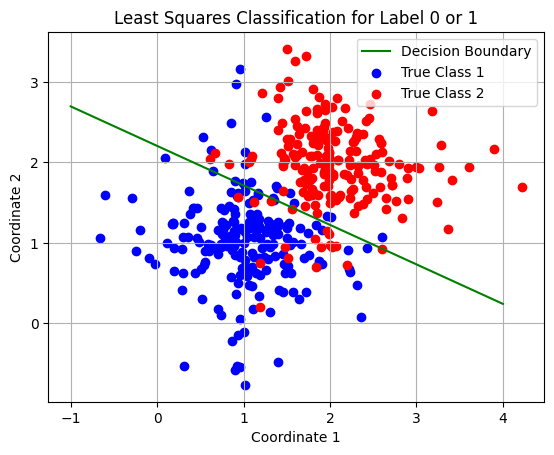

Accuracy of the Model:
0.9175


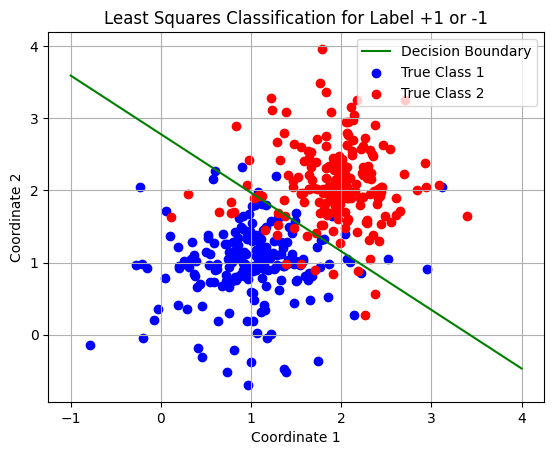

In [ ]:
########################################
#Part-1)-a: Data generation
########################################

print("Gaussian Distributions")

#Set the parameters of class distribution
mean1 = [1,1]           #Mean of class1
mean2 = [2,2]           #Mean of class2
cov = [[0.3,0],[0,0.3]] #Covariance matrix. Same covariance for class1 and class2

#Generate training data. You can use "np.random.multivariate_normal()" function to sample data points from multivariate Gaussian distribution
class1_tr = np.random.multivariate_normal(mean1, cov, 50)            #Class1 training data
class2_tr = np.random.multivariate_normal(mean2, cov, 50)            #Class2 training data
tr_data = np.vstack((class1_tr, class2_tr))              #Combine class1 training and class2 training data to get total training data
tr_targets = np.concatenate((np.repeat(np.array([0]), 50), np.repeat(np.array([1]), 50)))            #Class labels. Assign the value "0" to class1 and the value "1" to class2.
tr_targets = np.reshape(tr_targets, (tr_targets.shape[0], 1))

#Generate testing data.
class1_te = np.random.multivariate_normal(mean1, cov, 200)            #Class1 testing data
class2_te = np.random.multivariate_normal(mean2, cov, 200)            #Class2 testing data
te_data = np.vstack((class1_te, class2_te))              #Combine class1 testing and class2 testing data to get total testing data
te_targets = np.concatenate((np.repeat(np.array([0]), 200), np.repeat(np.array([1]), 200)))          #Class labels. Assign the value "0" to class1 and the value "1" to class2.
te_targets = np.reshape(te_targets, (te_targets.shape[0], 1))

########################################
#Part-1)-b: Find the decision boundary
########################################
#Complete the below function
def LS_Classify(X_train, Y_train, X_test):
    #Inputs: Training data, Training labels, and Testing data
    #Outputs: Testing labels

    x = np.ones((X_train.shape[0], 1))
    x = np.hstack((x, X_train))
    t = np.reshape(Y_train, (Y_train.shape[0], 1))

    #Impliment pseudo inverse solution to get the weight vector

    w_opt = np.dot(np.dot(np.linalg.inv(np.dot(x.T, x)), x.T), t)

    #Predict the lables of test data using the pseudo inverse solution

    x_test = np.ones((X_test.shape[0], 1))
    x_test = np.hstack((x_test, X_test))

    #Return the predicted test labels

    pred = np.dot(x_test, w_opt)
    pred = (np.sign(pred - 0.5) + 1)/2

    return pred, w_opt

#Get the test data predictions
predictions, w_opt = LS_Classify(tr_data, tr_targets, te_data)


##########################################
#Part-1)-c: Evaluate the quality of decision boundary
##########################################
#Complete the below function
def LS_Classify_Accuracy(Y_test, Y_pred):
    #Inputs: Ground truth test labels and predicted test labels
    #Outputs: Accuracy


    #Compute the accuracy
    y = np.abs(Y_test - Y_pred)
    num_zeros = np.count_nonzero(y==0)

    accuracy = num_zeros / Y_test.shape[0]

    #Return the accuracy

    return accuracy


print("Accuracy of the Model:")
print(LS_Classify_Accuracy(te_targets, predictions))

##########################################
#Part-1)-d: Visualize the decision boundary
##########################################

def Prediction(x, w_pred):
    return -(w_pred[1]*x + w_pred[0] - 0.5)/w_pred[2]

x = np.linspace(-1, 4, 100)

plt.plot(x, Prediction(x, w_opt), color='green', label = "Decision Boundary")
plt.scatter(class1_te[:, 0], class1_te[:, 1], color='blue', label = "True Class 1")
plt.scatter(class2_te[:, 0], class2_te[:, 1], color='red', label = "True Class 2")
plt.xlabel("Coordinate 1")
plt.ylabel("Coordinate 2")
plt.title("Least Squares Classification for Label 0 or 1")
plt.grid()
plt.legend(loc = 'upper right')
plt.show()

##########################################
#Part-1)-e: Change the target label notation, and repeat the experiments
##########################################


#Set the parameters of class distribution
mean1 = [1,1]           #Mean of class1
mean2 = [2,2]           #Mean of class2
cov = [[0.3,0],[0,0.3]] #Covariance matrix. Same covariance for class1 and class2

#Generate training data. You can use "np.random.multivariate_normal()" function to sample data points from multivariate Gaussian distribution
class1_tr = np.random.multivariate_normal(mean1, cov, 50)            #Class1 training data
class2_tr = np.random.multivariate_normal(mean2, cov, 50)            #Class2 training data
tr_data = np.vstack((class1_tr, class2_tr))              #Combine class1 training and class2 training data to get total training data
tr_targets = np.concatenate((np.repeat(np.array([-1]), 50), np.repeat(np.array([1]), 50)))            #Class labels. Assign the value "0" to class1 and the value "1" to class2.
tr_targets = np.reshape(tr_targets, (tr_targets.shape[0], 1))

#Generate testing data.
class1_te = np.random.multivariate_normal(mean1, cov, 200)            #Class1 testing data
class2_te = np.random.multivariate_normal(mean2, cov, 200)            #Class2 testing data
te_data = np.vstack((class1_te, class2_te))              #Combine class1 testing and class2 testing data to get total testing data
te_targets = np.concatenate((np.repeat(np.array([-1]), 200), np.repeat(np.array([1]), 200)))          #Class labels. Assign the value "0" to class1 and the value "1" to class2.
te_targets = np.reshape(te_targets, (te_targets.shape[0], 1))

########################################
#Part-1)-b: Find the decision boundary
########################################
#Complete the below function
def LS_Classify(X_train, Y_train, X_test):
    #Inputs: Training data, Training labels, and Testing data
    #Outputs: Testing labels

    x = np.ones((X_train.shape[0], 1))
    x = np.hstack((x, X_train))
    t = np.reshape(Y_train, (Y_train.shape[0], 1))

    #Impliment pseudo inverse solution to get the weight vector

    w_opt = np.dot(np.dot(np.linalg.inv(np.dot(x.T, x)), x.T), t)

    #Predict the lables of test data using the pseudo inverse solution

    x_test = np.ones((X_test.shape[0], 1))
    x_test = np.hstack((x_test, X_test))

    #Return the predicted test labels

    pred = np.dot(x_test, w_opt)
    pred = np.sign(pred)

    return pred, w_opt

#Get the test data predictions
predictions, w_opt = LS_Classify(tr_data, tr_targets, te_data)


print("Accuracy of the Model:")
print(LS_Classify_Accuracy(te_targets, predictions))

##########################################
#Part-1)-d: Visualize the decision boundary
##########################################

def Prediction(x, w_pred):
    return -(w_pred[1]*x + w_pred[0])/w_pred[2]

x = np.linspace(-1, 4, 100)

plt.plot(x, Prediction(x, w_opt), color='green', label = "Decision Boundary")
plt.scatter(class1_te[:, 0], class1_te[:, 1], color='blue', label = "True Class 1")
plt.scatter(class2_te[:, 0], class2_te[:, 1], color='red', label = "True Class 2")
plt.xlabel("Coordinate 1")
plt.ylabel("Coordinate 2")
plt.title("Least Squares Classification for Label +1 or -1")
plt.grid()
plt.legend(loc = 'upper right')
plt.show()

##########################################
#Part-1)-f: Repeat the experiments with Laplacial distribution
##########################################
print("Laplacian Distributions")

########################################
#Part-1)-a: Data generation
########################################

#Set the parameters of class distribution
mean1 = [1,1]           #Mean of class1
mean2 = [2,2]           #Mean of class2
cov = [[0.3,0],[0,0.3]] #Covariance matrix. Same covariance for class1 and class2

#Generate training data. You can use "np.random.multivariate_normal()" function to sample data points from multivariate Gaussian distribution
class1_tr1 = np.random.laplace(mean1[0], (cov[0][0]/2)**0.5, 50)
class1_tr1 = np.reshape(class1_tr1, (class1_tr1.shape[0], 1))
class1_tr2 = np.random.laplace(mean1[1], (cov[0][0]/2)**0.5, 50)
class1_tr2 = np.reshape(class1_tr2, (class1_tr2.shape[0], 1))
class1_tr = np.hstack((class1_tr1, class1_tr2))

class2_tr1 = np.random.laplace(mean2[0], (cov[1][1]/2)**0.5, 50)
class2_tr1 = np.reshape(class2_tr1, (class2_tr1.shape[0], 1))
class2_tr2 = np.random.laplace(mean2[1], (cov[1][1]/2)**0.5, 50)
class2_tr2 = np.reshape(class2_tr2, (class2_tr2.shape[0], 1))
class2_tr = np.hstack((class2_tr1, class2_tr2))


tr_data = np.vstack((class1_tr, class2_tr))
tr_targets = np.concatenate((np.repeat(np.array([0]), 50), np.repeat(np.array([1]), 50)))
tr_targets = np.reshape(tr_targets, (tr_targets.shape[0], 1))

#Generate testing data.
class1_te1 = np.random.laplace(mean1[0], (cov[0][0]/2)**0.5, 200)
class1_te1 = np.reshape(class1_te1, (class1_te1.shape[0], 1))
class1_te2 = np.random.laplace(mean1[1], (cov[0][0]/2)**0.5, 200)
class1_te2 = np.reshape(class1_te2, (class1_te2.shape[0], 1))
class1_te = np.hstack((class1_te1, class1_te2))

class2_te1 = np.random.laplace(mean2[0], (cov[1][1]/2)**0.5, 200)
class2_te1 = np.reshape(class2_te1, (class2_te1.shape[0], 1))
class2_te2 = np.random.laplace(mean2[1], (cov[1][1]/2)**0.5, 200)
class2_te2 = np.reshape(class2_te2, (class2_te2.shape[0], 1))
class2_te = np.hstack((class2_te1, class2_te2))

te_data = np.vstack((class1_te, class2_te))              #Combine class1 testing and class2 testing data to get total testing data
te_targets = np.concatenate((np.repeat(np.array([0]), 200), np.repeat(np.array([1]), 200)))          #Class labels. Assign the value "0" to class1 and the value "1" to class2.
te_targets = np.reshape(te_targets, (te_targets.shape[0], 1))

########################################
#Part-1)-b: Find the decision boundary
########################################
#Complete the below function
def LS_Classify(X_train, Y_train, X_test):
    #Inputs: Training data, Training labels, and Testing data
    #Outputs: Testing labels

    x = np.ones((X_train.shape[0], 1))
    x = np.hstack((x, X_train))
    t = np.reshape(Y_train, (Y_train.shape[0], 1))

    #Impliment pseudo inverse solution to get the weight vector

    w_opt = np.dot(np.dot(np.linalg.inv(np.dot(x.T, x)), x.T), t)

    #Predict the lables of test data using the pseudo inverse solution

    x_test = np.ones((X_test.shape[0], 1))
    x_test = np.hstack((x_test, X_test))

    #Return the predicted test labels

    pred = np.dot(x_test, w_opt)
    pred = (np.sign(pred - 0.5) + 1)/2

    return pred, w_opt

#Get the test data predictions
predictions, w_opt = LS_Classify(tr_data, tr_targets, te_data)

##########################################
#Part-1)-c: Evaluate the quality of decision boundary
##########################################
#Complete the below function
def LS_Classify_Accuracy(Y_test, Y_pred):
    #Inputs: Ground truth test labels and predicted test labels
    #Outputs: Accuracy


    #Compute the accuracy
    y = np.abs(Y_test - Y_pred)
    num_zeros = np.count_nonzero(y==0)

    accuracy = num_zeros / Y_test.shape[0]

    #Return the accuracy

    return accuracy

print("Accuracy of the Model:")
print(LS_Classify_Accuracy(te_targets, predictions))

##########################################
#Part-1)-d: Visualize the decision boundary
##########################################

def Prediction(x, w_pred):
    return -(w_pred[1]*x + w_pred[0] - 0.5)/w_pred[2]

x = np.linspace(-1, 4, 100)

plt.plot(x, Prediction(x, w_opt), color='green', label = "Decision Boundary")
plt.scatter(class1_te[:, 0], class1_te[:, 1], color='blue', label = "True Class 1")
plt.scatter(class2_te[:, 0], class2_te[:, 1], color='red', label = "True Class 2")
plt.xlabel("Coordinate 1")
plt.ylabel("Coordinate 2")
plt.title("Least Squares Classification for Label 0 or 1")
plt.grid()
plt.legend(loc = 'upper right')
plt.show()

##########################################
#Part-1)-e: Change the target label notation, and repeat the experiments
##########################################


#Set the parameters of class distribution
mean1 = [1,1]           #Mean of class1
mean2 = [2,2]           #Mean of class2
cov = [[0.3,0],[0,0.3]] #Covariance matrix. Same covariance for class1 and class2

class1_tr1 = np.random.laplace(mean1[0], (cov[0][0]/2)**0.5, 50)
class1_tr1 = np.reshape(class1_tr1, (class1_tr1.shape[0], 1))
class1_tr2 = np.random.laplace(mean1[1], (cov[0][0]/2)**0.5, 50)
class1_tr2 = np.reshape(class1_tr2, (class1_tr2.shape[0], 1))
class1_tr = np.hstack((class1_tr1, class1_tr2))

class2_tr1 = np.random.laplace(mean2[0], (cov[1][1]/2)**0.5, 50)
class2_tr1 = np.reshape(class2_tr1, (class2_tr1.shape[0], 1))
class2_tr2 = np.random.laplace(mean2[1], (cov[1][1]/2)**0.5, 50)
class2_tr2 = np.reshape(class2_tr2, (class2_tr2.shape[0], 1))
class2_tr = np.hstack((class2_tr1, class2_tr2))


tr_data = np.vstack((class1_tr, class2_tr))
tr_targets = np.concatenate((np.repeat(np.array([-1]), 50), np.repeat(np.array([1]), 50)))
tr_targets = np.reshape(tr_targets, (tr_targets.shape[0], 1))

#Generate testing data.
class1_te1 = np.random.laplace(mean1[0], (cov[0][0]/2)**0.5, 200)
class1_te1 = np.reshape(class1_te1, (class1_te1.shape[0], 1))
class1_te2 = np.random.laplace(mean1[1], (cov[0][0]/2)**0.5, 200)
class1_te2 = np.reshape(class1_te2, (class1_te2.shape[0], 1))
class1_te = np.hstack((class1_te1, class1_te2))

class2_te1 = np.random.laplace(mean2[0], (cov[1][1]/2)**0.5, 200)
class2_te1 = np.reshape(class2_te1, (class2_te1.shape[0], 1))
class2_te2 = np.random.laplace(mean2[1], (cov[1][1]/2)**0.5, 200)
class2_te2 = np.reshape(class2_te2, (class2_te2.shape[0], 1))
class2_te = np.hstack((class2_te1, class2_te2))

te_data = np.vstack((class1_te, class2_te))              #Combine class1 testing and class2 testing data to get total testing data
te_targets = np.concatenate((np.repeat(np.array([-1]), 200), np.repeat(np.array([1]), 200)))          #Class labels. Assign the value "0" to class1 and the value "1" to class2.
te_targets = np.reshape(te_targets, (te_targets.shape[0], 1))


########################################
#Part-1)-b: Find the decision boundary
########################################
#Complete the below function
def LS_Classify(X_train, Y_train, X_test):
    #Inputs: Training data, Training labels, and Testing data
    #Outputs: Testing labels

    x = np.ones((X_train.shape[0], 1))
    x = np.hstack((x, X_train))
    t = np.reshape(Y_train, (Y_train.shape[0], 1))

    #Impliment pseudo inverse solution to get the weight vector

    w_opt = np.dot(np.dot(np.linalg.inv(np.dot(x.T, x)), x.T), t)

    #Predict the lables of test data using the pseudo inverse solution

    x_test = np.ones((X_test.shape[0], 1))
    x_test = np.hstack((x_test, X_test))

    #Return the predicted test labels

    pred = np.dot(x_test, w_opt)
    pred = np.sign(pred)

    return pred, w_opt

#Get the test data predictions
predictions, w_opt = LS_Classify(tr_data, tr_targets, te_data)


print("Accuracy of the Model:")
print(LS_Classify_Accuracy(te_targets, predictions))

##########################################
#Part-1)-d: Visualize the decision boundary
##########################################

def Prediction(x, w_pred):
    return -(w_pred[1]*x + w_pred[0])/w_pred[2]

x = np.linspace(-1, 4, 100)

plt.plot(x, Prediction(x, w_opt), color='green', label = "Decision Boundary")
plt.scatter(class1_te[:, 0], class1_te[:, 1], color='blue', label = "True Class 1")
plt.scatter(class2_te[:, 0], class2_te[:, 1], color='red', label = "True Class 2")
plt.xlabel("Coordinate 1")
plt.ylabel("Coordinate 2")
plt.title("Least Squares Classification for Label +1 or -1")
plt.grid()
plt.legend(loc = 'upper right')
plt.show()

<b> Report your observations </b>

1. On adjusting the threshold appropriately, both the label sets have similar performances

2. For the given parameters, laplacian and gaussian datasets have similar performances

3. On average, the least squares model gives an accuracy of 0.9 for the given parameters





<b> Part - (2) :  Linear & Fisher Discriminant analysis : </b> In this segment of the programming task, you'll learn the technique of projecting data from higher-dimensional to lower-dimensional space using both Linear Discriminant Analysis and Fisher Discriminant Analysis.

a). Data generation: Consider a classification scenario with two classes. Class 1 follows a Gaussian distribution with a mean vector $\begin{bmatrix} 1  \\ 1  \end{bmatrix}$ and a covariance matrix $\begin{bmatrix} 0.3 & 0.0  \\ 0.0 & 0.3 \end{bmatrix}$. Class 2 follows a Gaussian distribution with a mean vector $\begin{bmatrix} 2  \\ 2  \end{bmatrix}$ and a covariance matrix $\begin{bmatrix} 0.3 & 0.0  \\ 0.0 & 0.3 \end{bmatrix}$. Employ these class distributions to generate 50 samples per class for training and 200 samples for testing.

b). Projection using only the between-class covariance: Develop a function for performing projection from 2-D space to 1-D utilizing Linear Discriminant Analysis. It's important to emphasize that this method only considers the between-class covariance. Project the previously generated 2-D synthetic data into 1-D and conduct classification. Plot both the original and projected data points on the same graph.

c). Projection utilizing both between-class and within-class covariance: Create a function to perform projection from 2-D space to 1-D using Fisher Discriminant Analysis. It's essential to mention that this method considers both between-class covariance and within-class covariance. Project the previously generated 2-D synthetic data into 1-D and conduct classification. Plot both the original and projected data points on the same graph.

d). Extend Fisher discriminant analysis function to project the data from N dimenision to K dimension.

e). Report your observations.


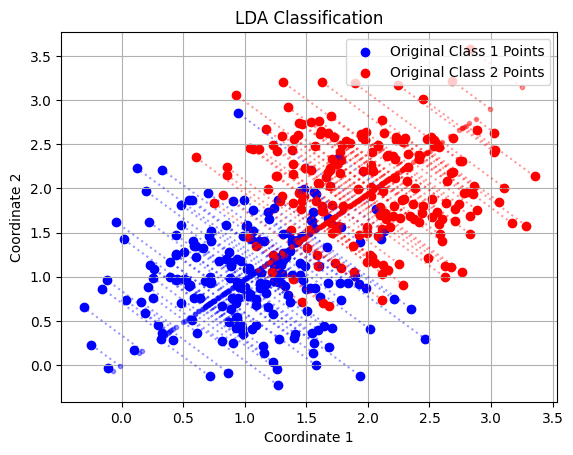

Accuracy with LDA: 89.75


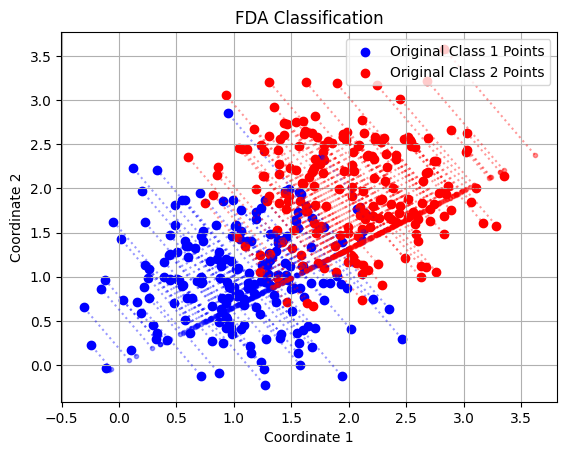

Accuracy with FDA: 89.0


In [ ]:
########################################
#Part-2)-(a): Data generation
########################################

#Set the parameters of class distribution
mean1 = [1,1]           #Mean of class1
mean2 = [2,2]           #Mean of class2
cov = [[0.3,0],[0,0.3]] #Covariance matrix. Same covariance for class1 and class2

#Generate training data. You can use "np.random.multivariate_normal()" function to sample data points from multivariate Gaussian distribution
class1_tr = np.random.multivariate_normal(mean1, cov, 50)            #Class1 training data
class2_tr = np.random.multivariate_normal(mean2, cov, 50)            #Class2 training data
tr_data = np.vstack((class1_tr, class2_tr))              #Combine class1 training and class2 training data to get total training data
tr_targets = np.concatenate((np.repeat(np.array([0]), 50), np.repeat(np.array([1]), 50)))            #Class labels. Assign the value "0" to class1 and the value "1" to class2.
tr_targets = np.reshape(tr_targets, (tr_targets.shape[0], 1))

#Generate testing data.
class1_te = np.random.multivariate_normal(mean1, cov, 200)            #Class1 testing data
class2_te = np.random.multivariate_normal(mean2, cov, 200)            #Class2 testing data
te_data = np.vstack((class1_te, class2_te))              #Combine class1 testing and class2 testing data to get total testing data
te_targets = np.concatenate((np.repeat(np.array([0]), 200), np.repeat(np.array([1]), 200)))          #Class labels. Assign the value "0" to class1 and the value "1" to class2.
te_targets = np.reshape(te_targets, (te_targets.shape[0], 1))

########################################
#Part-2)-(b)
########################################
#Complete the below function
def LDA_classify(X_train, Y_train, X_test):
  #Inputs: Training data, Training labels, and Testing data
  #Outputs: Between class covariance

  class1_tr = np.empty((0, X_train.shape[1]))
  class2_tr = np.empty((0, X_train.shape[1]))

  for i in range(Y_train.shape[0]):
      if Y_train[i, 0] == 0:
          class1_tr = np.vstack((class1_tr, X_train[i, :]))
      else:
          class2_tr = np.vstack((class2_tr, X_train[i, :]))

  m1_tr = np.sum(class1_tr, axis = 0)
  m1_tr = np.reshape(m1_tr, (1, m1_tr.shape[0]))/class1_tr.shape[0]
  m2_tr = np.sum(class2_tr, axis = 0)
  m2_tr = np.reshape(m2_tr, (1, m2_tr.shape[0]))/class2_tr.shape[0]


  #Compute the weight vector

  w_opt = m1_tr - m2_tr
  w_opt = w_opt.T

  #Compute the threshold

  proj1 = np.dot(m1_tr,w_opt)
  proj2 = np.dot(m2_tr,w_opt)

  threshold = (proj1[0, 0] + proj2[0, 0])/2

  #Project the data onto 1 dimensional space. Compare it with the threshold to make the decision

  projections = np.dot(X_test, w_opt) - threshold

  if proj1 - threshold > 0:
      predictions = (-1*np.sign(projections) + 1)/2
  else:
      predictions = (np.sign(projections) + 1)/2

  #Return weight vector and the predictions on testing data

  return predictions, w_opt

predictions, w = LDA_classify(tr_data, tr_targets, te_data)


def LDA_project(w, X_test, Y_test):
  #Inputs: weight vector, testing data, and testing labels

  class1_original = np.empty((0, X_test.shape[1]))
  class2_original = np.empty((0, X_test.shape[1]))

  for i in range(Y_test.shape[0]):
      if Y_test[i, 0] == 0:
          class1_original = np.vstack((class1_original, X_test[i, :]))
      else:
          class2_original = np.vstack((class2_original, X_test[i, :]))

  plt.figure()
  plt.scatter(class1_original[:, 0], class1_original[:, 1], color='blue', label = "Original Class 1 Points")
  plt.scatter(class2_original[:, 0], class2_original[:, 1], color='red', label = "Original Class 2 Points")

  r = np.reshape(w, (2,))
  n2 = np.linalg.norm(r)**2

  # Finding the projection on w vector for each point (Credits to Saketh Ram for idea on plotting projections)
  for pt in class1_original:
      prj = r * np.dot(r, pt) / n2
      plt.plot([prj[0], pt[0]], [prj[1], pt[1]], 'b.:', alpha=0.4)
  for pt in class2_original:
      prj = r * np.dot(r, pt) / n2
      plt.plot([prj[0], pt[0]], [prj[1], pt[1]], 'r.:', alpha=0.4)

  plt.xlabel("Coordinate 1")
  plt.ylabel("Coordinate 2")
  plt.title("LDA Classification")
  plt.grid()
  plt.legend(loc = 'upper right')
  plt.show()

LDA_project(w, te_data, te_targets)

#Compute and print the accuracy
acc = LS_Classify_Accuracy(te_targets, predictions)

print('Accuracy with LDA:', acc*100)


########################################
#Part-2)-(c)
########################################
def FDA_classify(X_train, Y_train, X_test):
  #Inputs: Training data, Training labels, and Testing data
  #Outputs: Between class covariance

  class1_tr = np.empty((0, X_train.shape[1]))
  class2_tr = np.empty((0, X_train.shape[1]))

  for i in range(Y_train.shape[0]):
      if Y_train[i, 0] == 0:
          class1_tr = np.vstack((class1_tr, X_train[i, :]))
      else:
          class2_tr = np.vstack((class2_tr, X_train[i, :]))

  m1_tr = np.sum(class1_tr, axis = 0)
  m1_tr = np.reshape(m1_tr, (1, m1_tr.shape[0]))/class1_tr.shape[0]
  m2_tr = np.sum(class2_tr, axis = 0)
  m2_tr = np.reshape(m2_tr, (1, m2_tr.shape[0]))/class2_tr.shape[0]

  S_w1 = np.dot((class1_tr - m1_tr).T, class1_tr - m1_tr)
  S_w2 = np.dot((class2_tr - m2_tr).T, class2_tr - m2_tr)

  S_w = S_w1 + S_w2

  #Compute the weight vector

  w_opt = np.dot(np.linalg.inv(S_w), (m1_tr - m2_tr).T)

  #Compute the threshold

  proj1 = np.dot(m1_tr,w_opt)
  proj2 = np.dot(m2_tr,w_opt)

  threshold = (proj1[0, 0] + proj2[0, 0])/2

  #Project the data onto 1 dimensional space. Compare it with the threshold to make the decision

  projections = np.dot(X_test, w_opt) - threshold

  if proj1 - threshold > 0:
      predictions = (-1*np.sign(projections) + 1)/2
  else:
      predictions = (np.sign(projections) + 1)/2

  #Return weight vector and the predictions on testing data

  return w_opt, predictions

w, predictions = FDA_classify(tr_data, tr_targets, te_data)


def FDA_project(w, X_test, Y_test):
  #Inputs: weight vector, testing data, and testing labels

  class1_original = np.empty((0, X_test.shape[1]))
  class2_original = np.empty((0, X_test.shape[1]))

  for i in range(Y_test.shape[0]):
      if Y_test[i, 0] == 0:
          class1_original = np.vstack((class1_original, X_test[i, :]))
      else:
          class2_original = np.vstack((class2_original, X_test[i, :]))

  #Plot the projections

  plt.figure()
  plt.scatter(class1_original[:, 0], class1_original[:, 1], color='blue', label = "Original Class 1 Points")
  plt.scatter(class2_original[:, 0], class2_original[:, 1], color='red', label = "Original Class 2 Points")

  r = np.reshape(w, (2,))
  n2 = np.linalg.norm(r)**2

  # Finding the projection on w vector for each point
  for pt in class1_original:
      prj = r * np.dot(r, pt) / n2
      plt.plot([prj[0], pt[0]], [prj[1], pt[1]], 'b.:', alpha=0.4)
  for pt in class2_original:
      prj = r * np.dot(r, pt) / n2
      plt.plot([prj[0], pt[0]], [prj[1], pt[1]], 'r.:', alpha=0.4)

  plt.xlabel("Coordinate 1")
  plt.ylabel("Coordinate 2")
  plt.title("FDA Classification")
  plt.grid()
  plt.legend(loc = 'upper right')
  plt.show()


FDA_project(w, te_data, te_targets)
#Compute and print the accuracy

acc = LS_Classify_Accuracy(te_targets, predictions)
print('Accuracy with FDA:', acc*100)

########################################
#Part-2)-(d)
########################################

# (No dataset to test on)

def FDA_project_K(X_train, Y_train, X_test, k):
  #Inputs: Training data, Training label, Testing data, and the number of eigen vectors to be considered
  #Oupur: Projection matrix
  num_classes = 9
  Classes = np.empty((num_classes, 0, X_train.shape[1]))
  for i in range(X_train.shape[0]):
      Classes[Y_train[i]] = np.vstack((Classes[Y_train[i]], X_train[i]))

  means = np.ones((num_classes, 1, X_train.shape[1]))
  for i in range(num_classes):
      means[i] = np.reshape(np.sum(Classes[i], axis = 0), (1, X_train.shape[1])) / Classes[i].shape[0]

  m_T = np.reshape(np.sum(X_train, axis = 0), (1, X_train.shape[1]))/X_train.shape[0]

  S_w = np.zeros((X_train.shape[1], X_train.shape[1]))
  for i in range(num_classes):
      delta_i = Classes[i].T - means[i]
      S_w += np.dot(delta_i, delta_i.T)

  delta = X_train.T - m_T
  S_t = np.dot(delta, delta.T)

  S_b = S_t - S_w

  eigen_val, eigen_vec = np.linalg.eigh(np.dot(np.linalg.inv(S_w), S_b))
  w = eigen_vec[:, eigen_vec.shape[1] - k:]

  #Compute and return the projection matrix
  return w





<b> Report your observations </b>

1. For the same dataset, the FDA generally performs better than the LDA, due to consideration of within class variance

2. LDA doesn't do very poorly here since within class covariance is not considerably large, and data is generally around the mean



<b> Part (3) : Classification using perceptron algorithm </b>

a). Data generation: Consider a classification scenario with two classes. Class 1 follows a Gaussian distribution with a mean vector $\begin{bmatrix} 1  \\ 1  \end{bmatrix}$ and a covariance matrix $\begin{bmatrix} 0.3 & 0.0  \\ 0.0 & 0.3 \end{bmatrix}$. Class 2 follows a Gaussian distribution with a mean vector $\begin{bmatrix} 2  \\ 2  \end{bmatrix}$ and a covariance matrix $\begin{bmatrix} 0.3 & 0.0  \\ 0.0 & 0.3 \end{bmatrix}$. Employ these class distributions to generate 50 samples per class for training and 200 samples for testing.


b). Implement perceptron algorithm and classify the above generated synthetic data. Plot the decision boundary/regions.

c). Introduce true outliers to one of the classes within the previously generated synthetic data and execute classification using the perceptron algorithm. Illustrate the decision boundary/regions. Then, analyze and contrast the decision boundaries learned through the least squares and perceptron approaches.

d). Let us consider four Gaussian distributions with mean vectors as $\begin{bmatrix} 0  \\ 0  \end{bmatrix}$, $\begin{bmatrix} 0  \\ 1  \end{bmatrix}$, $\begin{bmatrix} 1  \\ 1  \end{bmatrix}$, and $\begin{bmatrix} 1  \\ 0  \end{bmatrix}$, respectively. The covariance matrix is the same for all four Gaussian distributions, and the matrix is $\begin{bmatrix} 0.3 & 0.0  \\ 0.0 & 0.3 \end{bmatrix}$. Sample 60 data points from each distribution to get 240 data points. Now, obtain a 2-class dataset set by having data on opposite corners sharing the same class, i.e., data points sampled from Gaussian distributions with mean vectors $\begin{bmatrix} 0  \\ 0  \end{bmatrix}$ and $\begin{bmatrix} 1  \\ 1  \end{bmatrix}$ belong to class 1, and the data points sampled from the other two distributions belong to class 2. Assign class 1 data points with the label +1 and class 2 with the label -1. Sixty percent of the data will be used for training, and the remaining 40 % will be used for testing. You can see that it represents the XOR problem. Classify this data set using the perceptron algorithm.
  

e). Report your observations


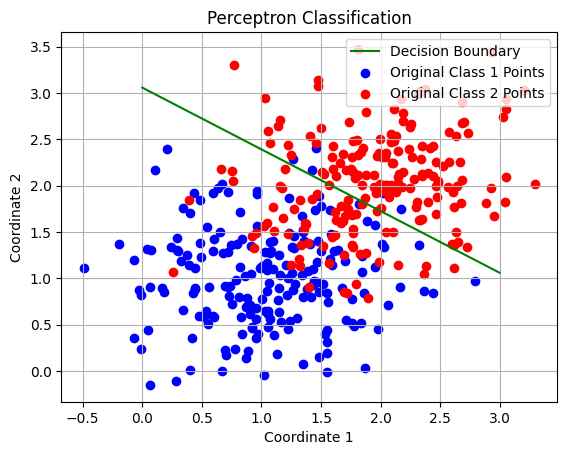

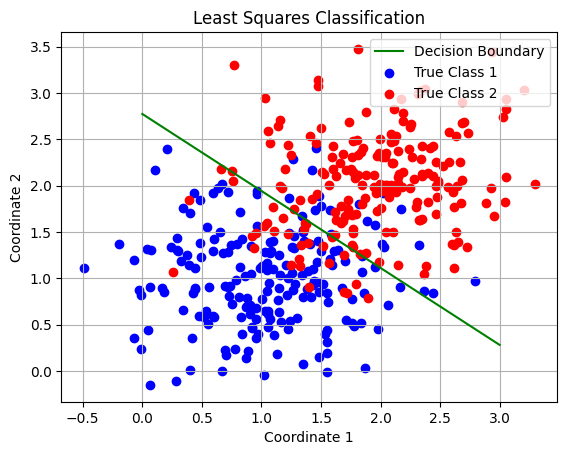

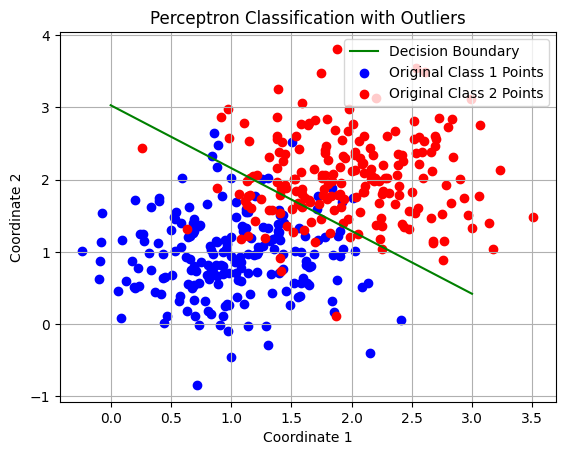

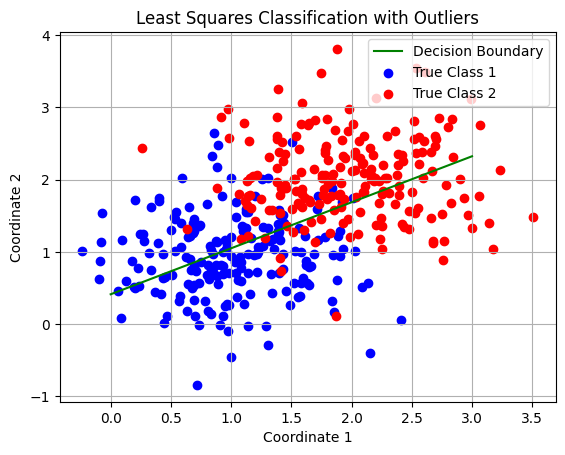

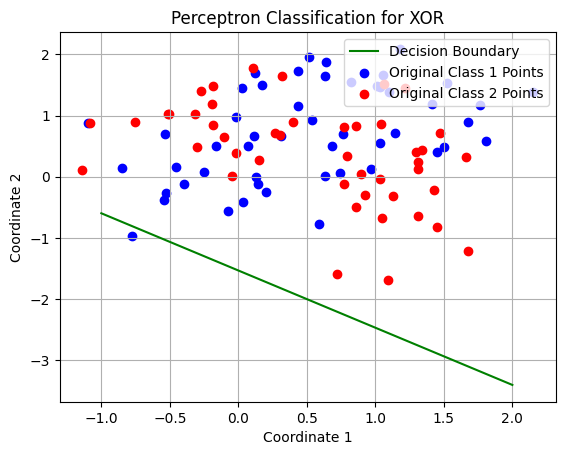

In [ ]:
########################################
#Part-3)-(a): Data generation
########################################

# Considering -1 and +1

#Set the parameters of class distribution
mean1 = [1,1]           #Mean of class1
mean2 = [2,2]           #Mean of class2
cov = [[0.3,0],[0,0.3]] #Covariance matrix. Same covariance for class1 and class2

#Generate training data. You can use "np.random.multivariate_normal()" function to sample data points from multivariate Gaussian distribution
class1_tr = np.random.multivariate_normal(mean1, cov, 50)            #Class1 training data
class2_tr = np.random.multivariate_normal(mean2, cov, 50)            #Class2 training data
tr_data = np.vstack((class1_tr, class2_tr))              #Combine class1 training and class2 training data to get total training data
tr_targets = np.concatenate((np.repeat(np.array([-1]), 50), np.repeat(np.array([1]), 50)))            #Class labels. Assign the value "0" to class1 and the value "1" to class2.
tr_targets = np.reshape(tr_targets, (tr_targets.shape[0], 1))

#Generate testing data.
class1_te = np.random.multivariate_normal(mean1, cov, 200)            #Class1 testing data
class2_te = np.random.multivariate_normal(mean2, cov, 200)            #Class2 testing data
te_data = np.vstack((class1_te, class2_te))              #Combine class1 testing and class2 testing data to get total testing data
te_targets = np.concatenate((np.repeat(np.array([-1]), 200), np.repeat(np.array([1]), 200)))          #Class labels. Assign the value "0" to class1 and the value "1" to class2.
te_targets = np.reshape(te_targets, (te_targets.shape[0], 1))

########################################
#Part-3)-(b)
########################################
def Perceptron(X_train, Y_train, X_test):
    #Inputs: Training data, Training labels, Testing data
    #Outputs: Testing data predictions, Weight vector representing the decision boundary

    epochs = 100    #Number of epochs

    X = np.hstack((np.ones((X_train.shape[0], 1)), X_train))         #Data. Append ones to the training data to take care of the bias
    w = np.zeros((X.shape[1], 1))         #Initialize the weight vector
    for epoch in range(0,epochs,1):
        #Compute the predictions
        predictions = np.dot(X, w)
        predictions = np.sign(predictions)
        predictions = np.sign(predictions + 0.5) # To make a 0 prediction classified as 1

        mult = (Y_train - predictions)/2
        #Update the weight vector
        w = w + np.dot(X.T, np.reshape(mult, (mult.shape[0], 1)))

    #Compute the test data predicitions using the final weight vector
    X_test_aug = np.hstack((np.ones((X_test.shape[0], 1)), X_test))

    predictions = np.dot(X_test_aug, w)
    predictions = np.sign(predictions)
    predictions = np.sign(predictions + 0.5) # To make a 0 prediction classified as 1


    #Return the test data predictions and the final weight vector
    return predictions, w


##########################################
#Plot the decision boundary using perceptron
##########################################

predictions, w_percep = Perceptron(tr_data, tr_targets, te_data)

def Prediction(x, w_pred):
    return -(w_pred[1]*x + w_pred[0])/w_pred[2]

x = np.linspace(0, 3, 100)

plt.plot(x, Prediction(x, w_percep), color='green', label = "Decision Boundary")
plt.scatter(class1_te[:, 0], class1_te[:, 1], color='blue', label = "Original Class 1 Points")
plt.scatter(class2_te[:, 0], class2_te[:, 1], color='red', label = "Original Class 2 Points")
plt.xlabel("Coordinate 1")
plt.ylabel("Coordinate 2")
plt.title("Perceptron Classification")
plt.grid()
plt.legend(loc = 'upper right')
plt.show()

##########################################
#Plot the decision boundary using least squares
##########################################

predictions, w_ls = LS_Classify(tr_data, tr_targets, te_data)

def Prediction(x, w_pred):
    return -(w_pred[1]*x + w_pred[0])/w_pred[2]

x = np.linspace(0, 3, 100)


plt.plot(x, Prediction(x, w_ls), color='green', label = "Decision Boundary")
plt.scatter(class1_te[:, 0], class1_te[:, 1], color='blue', label = "True Class 1")
plt.scatter(class2_te[:, 0], class2_te[:, 1], color='red', label = "True Class 2")
plt.xlabel("Coordinate 1")
plt.ylabel("Coordinate 2")
plt.title("Least Squares Classification")
plt.grid()
plt.legend(loc = 'upper right')
plt.show()


##########################################
#Part-3)-(c): Repeat the experiments with the true outliers added to the data. Compare and contrast the perceptron algorithm with least squares method
##########################################

# Outliers have a mean of [-100, -100] and are classified as class 1

# Considering -1 and +1
#Set the parameters of class distribution
mean1 = [1,1]           #Mean of class1
mean2 = [2,2]           #Mean of class2
cov = [[0.3,0],[0,0.3]] #Covariance matrix. Same covariance for class1 and class2
mean3 = [-100, -100]

#Generate training data. You can use "np.random.multivariate_normal()" function to sample data points from multivariate Gaussian distribution
class1_tr = np.random.multivariate_normal(mean1, cov, 50)            #Class1 training data
class2_tr = np.random.multivariate_normal(mean2, cov, 50)            #Class2 training data
class1_tr_out = np.random.multivariate_normal(mean3, cov, 10)
class1_tr = np.vstack((class1_tr, class1_tr_out))

tr_data = np.vstack((class1_tr, class2_tr))              #Combine class1 training and class2 training data to get total training data
tr_targets = np.concatenate((np.repeat(np.array([-1]), 60), np.repeat(np.array([1]), 50)))            #Class labels. Assign the value "0" to class1 and the value "1" to class2.
tr_targets = np.reshape(tr_targets, (tr_targets.shape[0], 1))

#Generate testing data.
class1_te = np.random.multivariate_normal(mean1, cov, 200)            #Class1 testing data
class2_te = np.random.multivariate_normal(mean2, cov, 200)            #Class2 testing data
te_data = np.vstack((class1_te, class2_te))              #Combine class1 testing and class2 testing data to get total testing data
te_targets = np.concatenate((np.repeat(np.array([-1]), 200), np.repeat(np.array([1]), 200)))          #Class labels. Assign the value "0" to class1 and the value "1" to class2.
te_targets = np.reshape(te_targets, (te_targets.shape[0], 1))

########################################
#Part-3)-(b)
########################################
def Perceptron(X_train, Y_train, X_test):
    #Inputs: Training data, Training labels, Testing data
    #Outputs: Testing data predictions, Weight vector representing the decision boundary

    epochs = 100    #Number of epochs

    X = np.hstack((np.ones((X_train.shape[0], 1)), X_train))         #Data. Append ones to the training data to take care of the bias
    w = np.zeros((X.shape[1], 1))         #Initialize the weight vector
    for epoch in range(0,epochs,1):
        #Compute the predictions
        predictions = np.dot(X, w)
        predictions = np.sign(predictions)
        predictions = np.sign(predictions + 0.5) # To make a 0 prediction classified as 1

        mult = (Y_train - predictions)/2
        #Update the weight vector
        w = w + np.dot(X.T, np.reshape(mult, (mult.shape[0], 1)))

    #Compute the test data predicitions using the final weight vector
    X_test_aug = np.hstack((np.ones((X_test.shape[0], 1)), X_test))

    predictions = np.dot(X_test_aug, w)
    predictions = np.sign(predictions)
    predictions = np.sign(predictions + 0.5) # To make a 0 prediction classified as 1


    #Return the test data predictions and the final weight vector
    return predictions, w


##########################################
#Plot the decision boundary using perceptron
##########################################

predictions, w_percep = Perceptron(tr_data, tr_targets, te_data)

def Prediction(x, w_pred):
    return -(w_pred[1]*x + w_pred[0])/w_pred[2]

x = np.linspace(0, 3, 100)

plt.plot(x, Prediction(x, w_percep), color='green', label = "Decision Boundary")
plt.scatter(class1_te[:, 0], class1_te[:, 1], color='blue', label = "Original Class 1 Points")
plt.scatter(class2_te[:, 0], class2_te[:, 1], color='red', label = "Original Class 2 Points")
plt.xlabel("Coordinate 1")
plt.ylabel("Coordinate 2")
plt.title("Perceptron Classification with Outliers")
plt.grid()
plt.legend(loc = 'upper right')
plt.show()


##########################################
#Plot the decision boundary using least squares
##########################################

predictions, w_ls = LS_Classify(tr_data, tr_targets, te_data)

def Prediction(x, w_pred):
    return -(w_pred[1]*x + w_pred[0])/w_pred[2]

x = np.linspace(0, 3, 100)


plt.plot(x, Prediction(x, w_ls), color='green', label = "Decision Boundary")
plt.scatter(class1_te[:, 0], class1_te[:, 1], color='blue', label = "True Class 1")
plt.scatter(class2_te[:, 0], class2_te[:, 1], color='red', label = "True Class 2")
plt.xlabel("Coordinate 1")
plt.ylabel("Coordinate 2")
plt.title("Least Squares Classification with Outliers")
plt.grid()
plt.legend(loc = 'upper right')
plt.show()

##########################################
#Part-3)-(d): Data generation XOR
##########################################

#Set the parameters of Gaussian distribution
class1_mean1 = [0, 0]     #Mean of Gaussian1
class1_mean2 = [1, 1]     #Mean of Gaussian3
class2_mean1 = [0, 1]     #Mean of Gaussian2
class2_mean2 = [1, 0]     #Mean of Gaussian4
cov = [[0.3, 0], [0, 0.3]]  #Covariance matrix. Same covariance for class1 and class2

#Generate  data. You can use "np.random.multivariate_normal()" function to sample data points from multivariate Gaussian distribution

class1_data1 = np.random.multivariate_normal(class1_mean1, cov, 60)
class1_data2 = np.random.multivariate_normal(class1_mean2, cov, 60)
class2_data1 = np.random.multivariate_normal(class2_mean1, cov, 60)
class2_data2 = np.random.multivariate_normal(class2_mean2, cov, 60)

#Obtain 2-class dataset

tr_data = np.vstack((class1_data1, class1_data2, class2_data1, class2_data2))
tr_targets = np.concatenate((np.repeat(np.array([-1]), 120), np.repeat(np.array([1]), 120)))
tr_targets = np.reshape(tr_targets, (tr_targets.shape[0], 1))

#Create train test splits

data = np.hstack((tr_data, tr_targets))
np.random.shuffle(data)

train_data = data[:int(data.shape[0]*3/5)]
test_data = data[int(data.shape[0]*3/5) + 1:]

tr_data = train_data[:, :2]
tr_targets = train_data[:, 2]
tr_targets = np.reshape(tr_targets, (tr_targets.shape[0], 1))

te_data = test_data[:, :2]
te_targets = test_data[:, 2]
te_targets = np.reshape(te_targets, (te_targets.shape[0], 1))

class1_te = np.empty((0, 2))
class2_te = np.empty((0, 2))

for i in range(te_targets.shape[0]):
    if te_targets[i] == -1:
        class1_te = np.vstack((class1_te, te_data[i]))
    else:
        class2_te = np.vstack((class2_te, te_data[i]))

#Classify this dataset using perceptron algorithm

predictions, w_percep = Perceptron(tr_data, tr_targets, te_data)

#Plot the decision boundary
def Prediction(x, w_pred):
    return -(w_pred[1]*x + w_pred[0])/w_pred[2]

x = np.linspace(-1, 2, 100)

plt.plot(x, Prediction(x, w_percep), color='green', label = "Decision Boundary")
plt.scatter(class1_te[:, 0], class1_te[:, 1], color='blue', label = "Original Class 1 Points")
plt.scatter(class2_te[:, 0], class2_te[:, 1], color='red', label = "Original Class 2 Points")
plt.xlabel("Coordinate 1")
plt.ylabel("Coordinate 2")
plt.title("Perceptron Classification for XOR")
plt.grid()
plt.legend(loc = 'upper right')
plt.show()




<b> Report your observations </b>

1. For data without outliers, least squares and perceptron performs similarly.

2. For data with outliers, perceptron performs much better, since it doesn't consider the 'amount of correctness' of the training data points. Least squares is highly affected by outliers

3. Since the error doesn't progressively decrease in the perceptron algorithm, for non-linearly separable data like XOR, it may give a very poor model. The algorithm oscillates and doesn't converge



<b> Part (4) : Understanding the decision boundaries of MAP approach to classification - </b> Decision boundary in 2 class classification problem is the locus of points satisfying $p(c_{1}/x)$ = $p(c_{2}/x)$. Where $c_{1}$ and $c_{2}$ are the class indicators and $x$ is the data. With proper assumpuptions on prior and likelihood, p(c/x) follows Gaussian distribution with appropriate parameters. Given the parameters of the Guassian distribution for the two classes i.e $\mu_{1},\Sigma_{1},\mu_{2},\Sigma_{2}$, we can derive the decision boundary equation i.e W and $w_{0}$. You may refer to class notes for the derivations and final equations. In this part of programming assignment we expect you to code the decision boundaries for the Gaussian distribution case and understand them.

**a). Class distributions share the same covariance matrix: Linear decision boundary.**
  0. Let $\mu_{1} = \begin{bmatrix} 1  \\ 1 \end{bmatrix}$, $\mu_{2} = \begin{bmatrix} 4  \\ 1 \end{bmatrix}$, and $\Sigma_{1}= \Sigma_{2} = \Sigma =  \begin{bmatrix} 0.1 & 0.0  \\ 0.0 & 0.1 \end{bmatrix}$
  1. Generate 100 samples from each class. This data set is used to understand the decision boundaries when $p(c_{1}) = p(c_{2})$
  2. Generate 50 samples from class1 and 150 samples from class2. This data set is used to understand the decision boundaries when $p(c_{1}) < p(c_{2})$
  3. Generate 150 samples from class1 and 50 samples from class2. This data set is used to understand the decision boundaries when $p(c_{1}) > p(c_{2})$
  4. Plot the decision boundaries for all the three cases in three different subplots.


**b). Class distributions have different covariance matrices: Non-linear decision boundary.**
  0. Let $\mu_{1} = \begin{bmatrix} 1  \\ 1 \end{bmatrix}$, $\mu_{2} = \begin{bmatrix} 3  \\ 1 \end{bmatrix}$, $\Sigma_{1}=   \begin{bmatrix} 0.2 & 0.0  \\ 0.0 & 0.02 \end{bmatrix}$, and $\Sigma_{2}=   \begin{bmatrix} 0.02 & 0.0  \\ 0.0 & 0.2 \end{bmatrix}$
  1. Generate 100 samples from each class. This data set is used to understand the decision boundaries when $p(c_{1}) = p(c_{2})$
  2. Generate 50 samples from class1 and 150 samples from class2. This data set is used to understand the decision boundaries when $p(c_{1}) < p(c_{2})$
  3. Generate 150 samples from class1 and 50 samples from class2. This data set is used to understand the decision boundaries when $p(c_{1}) > p(c_{2})$
  4. Plot the decision boundaries for all the three cases in three different subplots.


**c). Report your observations**




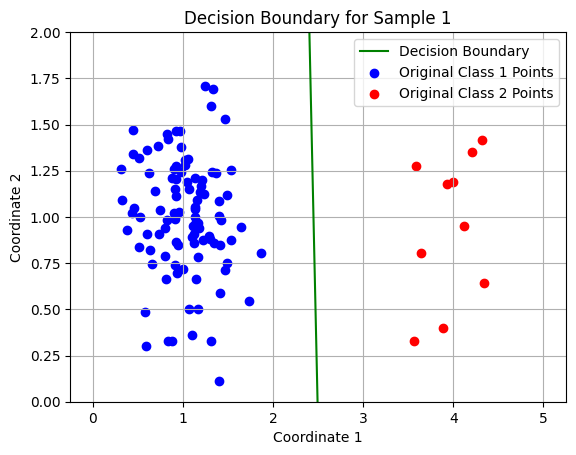

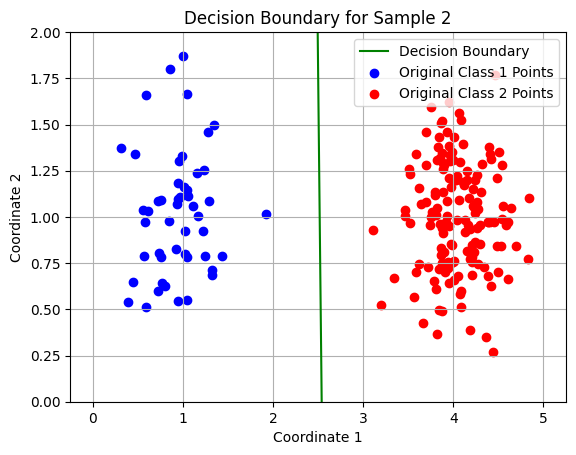

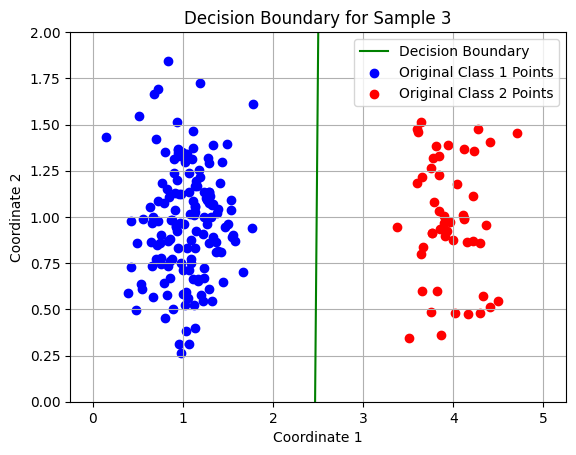

In [ ]:
##########################################
#Part-4a)-0: Data Generation
##########################################
m1 = [1, 1]
m2 = [4, 1]
cov = [[0.1, 0], [0, 0.1]]

#Case1: Generate 100 samples from each class. You may use "np.random.multivariate_normal()" function to sample data points of multi-variate Gaussian distribution
class1_s1 = np.random.multivariate_normal(m1, cov, 100)
class2_s1 = np.random.multivariate_normal(m2, cov, 100)
data_1 = np.vstack((class1_s1, class2_s1))
targets_1 = np.concatenate((np.repeat(np.array([-1]), 100), np.repeat(np.array([1]), 100)))
targets_1 = np.reshape(targets_1, (targets_1.shape[0], 1))

#Case2: Generate 50 samples from class1 and 150 samples from class2. You may use "np.random.multivariate_normal()" function to sample data points of multi-variate Gaussian distribution
class1_s2 = np.random.multivariate_normal(m1, cov, 50)
class2_s2 = np.random.multivariate_normal(m2, cov, 150)
data_2 = np.vstack((class1_s2, class2_s2))
targets_2 = np.concatenate((np.repeat(np.array([-1]), 50), np.repeat(np.array([1]), 150)))
targets_2 = np.reshape(targets_2, (targets_2.shape[0], 1))

#Case3: Generate 150 samples from class1 and 50 samples from class2. You may use "np.random.multivariate_normal()" function to sample data points of multi-variate Gaussian distribution
class1_s3 = np.random.multivariate_normal(m1, cov, 150)
class2_s3 = np.random.multivariate_normal(m2, cov, 50)
data_3 = np.vstack((class1_s3, class2_s3))
targets_3 = np.concatenate((np.repeat(np.array([-1]), 150), np.repeat(np.array([1]), 50)))
targets_3 = np.reshape(targets_3, (targets_3.shape[0], 1))

##########################################
#Part-4a)-4: Plot the decision regions for all the three cases
##########################################
#Complete the below function
def decisionBoundary(X_train, Y_train):
    #Inputs: Training data and Training labels
    #Outputs: Decision boundary parameters, i.e., w0, w
    p_c1 = np.count_nonzero(Y_train == 1)/Y_train.shape[0]
    p_c2 = 1. - p_c1

    data = np.hstack((X_train, Y_train))

    data_class1 = (data[data[:, 2]==-1]) [:, :2]
    data_class2 = (data[data[:, 2]==1]) [:, :2]
    mean_1 = np.sum(data_class1, axis = 0)
    mean_1 = (mean_1/data_class1.shape[0])[:2]
    mean_1 = np.reshape(mean_1, (mean_1.shape[0], 1))

    mean_2 = np.sum(data_class2, axis = 0)
    mean_2 = (mean_2/data_class2.shape[0])[:2]
    mean_2 = np.reshape(mean_2, (mean_2.shape[0], 1))

    cov1 = np.dot(data_class1.T - mean_1, (data_class1.T - mean_1).T) / data_class1.shape[0]
    cov2 = np.dot(data_class2.T - mean_2, (data_class2.T - mean_2).T) / data_class2.shape[0]

    cov = (cov1*data_class1.shape[0] + cov2*data_class2.shape[0])/2/data.shape[0]

    w = np.dot(np.linalg.inv(cov), mean_1 - mean_2)
    w0 = -0.5*np.dot(mean_1.T, np.dot(np.linalg.inv(cov), mean_1)) + 0.5*np.dot(mean_2.T, np.dot(np.linalg.inv(cov), mean_2)) + np.log(p_c1/p_c2)
    w0 = np.reshape(w0, (1, 1))
    w = np.vstack((w0, w))

    return w

#Plot the decision regions
def Prediction(x, w_pred):
    return -(w_pred[1]*x + w_pred[0])/w_pred[2]

w_s1 = decisionBoundary(data_1, targets_1)

x = np.linspace(0, 5, 100)

plt.plot(x, Prediction(x, w_s1), color='green', label = "Decision Boundary")
plt.scatter(class1_s1[:, 0], class1_s1[:, 1], color='blue', label = "Original Class 1 Points")
plt.scatter(class2_s1[:, 0], class2_s1[:, 1], color='red', label = "Original Class 2 Points")
plt.xlabel("Coordinate 1")
plt.ylabel("Coordinate 2")
plt.title("Decision Boundary for Sample 1")
plt.grid()
plt.legend(loc = 'upper right')
plt.ylim(0, 2)
plt.show()


w_s2 = decisionBoundary(data_2, targets_2)

x = np.linspace(0, 5, 100)

plt.plot(x, Prediction(x, w_s2), color='green', label = "Decision Boundary")
plt.scatter(class1_s2[:, 0], class1_s2[:, 1], color='blue', label = "Original Class 1 Points")
plt.scatter(class2_s2[:, 0], class2_s2[:, 1], color='red', label = "Original Class 2 Points")
plt.xlabel("Coordinate 1")
plt.ylabel("Coordinate 2")
plt.title("Decision Boundary for Sample 2")
plt.grid()
plt.legend(loc = 'upper right')
plt.ylim(0, 2)
plt.show()

w_s3 = decisionBoundary(data_3, targets_3)

x = np.linspace(0, 5, 100)

plt.plot(x, Prediction(x, w_s3), color='green', label = "Decision Boundary")
plt.scatter(class1_s3[:, 0], class1_s3[:, 1], color='blue', label = "Original Class 1 Points")
plt.scatter(class2_s3[:, 0], class2_s3[:, 1], color='red', label = "Original Class 2 Points")
plt.xlabel("Coordinate 1")
plt.ylabel("Coordinate 2")
plt.title("Decision Boundary for Sample 3")
plt.grid()
plt.legend(loc = 'upper right')
plt.ylim(0, 2)
plt.show()

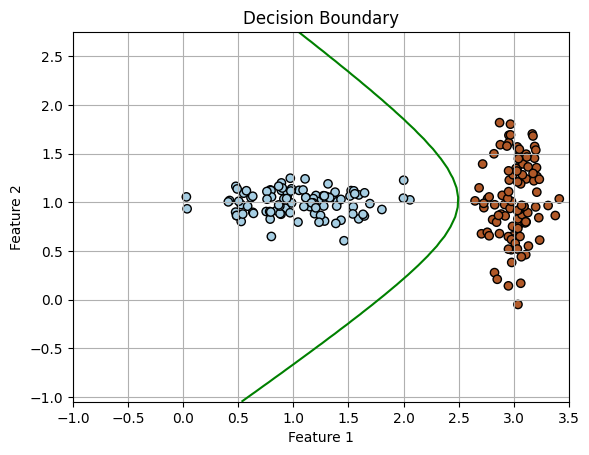

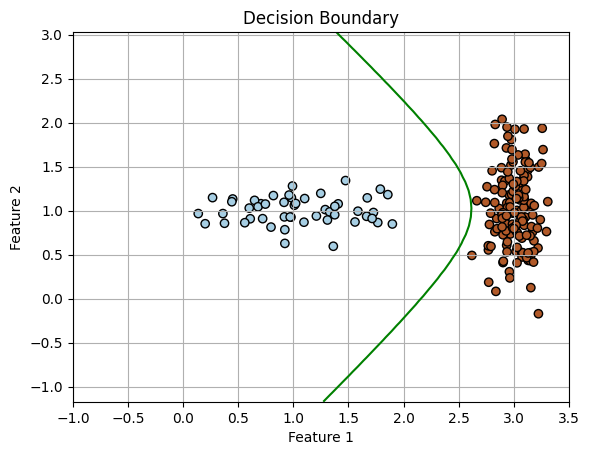

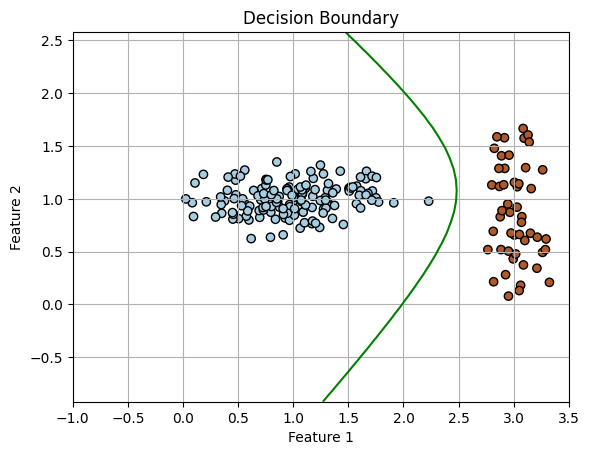

In [ ]:
# Remaining: observations

##########################################
#Part-4b)-0: Data Generation
##########################################
m1 = np.array([1, 1])
m2 = np.array([3, 1])
cov1 = np.array([[0.2, 0], [0, 0.02]])
cov2 = np.array([[0.02, 0], [0, 0.2]])

#Case1: Generate 100 samples from each class. You may use "np.random.multivariate_normal()" function to sample data points of multi-variate Gaussian distribution
class1_s1 = np.random.multivariate_normal(m1, cov1, 100)
class2_s1 = np.random.multivariate_normal(m2, cov2, 100)
data_1 = np.vstack((class1_s1, class2_s1))
targets_1 = np.concatenate((np.repeat(np.array([-1]), 100), np.repeat(np.array([1]), 100)))
targets_1 = np.reshape(targets_1, (targets_1.shape[0], 1))

#Case2: Generate 50 samples from class1 and 150 samples from class2. You may use "np.random.multivariate_normal()" function to sample data points of multi-variate Gaussian distribution
class1_s2 = np.random.multivariate_normal(m1, cov1, 50)
class2_s2 = np.random.multivariate_normal(m2, cov2, 150)
data_2 = np.vstack((class1_s2, class2_s2))
targets_2 = np.concatenate((np.repeat(np.array([-1]), 50), np.repeat(np.array([1]), 150)))
targets_2 = np.reshape(targets_2, (targets_2.shape[0], 1))

#Case3: Generate 150 samples from class1 and 50 samples from class2. You may use "np.random.multivariate_normal()" function to sample data points of multi-variate Gaussian distribution
class1_s3 = np.random.multivariate_normal(m1, cov1, 150)
class2_s3 = np.random.multivariate_normal(m2, cov2, 50)
data_3 = np.vstack((class1_s3, class2_s3))
targets_3 = np.concatenate((np.repeat(np.array([-1]), 150), np.repeat(np.array([1]), 50)))
targets_3 = np.reshape(targets_3, (targets_3.shape[0], 1))

##########################################
#Part-4b)-4: Plot the decision regions for all the three cases
##########################################
#Complete the below function

def multivariate_gaussian(input, mean, cov_inv):
    likelihoods = []
    for i in range(input.shape[0]):
        inp_i = np.reshape(input[i, :].T, (2, 1))

        likelihoods.append(np.log((np.linalg.norm(cov_inv))**(0.5) * np.exp(-0.5*np.dot((inp_i-mean).T, np.dot(cov_inv, inp_i-mean)))[0, 0]))

    return np.asarray(likelihoods)


# For the given data, plotting the decision boundary
def decisionBoundary(X_train, Y_train):
    # Inputs: Training data and Training labels
    # Outputs: Decision boundary parameters, i.e., w0, w

    p_c1 = np.count_nonzero(Y_train == 1) / Y_train.shape[0]
    p_c2 = 1. - p_c1

    data = np.hstack((X_train, Y_train))

    data_class1 = data[data[:, 2] == -1][:, :2]
    data_class2 = data[data[:, 2] == 1][:, :2]

    mean_1 = np.mean(data_class1, axis=0)[:2]
    mean_1 = mean_1.reshape(-1, 1)

    mean_2 = np.mean(data_class2, axis=0)[:2]
    mean_2 = mean_2.reshape(-1, 1)

    cov1 = np.cov(data_class1.T)
    cov2 = np.cov(data_class2.T)

    # Generate mesh grid
    x_min, x_max = X_train[:, 0].min() - 1, X_train[:, 0].max() + 1
    y_min, y_max = X_train[:, 1].min() - 1, X_train[:, 1].max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.1),
                         np.arange(y_min, y_max, 0.1))
    grid = np.c_[xx.ravel(), yy.ravel()]

    # Compute posterior probabilities
    posterior1 = multivariate_gaussian(grid, mean_1, np.linalg.inv(cov1)) + np.log(p_c1)
    posterior2 = multivariate_gaussian(grid, mean_2, np.linalg.inv(cov2)) + np.log(p_c2)

    # Find points where posterior1 = posterior2
    equal_posterior_points = grid[np.isclose(posterior1, posterior2, atol=2.5)]

    # Plot data points and decision boundary
    plt.scatter(X_train[:, 0], X_train[:, 1], c=Y_train, cmap=plt.cm.Paired, edgecolors='k')
    plt.contour(xx, yy, (posterior1 - posterior2).reshape(xx.shape), levels=[0], colors='green', linestyles='solid')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.xlim((-1, 3.5))
    plt.grid()
    plt.title('Decision Boundary')
    plt.show()


decisionBoundary(data_1, targets_1)
decisionBoundary(data_2, targets_2)
decisionBoundary(data_3, targets_3)


<b> Report your observations </b>

1. When the datapoints of the classes have similar covariances, the decision boundary is linear. For the given cases of p[C1] and p[C2], the models are almost similar.

2. When the datapoints have different covariances, the decision boundary is nonlinear (quadratic). This was plotted using a contour plot. For the given cases of p[C1] and p[C2], the models are almost similar.



<b> Part-5) Classification using logistic regression ( Iterative reweighted least squares approach ): </b> logistic regression model: $y = \frac{1}{1+e^{-\textbf{w}^{T}\textbf{x}}}$. With the provided training data, X_train and Y_train, your task is to identify the optimal $\textbf{w}$ that accurately predicts y based on the input $\textbf{x}$. Subsequently, this $\textbf{w}$ can be applied to predict outcomes on the test data, X_test.





a). Data generation: Consider a classification scenario with two classes. Class 1 follows a Gaussian distribution with a mean vector $\begin{bmatrix} 1  \\ 1  \end{bmatrix}$ and a covariance matrix $\begin{bmatrix} 0.3 & 0.0  \\ 0.0 & 0.3 \end{bmatrix}$. Class 2 follows a Gaussian distribution with a mean vector $\begin{bmatrix} 2  \\ 2  \end{bmatrix}$ and a covariance matrix $\begin{bmatrix} 0.3 & 0.0  \\ 0.0 & 0.3 \end{bmatrix}$. Employ these class distributions to generate 50 samples per class for training and 200 samples for testing.

b). Create a function called "Logistic_Regression" that accepts training data, training labels, and testing data as inputs. The function should aim to discover the optimal $\textbf{w}$ using the training data. You can initialize $\textbf{w}$ with random values and iteratively update it to determine the optimal $\textbf{w}$. Subsequently, this optimal $\textbf{w}$ can be employed to make predictions on the test data.

c). Evaluate the classification performance, i.e., compute the accuracy on the test data.

d). Write a function to generate & visualize the decision regions, either by showing the boundary line or by using different colors for the two regions. Overlay the test points using scatter.

e). Introduce genuine outliers to one of the class datasets generated previously. Then, conduct Least Squares classification and Logistic Regression on this modified dataset. Plot the decision boundaries/regions and provide insights into the differences between their outcomes.


f). Report your observations




 Accuracy with Logistic Regression: 88.75 




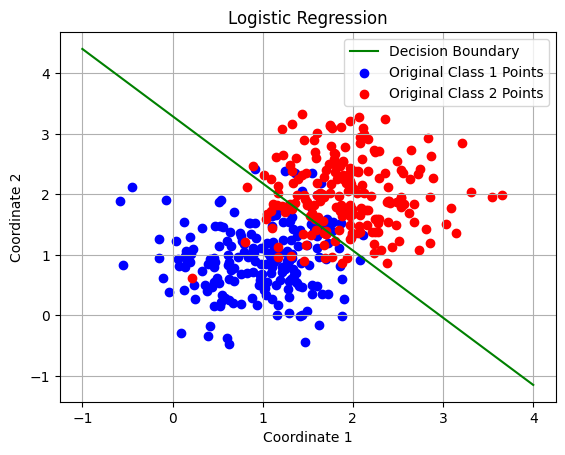

<ipython-input-12-a48082ad1c45>:36: RuntimeWarning: overflow encountered in exp
  return 1/(1+np.exp(-a))




 Accuracy with Logistic Regression: 91.25 




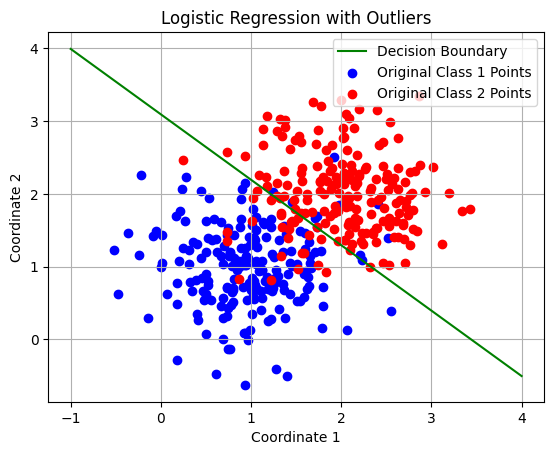



 Accuracy with Least Squares Classification: 47.25 




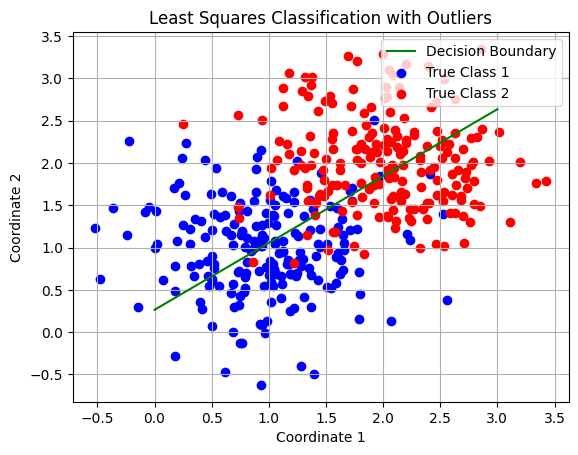

In [ ]:
##################################################
#Part-5)-1: Data generation
##################################################

def LR_Accuracy(Y_test, Y_pred):
    accuracy = np.mean(Y_pred == Y_test)

    return accuracy*100

#Set the parameters of class distribution
mean1 = [1, 1]           #Mean of class1
mean2 = [2, 2]           #Mean of class2
cov = [[0.3, 0], [0, 0.3]] #Covariance matrix. Same covariance for class1 and class2

#Generate training data. You can use "np.random.multivariate_normal()" function to sample data points from multivariate Gaussian distribution
class1_tr = np.random.multivariate_normal(mean1, cov, 50)            #Class1 training data
class2_tr = np.random.multivariate_normal(mean2, cov, 50)            #Class2 training data
tr_data = np.vstack((class1_tr, class2_tr))              #Combine class1 training and class2 training data to get total training data
tr_targets = np.concatenate((np.repeat(np.array([0]), 50), np.repeat(np.array([1]), 50)))           #Class labels. Assign the value "0" to class1 and the value "1" to class2.
tr_targets = np.reshape(tr_targets, (tr_targets.shape[0], 1))

#Generate testing data.
class1_te = np.random.multivariate_normal(mean1, cov, 200)            #Class1 testing data
class2_te = np.random.multivariate_normal(mean2, cov, 200)            #Class2 testing data
te_data = np.vstack((class1_te, class2_te))              #Combine class1 testing and class2 testing data to get total testing data
te_targets = np.concatenate((np.repeat(np.array([0]), 200), np.repeat(np.array([1]), 200)))           #Class labels. Assign the value "0" to class1 and the value "1" to class2.
te_targets = np.reshape(te_targets, (te_targets.shape[0], 1))



##################################################
#Part-5)-b: Complete the below logistic regression function
##################################################
def sigmoid(a):
    a = np.clip(a, -750, 750)
    return 1/(1+np.exp(-a))


def Logistic_Regression(X_train, Y_train, X_test):
  #Inputs: Training data, Training labels, and Testing data
  #Outputs: Predictions on test data
  max_iter = 100 #max number of ierations for parameter update
  threshold = 0.5
  X = np.hstack((np.ones((X_train.shape[0], 1)), X_train))          #Data. Append ones to the training data to take care of the bias
  w = np.zeros((X.shape[1], 1))         #Initialize the weight vector

  accuracies = []
  for iter in range(0,max_iter,1):

    preds = sigmoid(np.dot(X, w)[:])   #Predictions on X. Sigmoid(w^T.x)

    error = preds - Y_train    #Difference between preds and Y_train

    R = np.diag(np.multiply(preds, 1 - preds)[:, 0])
    hessian = np.dot(X.T, np.dot(R, X))

    #Compute the gradients and the appropriate learning rate. We can use Hessian matrix as learning rate
    grad = np.dot(X.T, error)

    try:
      change = np.dot(np.linalg.inv(hessian), grad)
    except np.linalg.LinAlgError:
      change = np.dot(np.linalg.inv(hessian + 1e-4*np.eye(hessian.shape[0])), grad)

    w = w - change

  #Test data predictions
  X_te = np.hstack((np.ones((X_test.shape[0], 1)), X_test))
  test_preds = sigmoid(np.dot(X_te, w)[:])

  #Compare the predictions with 0, to output the decision

  test_preds = (np.sign(test_preds - threshold) + 1)/2


  #Return the predicted test labels
  return test_preds, w

Y_pred, w_opt= Logistic_Regression(tr_data, tr_targets, te_data)

###############################################
#Part-5)-c:
###############################################

acc = LR_Accuracy(te_targets, Y_pred)
print('\n\n Accuracy with Logistic Regression:', acc, '\n\n')


##########################################
#Part-5)-d: Plot the decision regions. Overlay the test points on the plot
##########################################

def Prediction(x, w_pred):
    return -(w_pred[1]*x + w_pred[0] - 0.5)/w_pred[2]

x = np.linspace(-1, 4, 100)

plt.plot(x, Prediction(x, w_opt), color='green', label = "Decision Boundary")
plt.scatter(class1_te[:, 0], class1_te[:, 1], color='blue', label = "Original Class 1 Points")
plt.scatter(class2_te[:, 0], class2_te[:, 1], color='red', label = "Original Class 2 Points")
plt.xlabel("Coordinate 1")
plt.ylabel("Coordinate 2")
plt.title("Logistic Regression")
plt.grid()
plt.legend(loc = 'upper right')
plt.show()

##########################################
#Part-5)-e: Logistic regression for the data with true outliers
##########################################


#Set the parameters of class distribution
mean1 = [1,1]           #Mean of class1
mean2 = [2,2]           #Mean of class2
cov = [[0.3,0],[0,0.3]] #Covariance matrix. Same covariance for class1 and class2
mean3 = [-100, -100]

#Generate training data. You can use "np.random.multivariate_normal()" function to sample data points from multivariate Gaussian distribution
class1_tr = np.random.multivariate_normal(mean1, cov, 50)            #Class1 training data
class2_tr = np.random.multivariate_normal(mean2, cov, 50)            #Class2 training data
class1_tr_out = np.random.multivariate_normal(mean3, cov, 10)
class1_tr = np.vstack((class1_tr, class1_tr_out))

tr_data = np.vstack((class1_tr, class2_tr))              #Combine class1 training and class2 training data to get total training data
tr_targets = np.concatenate((np.repeat(np.array([0]), 60), np.repeat(np.array([1]), 50)))            #Class labels. Assign the value "0" to class1 and the value "1" to class2.
tr_targets = np.reshape(tr_targets, (tr_targets.shape[0], 1))

#Generate testing data.
class1_te = np.random.multivariate_normal(mean1, cov, 200)            #Class1 testing data
class2_te = np.random.multivariate_normal(mean2, cov, 200)            #Class2 testing data
te_data = np.vstack((class1_te, class2_te))              #Combine class1 testing and class2 testing data to get total testing data
te_targets = np.concatenate((np.repeat(np.array([0]), 200), np.repeat(np.array([1]), 200)))          #Class labels. Assign the value "0" to class1 and the value "1" to class2.
te_targets = np.reshape(te_targets, (te_targets.shape[0], 1))

Y_pred, w_opt= Logistic_Regression(tr_data, tr_targets, te_data)

acc = LR_Accuracy(te_targets, Y_pred)
print('\n\n Accuracy with Logistic Regression:', acc, '\n\n')

def Prediction(x, w_pred):
    return -(w_pred[1]*x + w_pred[0] - 0.5)/w_pred[2]

x = np.linspace(-1, 4, 100)

plt.plot(x, Prediction(x, w_opt), color='green', label = "Decision Boundary")
plt.scatter(class1_te[:, 0], class1_te[:, 1], color='blue', label = "Original Class 1 Points")
plt.scatter(class2_te[:, 0], class2_te[:, 1], color='red', label = "Original Class 2 Points")
plt.xlabel("Coordinate 1")
plt.ylabel("Coordinate 2")
plt.title("Logistic Regression with Outliers")
plt.grid()
plt.legend(loc = 'upper right')
plt.show()


##########################################
#Plot the decision boundary using least squares
##########################################

predictions, w_ls = LS_Classify(tr_data, tr_targets, te_data)

acc = LR_Accuracy(predictions, Y_pred)
print('\n\n Accuracy with Least Squares Classification:', acc, '\n\n')


def Prediction(x, w_pred):
    return -(w_pred[1]*x + w_pred[0] - 0.5)/w_pred[2]

x = np.linspace(0, 3, 100)


plt.plot(x, Prediction(x, w_ls), color='green', label = "Decision Boundary")
plt.scatter(class1_te[:, 0], class1_te[:, 1], color='blue', label = "True Class 1")
plt.scatter(class2_te[:, 0], class2_te[:, 1], color='red', label = "True Class 2")
plt.xlabel("Coordinate 1")
plt.ylabel("Coordinate 2")
plt.title("Least Squares Classification with Outliers")
plt.grid()
plt.legend(loc = 'upper right')
plt.show()


<b> Report your observations </b>

1. Logistic regression performs well as a binary probabilistic classifier

2. Logistic Regression is less affected by outliers, since the cost function isn't as affected by outliers for logistic, as compared to least squares. Logistic regression performs significantly better than least squares in presence of outliers.



<b> Part (6) : Estimating the parameters of Gaussian Mixture Models (GMM) using Expectation-Maximization (EM) algorithm </b>


<dt> <b> a. Generating synthetic data : </b>  This part describes the steps involved in generating the synthetic data. </dt>


<dt>  1. Let us consider the GMM with Bivariate Gaussians   </dt>
<dd>  - Choose the appropriate means ($\mu$), covariances ($\Sigma$), and weights ($\pi$) of Bivariate Gaussian distributions. You may choose the following parameters for this asignment.  </dd>
<br>
<dt>  <center> $ \pi = \begin{bmatrix} 0.6  \\ 0.4 \end{bmatrix} \;\;\;\; \mu_{1} = \begin{bmatrix} -1.0  \\ -1.0 \end{bmatrix} \;\;\;\; \mu_{2} = \begin{bmatrix} 1.0  \\ 1.0 \end{bmatrix} \;\;\;\; $ </center>   </dd>
<br>
<dt>  <center> $ \Sigma_{1}^{full} = \begin{bmatrix} 0.15 & 0.1  \\ 0.1 & 0.25 \end{bmatrix} \;\;\;\; \Sigma_{2}^{full} = \begin{bmatrix} 0.3 & -0.25  \\ -0.25 & 0.25 \end{bmatrix}  $ </center>  </dd>
<br>
<dt>  <center> $ \Sigma_{1}^{diagonal} = \begin{bmatrix} 0.1 & 0.0  \\ 0.0 & 0.2 \end{bmatrix} \;\;\;\; \Sigma_{2}^{diagonal} = \begin{bmatrix} 0.2 & 0.0  \\ 0.0 & 0.1 \end{bmatrix}  $ </center>  </dd>
<br>
<dt>  <center> $ \Sigma_{1}^{spherical} = \begin{bmatrix} 0.2 & 0.0  \\ 0.0 & 0.2 \end{bmatrix} \;\;\;\; \Sigma_{2}^{spherical} = \begin{bmatrix} 0.1 & 0.0  \\ 0.0 & 0.1 \end{bmatrix}  $ </center>  </dd>

<dd>  - Pick one Gaussian following the selection probability as  $\pi$    </dd>
<dd>  - Sample the data point from the selected Bivariate Gaussian distribution    </dd>
<dd>  - Repeat the process N times to get the entire data set  </dd>
<dt>  2.Create the synthetic data set with the number of mixtures as 2.  </dt>
<dt>  3.Plot the synthetic data set with unique colors to the data points drawn from each Bivariate Gaussian distribution in GMM  </h4> </dt> </dd>

<dt> <b> b. Implementation of Expectation and Maximization (EM) algorithm : </b> This part focuses on implementing the EM algorithm from scratch to estimate the parameters of the Gaussian Mixture Model (GMM). </dt>  

<dt>  1. Chose the number of mixtures (M) and initialize the parameters of GMM model  </dt>
<dd>  - Make sure that the diagonal elements of covariance are positive, and the weights of Gaussians are positive and sum to 1 for satisfying the axioms of probability.  </dd>

<dt>   2. Expectation step :  Evaluate the responsibility of Gaussians in generating the data points using the current estimated parameters i.e $\hat\mu_{k}$ , $\hat\Sigma_{k}$ and $\hat\pi_{k}$, here k indicates the Gaussian in GMM  </dt>
<br>

<dd>  <center> $\gamma_{nk} = \frac{\pi_{k} N ( \textbf{x}_{n} / \mu_{k} , \Sigma_{k} )}{ \sum_{m=1}^{M} \pi_{m} N ( x_{n} / \mu_{m} , \Sigma_{m} ) }    \;\;\;\;\;\; ∀ \;\;k=1,2,...,M \;\; and \;\; n=1,2,...,N$  </center>  </dd>

<br>

<dd>   Where N is the total number of data points and M is the total number of Gaussians in GMM   </dd>

<dd>   - $\gamma_{nk}$ represents the responsibility of $k^{th}$ Gaussian in generating the $n^{th}$ data point   </dd>

<dd>   - $\sum_{n=1}^{N}$ $\gamma_{nk}$ represents the the effective number of data points generated by $k^{th}$ Gaussian   </dd>


<dt>   3. Maximization step :  Update the parameters ($\hat\mu_{k}$ , $\hat\Sigma_{k}$ and $\hat\pi_{k}$) of GMM using the current resosibilities ($\gamma_{nk}$) by maximizing the likelihood. </dt>

<dd>
 - Effective number of data points generated by $k^{th}$ Gaussian : $N_{k}$ = $\sum_{n=1}^{N}$ $\gamma_{nk}$   
 </dd>

<dd>
 - Mean of $k^{th}$ Gaussian : $\hat{\mu_{k}} = \frac{1}{N_{k}} \sum_{n=1}^{N}\gamma_{nk} x_{n}$   
 </dd>

<dd>
 - Covariance of $k^{th}$ Gaussian : $\hat{\Sigma_{k}} = \frac{1}{N_{k}} \sum_{n=1}^{N} \gamma_{nk} ( x_{n} - \hat{\mu_{k}} )( x_{n} - \hat{\mu_{k}} )^{T}$   
 </dd>

<dd>
 - Weight of $k^{th}$ Gaussian : $\hat{\pi_{k}} = \frac{N_{k}}{N}$  
 </dd>

<dt>  4. Compute the log-likelihood with the updated parameters  </dt>
<dt>   5. Repeat the expectation and maximization steps untill convergence  </dt>

<dt>  <b> c. Illustration of EM iterations </b>  </dt>

<dt>   5. Plot the contours of the estimated distributions over the iterations in the EM algorithm and overlay the data points.  </dt>

<dt>  <b> d. Understanding the issues with EM algorithm </b>  </dt>
<dt>   6. Check the influence of initialization on the convergence of the EM algorithm and fit quality.  </dt>
<dd>   - Demonstrate the observations with the plots mentioned in the "Illustration of EM iterations" section    </dd>
<dt>   6. Check the influence of the type of covariance matrix on the convergence of the EM algorithm and fit quality . </dt>
<dd>   - Execute the EM algorithm with different covariance matrices i.e Spherical, Diagonal and Full covariance  </dd>
<dd>   - Demonstrate the observations with the plots mentioned in the "Illustration of EM iterations" section  </dd>


In [ ]:
#All imports
import numpy as np
import pandas as pd
import random as rand
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from scipy.stats import norm, multivariate_normal
import sys
import math

##########################################
#Part-6)-a: Generating synthetic data
##########################################

def generateData(pi, mu, sigma, N):
    ############################################################################
    #pi = weights of Gaussians, mu = mean of Gaussians, sigma = convariance of Gaussians, N = number of data points
    #Steps
    #1.Select th Gaussian following the probability distribution as pi
    #2.Sample the data points from the selected Gaussian
    #3.Repeat the process N times to get N data points
    #4.Return the sampled data
    ############################################################################
    #You may look into "random.choices" and "np.random.multivariate_normal" functions

    choices = np.random.binomial(1, pi[0], N)
    N1 = np.count_nonzero(choices==1)
    N2 = N - N1
    type1_data = np.random.multivariate_normal(np.reshape(mu[0], (2,)), sigma[0], N1)
    type2_data = np.random.multivariate_normal(np.reshape(mu[1], (2,)), sigma[1], N2)

    data = np.vstack((type1_data, type2_data))
    labels = np.concatenate((np.repeat(np.array([0]), N1), np.repeat(np.array([1]), N2)))

    return np.asarray(data), np.asarray(labels)
    ############################################################################


############################################################################
#Chose the appropriate means ($\mu$), covariances ($\Sigma$), and weights
############################################################################
mu1 = np.array([-1.0, -1.0])   #Mean vector of component1 in GMM
mu1 = np.reshape(mu1, (mu1.shape[0], 1))
sig1 = [[0.15, 0.1], [0.1, 0.25]]  #Full covariance matrix of component1 in GMM
mu2 = np.array([1, 1])   #Mean vector of component2 in GMM
mu2 = np.reshape(mu2, (mu2.shape[0], 1))
sig2 = [[0.3, -0.25], [-0.25, 0.25]]  #Full covariance matrix of component2 in GMM
pi = [0.6, 0.4]    #Prior probabilities

n_points = 200 #Number of points

# Spherical covariances
sig1_s = [[0.2, 0], [0, 0.2]]
sig2_s = [[0.1, 0], [0, 0.1]]
# Diagonal covariances
sig1_d = [[0.1, 0], [0, 0.2]]
sig2_d = [[0.2, 0], [0, 0.1]]

############################################################################
#Create the synthetic data set
############################################################################

data_full, labels_full = generateData(pi, [mu1, mu2], [sig1, sig2], 200)
data_sp, labels_sp = generateData(pi, [mu1, mu2], [sig1_s, sig2_s], 200)
data_dg, labels_dg = generateData(pi, [mu1, mu2], [sig1_d, sig2_d], 200)

############################################################################
#Plot the synthetic data set
############################################################################

fig, ax = plt.subplots(1,3, figsize=(20,7))

#Visualize the data sampled from the GMM with full covariance matrix
ax[0].set_title('Full Covariance')
ax[0].scatter(data_full[:, 0], data_full[:, 1], label = 'Sampled Data Points')

ax[0].set_xlabel("Coordinate 1")
ax[0].set_ylabel("Coordinate 2")

ax[0].grid()
ax[0].legend(loc = 'upper right')

#Visualize the data sampled from the GMM with spherical covariance matrix
ax[1].set_title('Spherical Covariance')
ax[1].scatter(data_sp[:, 0], data_sp[:, 1], label = 'Sampled Data Points')

ax[1].set_xlabel("Coordinate 1")
ax[1].set_ylabel("Coordinate 2")

ax[1].grid()
ax[1].legend(loc = 'upper right')

#Visualize the data sampled from the GMM with diagonal covariance matrix
ax[2].set_title('Diagonal Covariance')
ax[2].scatter(data_dg[:, 0], data_dg[:, 1], label = 'Sampled Data Points')

ax[2].set_xlabel("Coordinate 1")
ax[2].set_ylabel("Coordinate 2")

ax[2].grid()
ax[2].legend(loc = 'upper right')


plt.show()


Iteration Number:0
Current Likelihood: -558.0615923477518


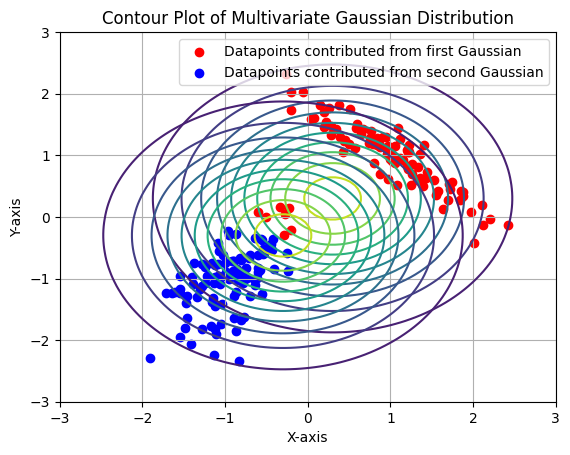

Iteration Number:1
Current Likelihood: -462.59033730289957


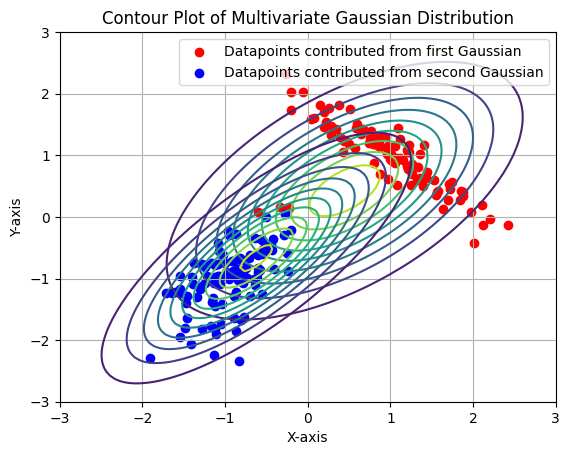

Iteration Number:2
Current Likelihood: -459.33336671983915


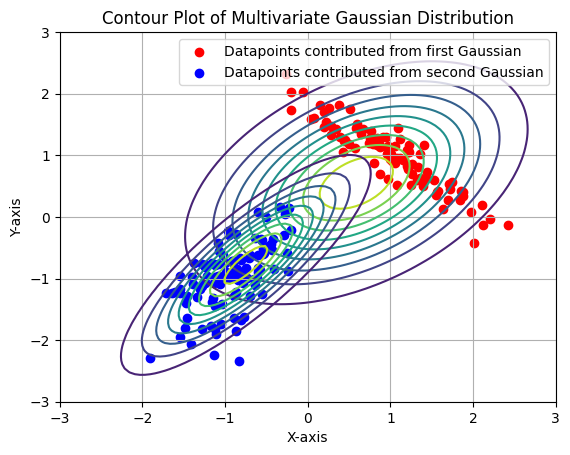

Iteration Number:3
Current Likelihood: -466.5007537589998


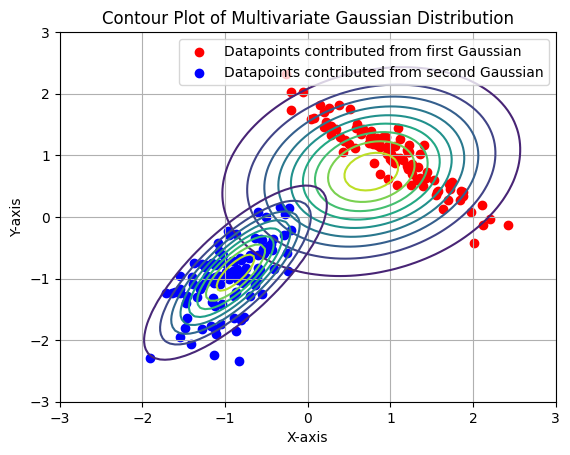

Iteration Number:4
Current Likelihood: -458.81547534149


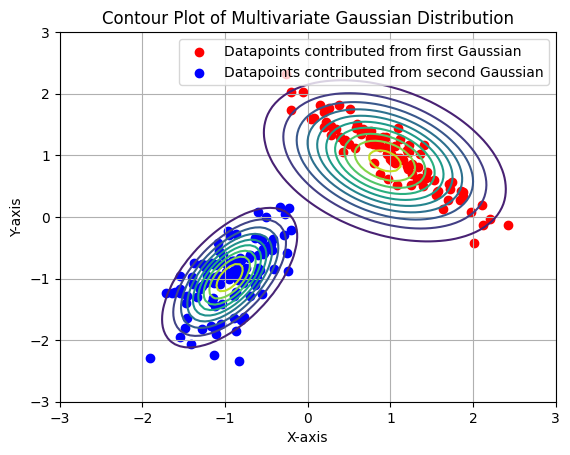

Iteration Number:5
Current Likelihood: -396.19378899617584


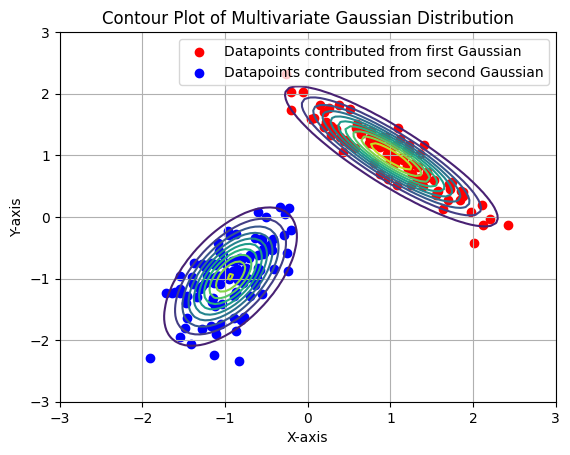

Iteration Number:6
Current Likelihood: -392.007552268767


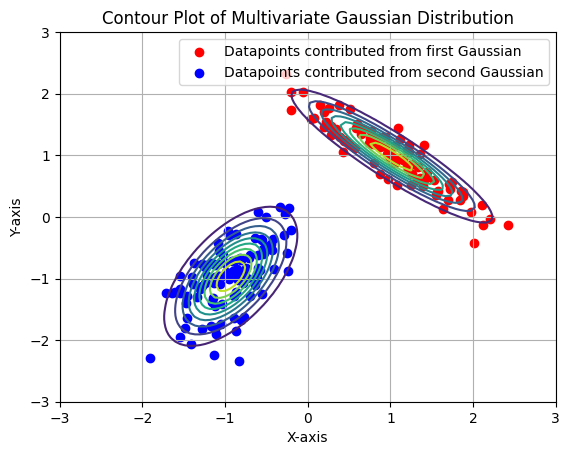

Iteration Number:7
Current Likelihood: -391.9987943294019


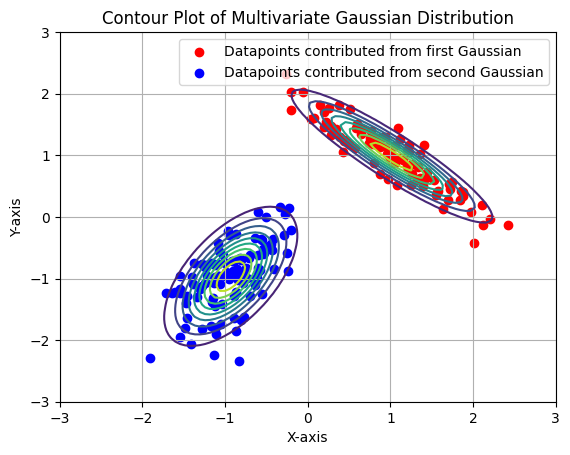

Iteration Number:8
Current Likelihood: -391.9987560304917


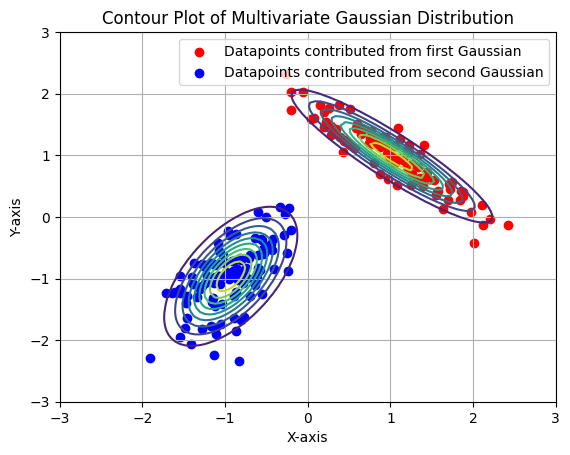

Iteration Number:9
Current Likelihood: -391.9987558647151


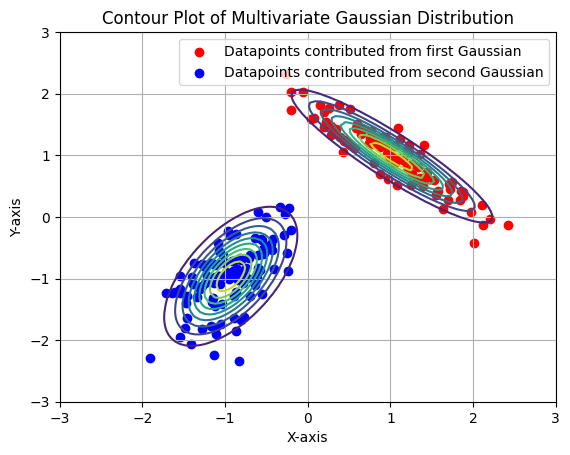

Iteration Number:10
Current Likelihood: -391.99875586399776


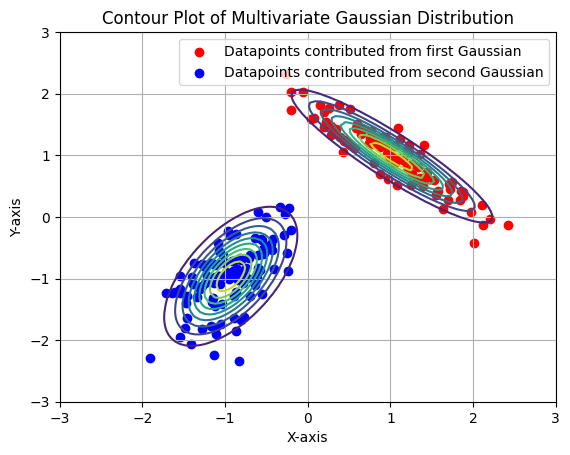

Iteration Number:11
Current Likelihood: -391.99875586399463


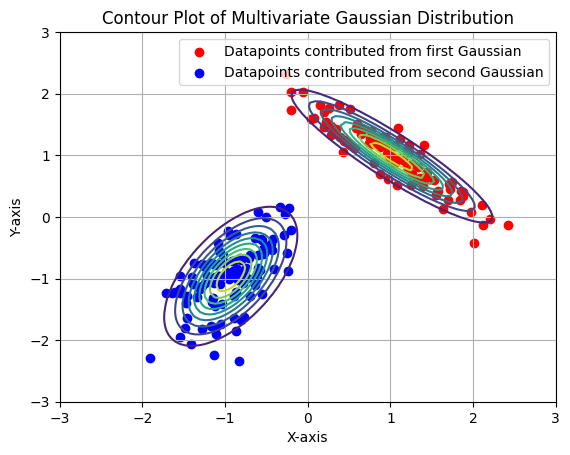

Iteration Number:12
Current Likelihood: -391.9987558639946


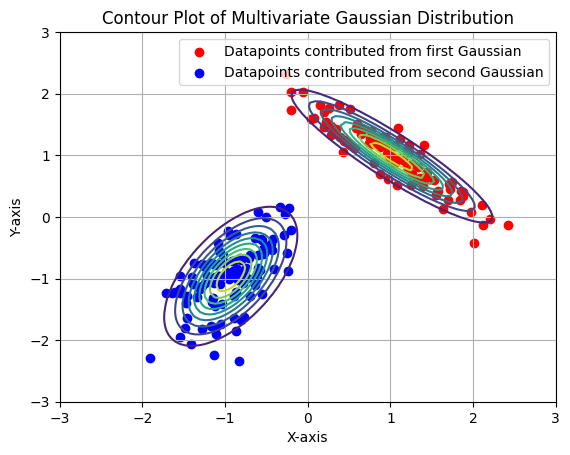

Iteration Number:13
Current Likelihood: -391.9987558639946


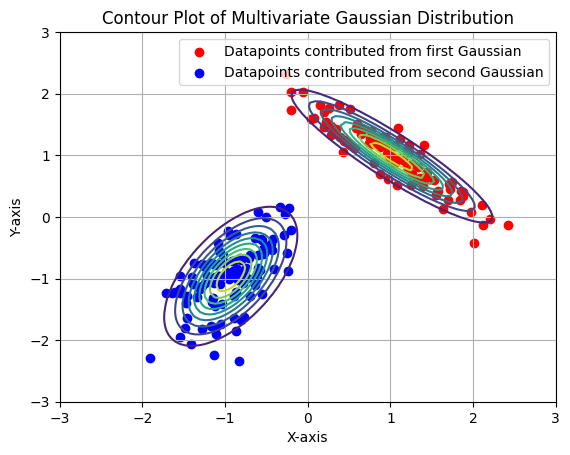

Iteration Number:14
Current Likelihood: -391.9987558639946


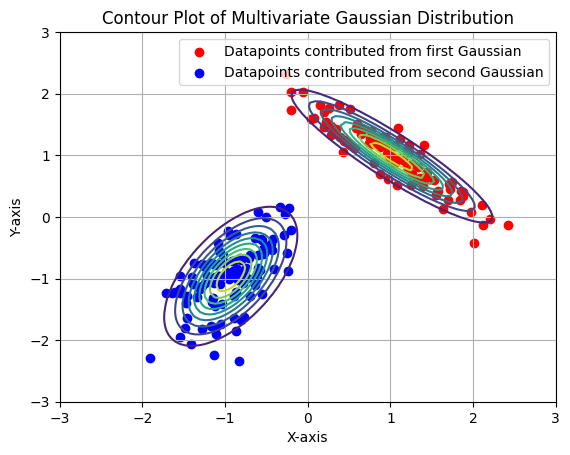

Iteration Number:15
Current Likelihood: -391.9987558639946


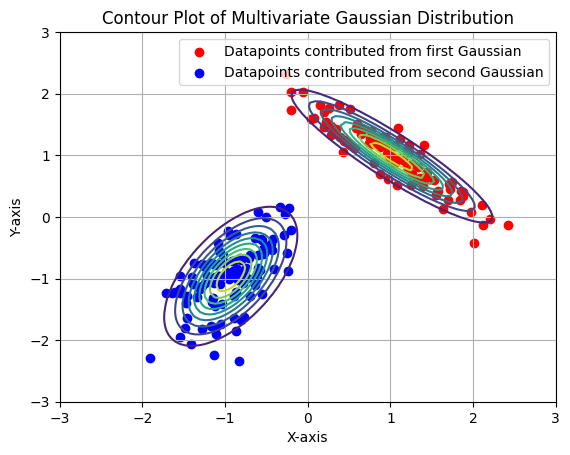

Iteration Number:16
Current Likelihood: -391.9987558639946


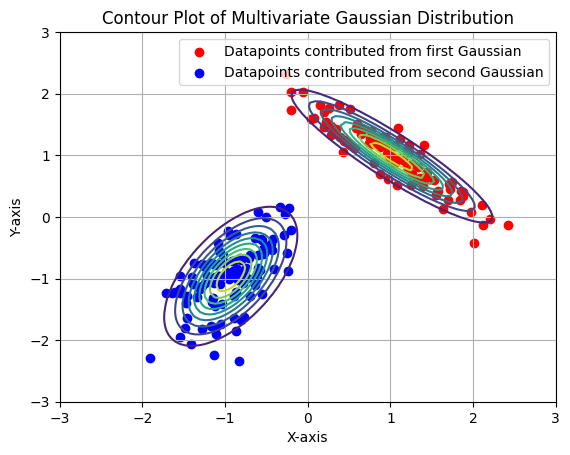

Iteration Number:17
Current Likelihood: -391.9987558639946


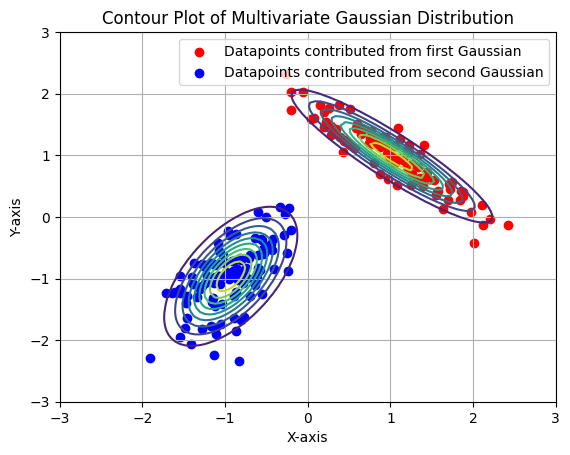

Iteration Number:18
Current Likelihood: -391.9987558639946


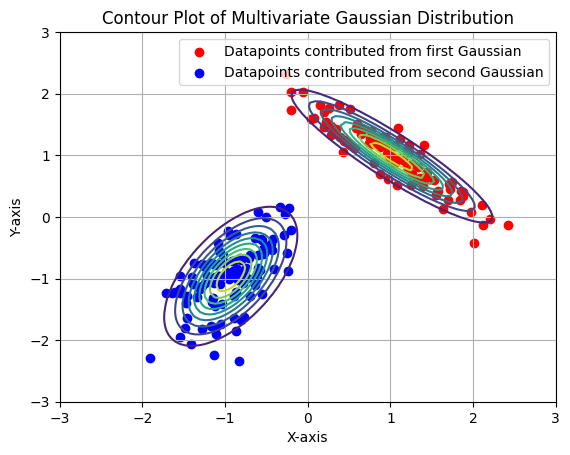

Iteration Number:19
Current Likelihood: -391.9987558639946


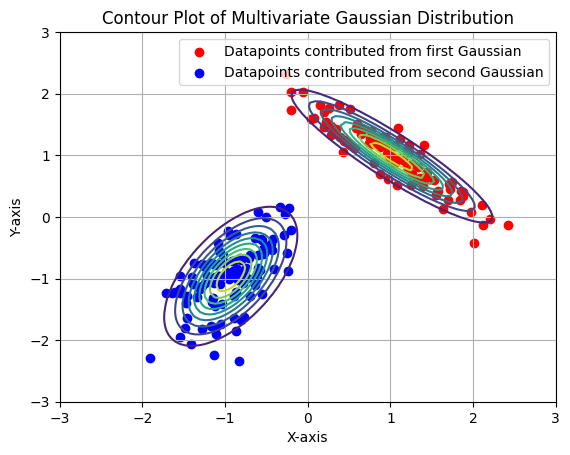

Iteration Number:20
Current Likelihood: -391.9987558639946


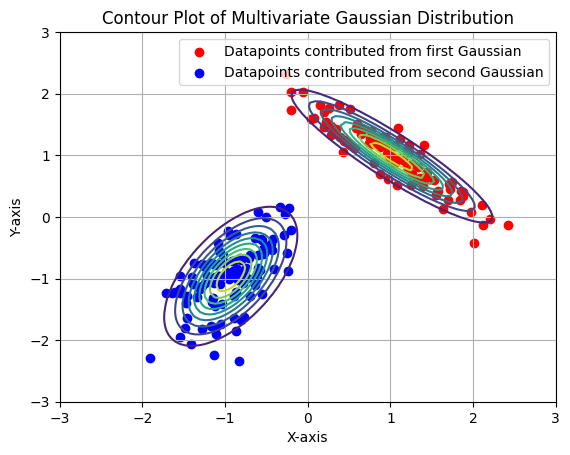

Iteration Number:21
Current Likelihood: -391.9987558639946


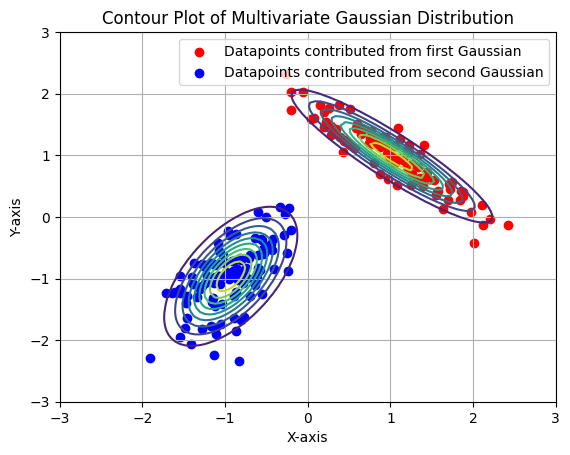

Iteration Number:22
Current Likelihood: -391.9987558639946


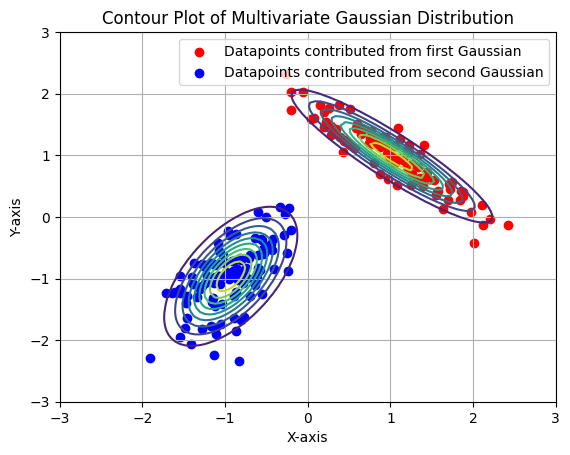

Iteration Number:23
Current Likelihood: -391.9987558639946


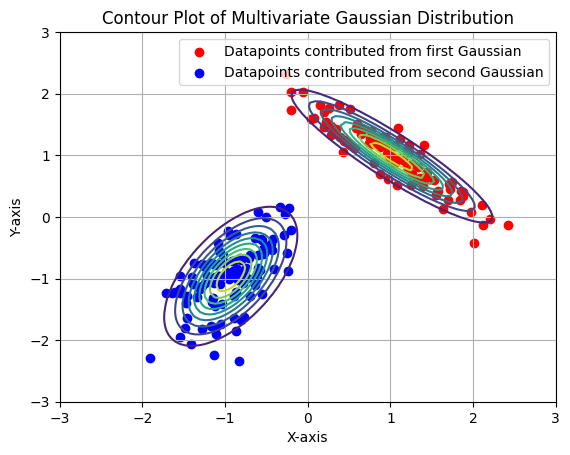

Iteration Number:24
Current Likelihood: -391.9987558639946


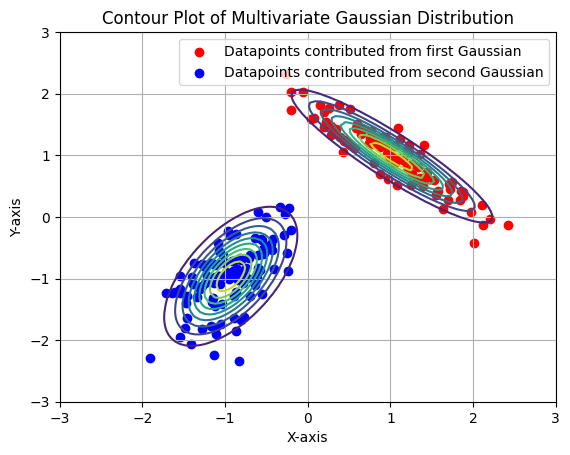

Iteration Number:25
Current Likelihood: -391.9987558639946


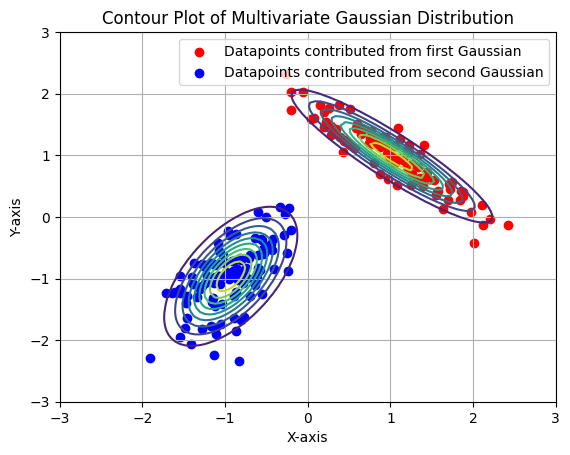

Iteration Number:26
Current Likelihood: -391.9987558639946


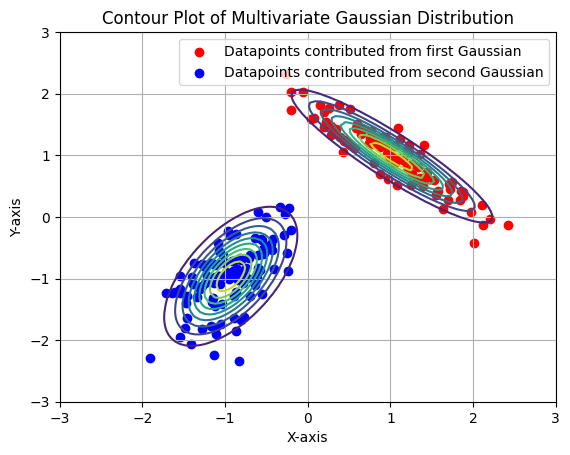

Iteration Number:27
Current Likelihood: -391.9987558639946


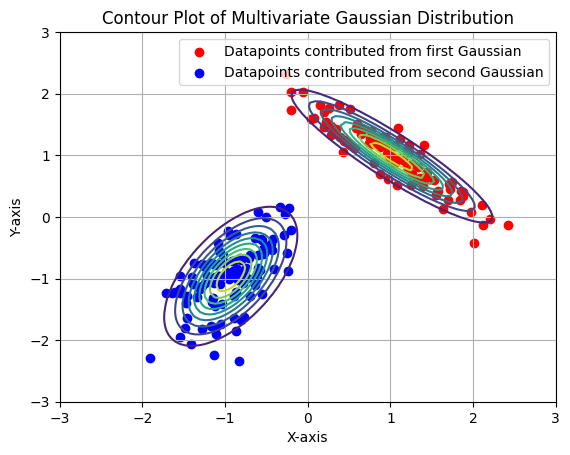

Iteration Number:28
Current Likelihood: -391.9987558639946


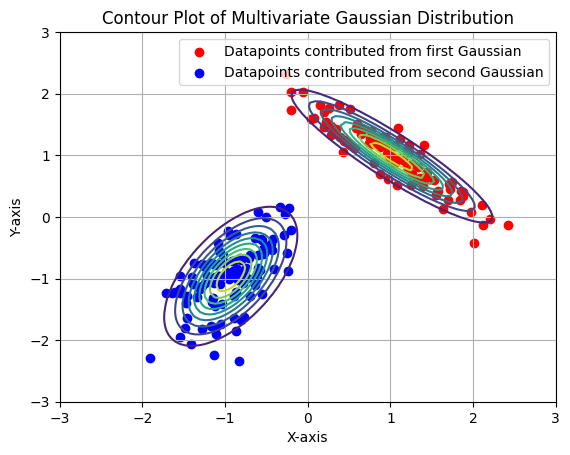

Iteration Number:29
Current Likelihood: -391.9987558639946


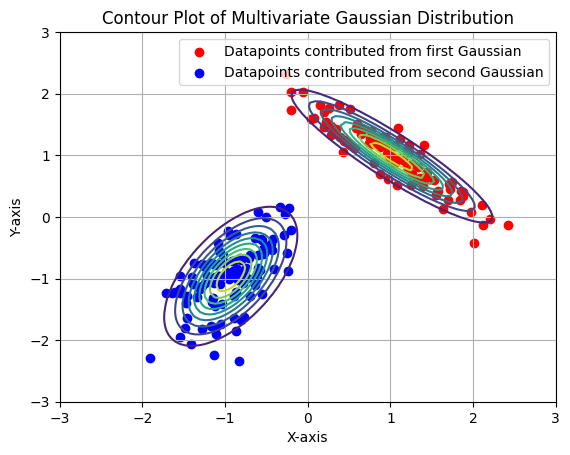

Iteration Number:30
Current Likelihood: -391.9987558639946


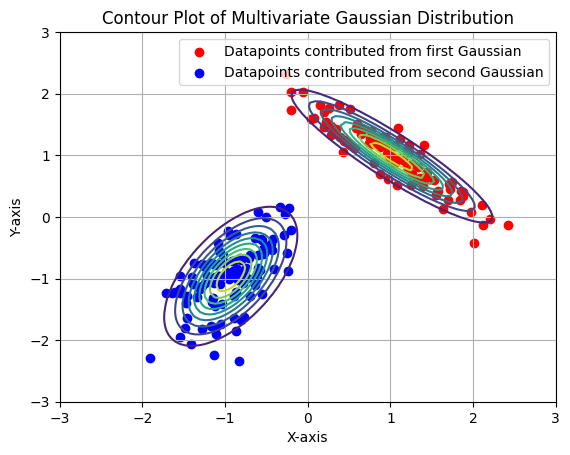

Iteration Number:31
Current Likelihood: -391.9987558639946


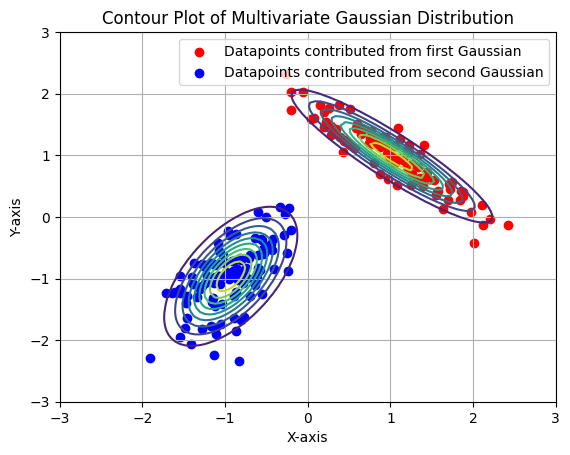

Iteration Number:32
Current Likelihood: -391.9987558639946


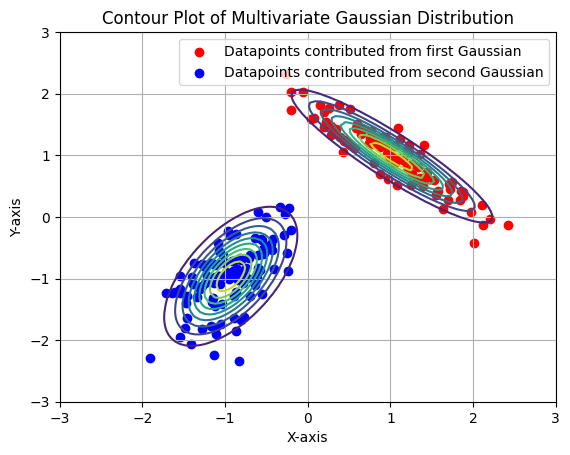

Iteration Number:33
Current Likelihood: -391.9987558639946


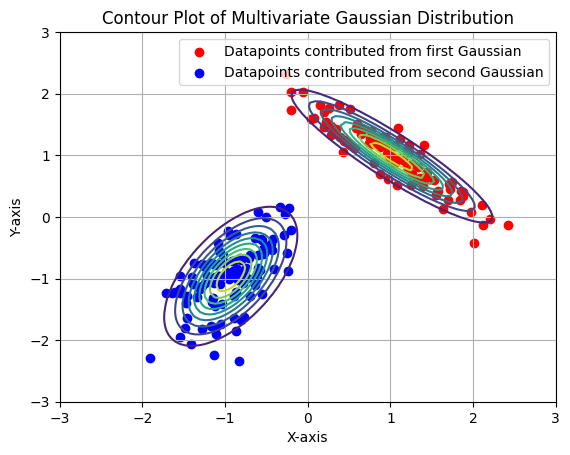

Iteration Number:34
Current Likelihood: -391.9987558639946


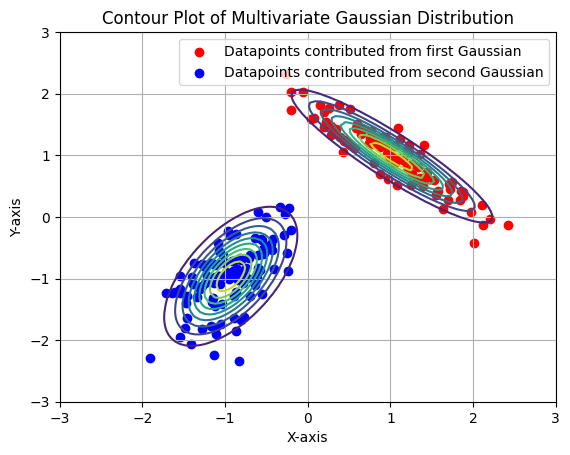

Iteration Number:35
Current Likelihood: -391.9987558639946


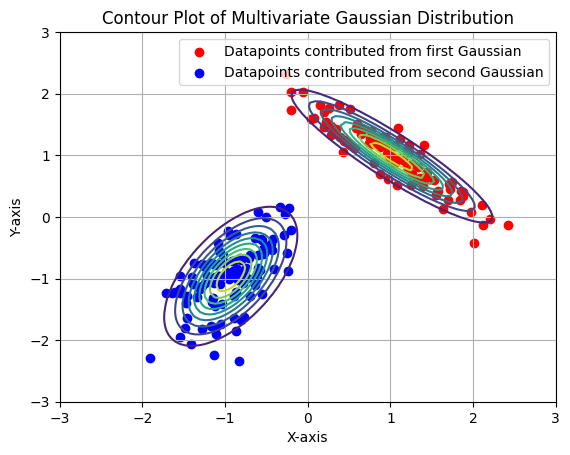

Iteration Number:36
Current Likelihood: -391.9987558639946


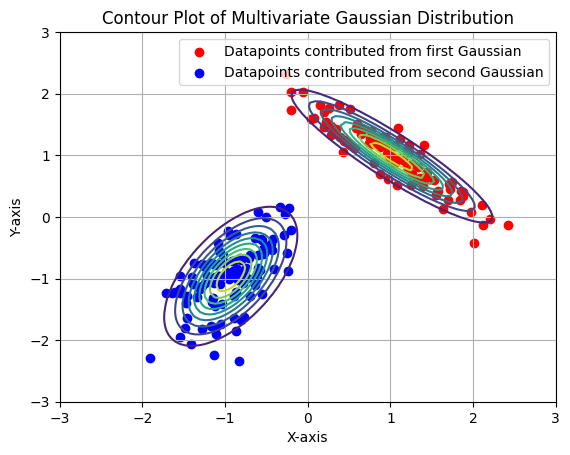

Iteration Number:37
Current Likelihood: -391.9987558639946


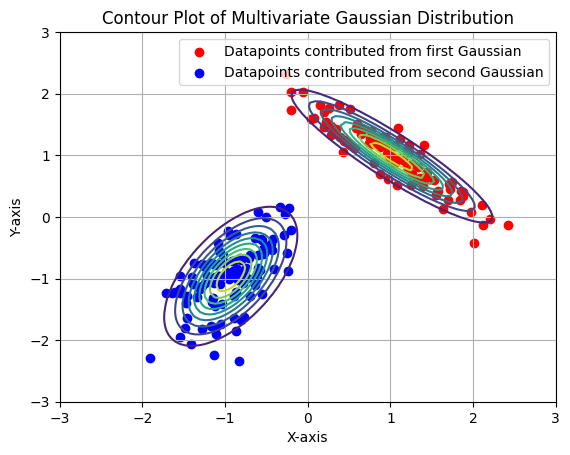

Iteration Number:38
Current Likelihood: -391.9987558639946


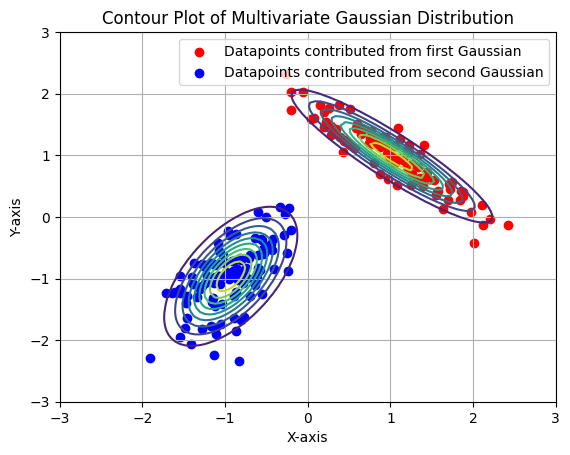

Iteration Number:39
Current Likelihood: -391.9987558639946


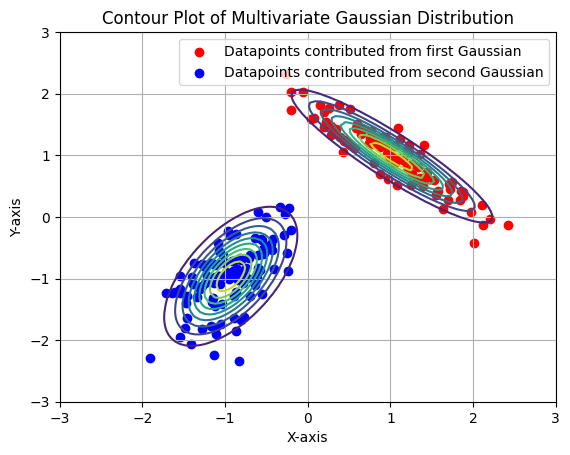

Iteration Number:40
Current Likelihood: -391.9987558639946


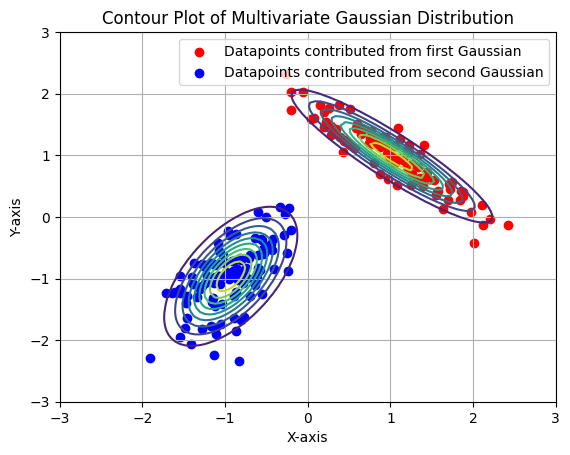

Iteration Number:41
Current Likelihood: -391.9987558639946


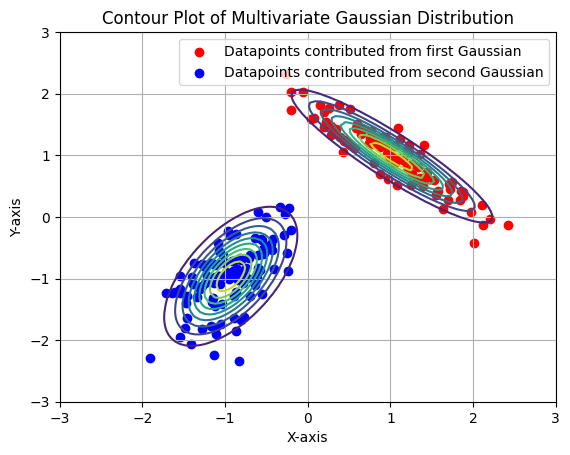

Iteration Number:42
Current Likelihood: -391.9987558639946


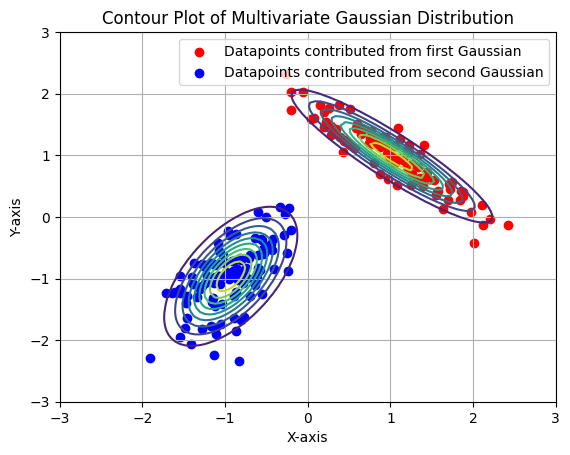

Iteration Number:43
Current Likelihood: -391.9987558639946


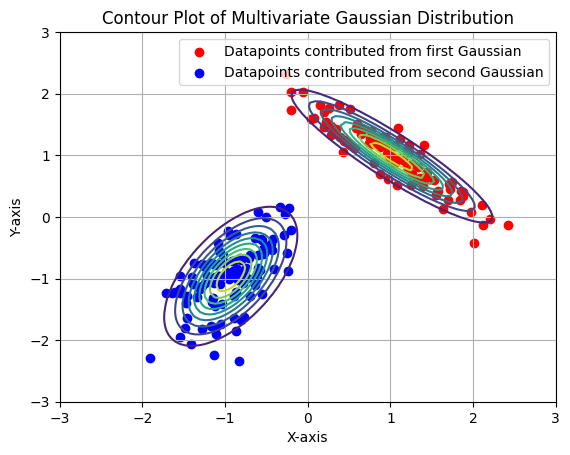

Iteration Number:44
Current Likelihood: -391.9987558639946


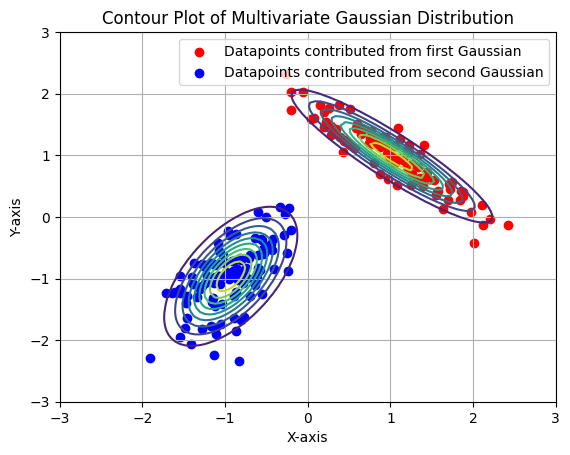

Iteration Number:45
Current Likelihood: -391.9987558639946


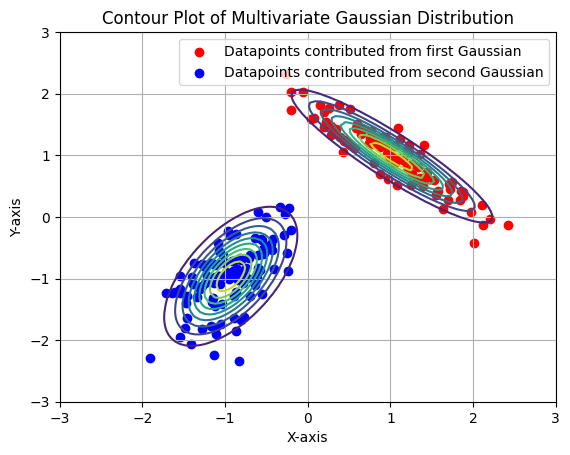

Iteration Number:46
Current Likelihood: -391.9987558639946


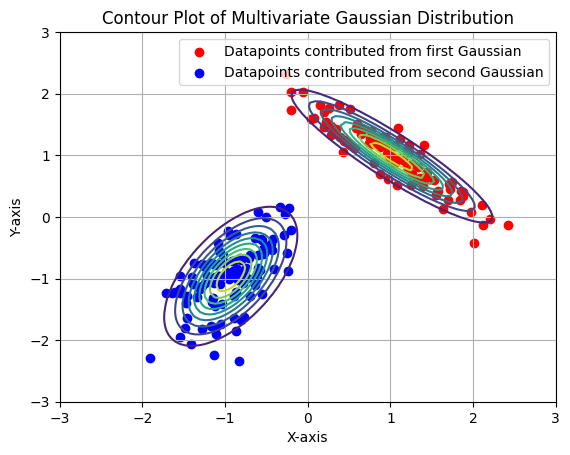

Iteration Number:47
Current Likelihood: -391.9987558639946


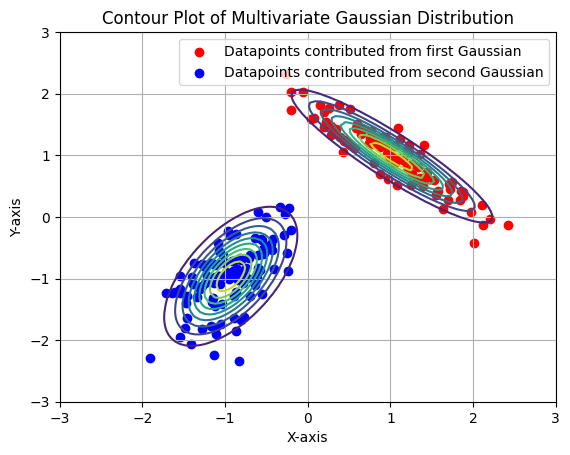

Iteration Number:48
Current Likelihood: -391.9987558639946


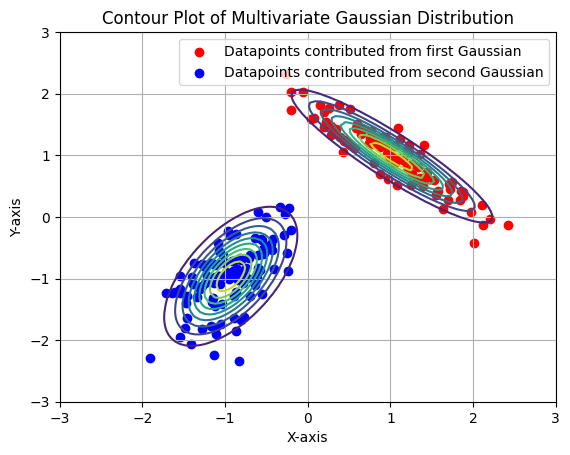

Iteration Number:49
Current Likelihood: -391.9987558639946


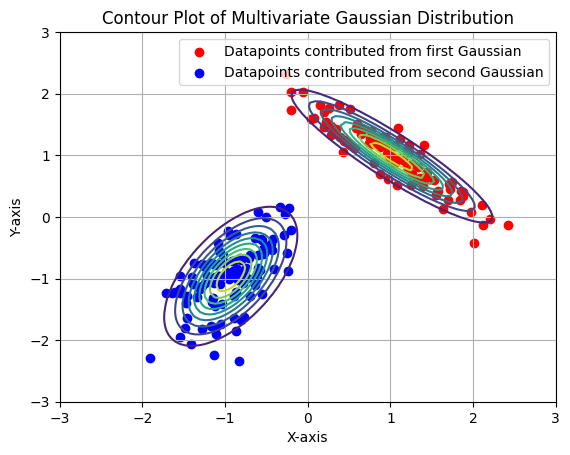

In [ ]:
#All imports
import numpy as np
import pandas as pd
import random as rand
import matplotlib.pyplot as plt
from scipy.stats import norm, multivariate_normal
import sys
import math

##########################################
#Part-6)-b: Implimentation of Expectation-Maximization (EM) algorithm
##########################################

def multivariate_gaussian(input, mean, cov_inv):
    # Initialize an empty array to store the results

    output = np.empty(input.shape[0])
    mean = np.reshape(mean, (2, 1))

    # Loop through each row of the input matrix
    for i in range(input.shape[0]):
        # Compute the multivariate Gaussian value for each row
        inp_i = np.reshape(input[i], (input[i].shape[0], 1))

        output[i] = ((np.linalg.norm(cov_inv))**(0.5) * np.exp(-0.5*np.dot((inp_i-mean).T, np.dot(cov_inv, inp_i-mean))) / (2*np.pi)**(input.shape[1]/2))[0, 0]

    output = np.reshape(output, (output.shape[0], 1))
    return output

def multivariate_gaussian_pdf(x, mu, sigma):

    n = len(mu)
    det_sigma = np.linalg.det(sigma)
    inv_sigma = np.linalg.inv(sigma)
    x = np.reshape(x, (2, 1))
    mu = np.reshape(mu, (2, 1))

    constant = 1 / ((2 * np.pi) ** (n / 2) * np.sqrt(det_sigma))
    exponent = -0.5 * np.dot(np.dot((x - mu).T, inv_sigma), (x - mu))

    return constant * np.exp(exponent)


############################################################################
#Write a function to compute the log-likelihood of the data given the parameters
############################################################################
def likelihood(data, pi, mu, sigma, log_likelihood=False, likelihoods=False):
  #Inputs: data, parameters of GMM model
  #Outputs: likelihood

  type1_likelihood = multivariate_gaussian(data, mu[0], np.linalg.inv(sigma[0]))
  type2_likelihood = multivariate_gaussian(data, mu[1], np.linalg.inv(sigma[1]))

  likelihoods_matrix = np.hstack((type1_likelihood, type2_likelihood))

  pi = np.reshape(pi, (pi.shape[0], 1))

  likelihoods = np.dot(likelihoods_matrix, pi)
  log_likelihoods = np.log(likelihoods)

  sum_log_likelihoods = np.sum(log_likelihoods)

  return sum_log_likelihoods

############################################################################
#Write a function for the expectation step
############################################################################
def expectation(data, pi, mu, sigma):
  #Inputs: data, parameters of GMM model
  #Outputs: gamma

  gamma = np.ones((len(data), len(pi)))
  for n in range(len(data)):
    #Iterate through the data points
    denominator = 0
    for k in range(len(pi)):
      #Iterate through the components in GMM
      cov_inv = np.linalg.inv(sigma[k])
      numerator = (pi[k] * multivariate_gaussian(np.reshape(data[n, :], (1, 2)), mu[k], cov_inv))[0, 0]
      denominator += numerator
      gamma[n,k] = numerator
    for k in range(len(pi)):
      gamma[n,k] /= denominator

  return gamma


############################################################################
#Write a function for the maximization step.
############################################################################
def maximization(data, gamma):
  #Inputs: data, gamma
  #Outputs: Updated parameters of GMM model

  N_values = np.sum(gamma, axis = 0)
  N = np.sum(N_values)

  #Update mu
  mu = np.dot(data.T, gamma)
  mu = np.divide(mu, N_values)
  mu = mu.T

  #Update sigma
  sigma = []
  for k in range(gamma.shape[1]):
      mu_k = np.reshape(mu[k], (2, 1))
      delta = data.T - mu_k
      gamma_mat = np.diag(gamma[:, k])
      sigma_k = np.dot(delta, np.dot(gamma_mat, delta.T))/N_values[k]
      sigma.append(sigma_k)
  sigma = np.asarray(sigma)


  #Update pi
  pi = N_values/N

  #Return the parameters of GMM model
  return pi, mu, sigma


#Complete the below function. It plots the contours
def plot_contours(data, labels, pi, mu, sigma, gamma):
  class_1 = np.empty((0, data.shape[1]))
  class_2 = np.empty((0, data.shape[1]))

  for i in range(data.shape[0]):
      if gamma[i, 0] > gamma[i, 1]:
          class_1 = np.vstack((class_1, data[i]))
      else:
          class_2 = np.vstack((class_2, data[i]))

  plt.scatter(class_1[:, 0], class_1[:, 1], color='red', label='Datapoints contributed from first Gaussian')
  plt.scatter(class_2[:, 0], class_2[:, 1], color='blue', label='Datapoints contributed from second Gaussian')

  # Generate data points over a grid
  x = np.linspace(-3, 3, 100)
  y = np.linspace(-3, 3, 100)
  X, Y = np.meshgrid(x, y)
  grid = np.stack([X.ravel(), Y.ravel()]).T

  for i in range(pi.shape[0]):
      # Define parameters for the multivariate Gaussian distribution
      mean = mu[i]
      cov = sigma[i]

      # Compute PDF values for each grid point
      pdf_values = np.array([multivariate_gaussian_pdf(point, mean, cov) for point in grid])
      pdf_values = pdf_values.reshape(X.shape)

      # Plot contour for the current component
      contour = plt.contour(X, Y, pdf_values, levels=10)

  plt.xlabel('X-axis')
  plt.ylabel('Y-axis')
  plt.title('Contour Plot of Multivariate Gaussian Distribution')
  plt.legend()
  plt.grid(True)
  plt.show()




############################################################################
#Run the expectation and maximzation algorithm to estimate the parameters
############################################################################
data = data_full    #data to run EM-algorithm
labels = labels_full  #labels
N = 200       #number of input examples
D = 2       #data dimension
M = 2       #no.of components in GMM

pi = np.array([0.6, 0.4])      #Initialize the prior probabilities
mu1_i = np.array([0.3, 0.3])
mu2_i = np.array([-0.3, -0.3])
sig1_i = np.array([[1, 0], [0, 1]])
sig2_i = np.array([[1, 0], [0, 1]])

# Demonstrating with the true values of mean, to avoid issues with convergence

mu = np.asarray([mu1_i, mu2_i])      #Initialize the mean vectors
sigma = np.asarray([sig1_i, sig2_i])   #Initialize the covariance matrices


nsteps = 50  #Number of steps to run EM algorithm
for index in range(0,nsteps,1):

  print("Iteration Number:" + str(index))

  #Compute the likelihood
  ll = likelihood(data, pi, mu, sigma, log_likelihood=True)
  print("Current Likelihood: " + str(ll))

  #Expectation step
  gamma = expectation(data, pi, mu, sigma)

  #Plot the contours
  plot_contours(data, labels, pi, mu, sigma, gamma)

  #Maximization step
  pi, mu, sigma = maximization(data, gamma)


In [ ]:
############################################################################
##Part-6)-d: Understand the issues with EM algorithm
############################################################################


# Issues with inappropriate initialization
# Initialization with random means

data = data_full    #data to run EM-algorithm
labels = labels_full  #labels
N = 200       #number of input examples
D = 2       #data dimension
M = 2       #no.of components in GMM

pi = np.array([0.6, 0.4])      #Initialize the prior probabilities
mu1_i = np.random.uniform(-3, 3, (2, 1))
mu2_i = np.random.uniform(-3, 3, (2, 1))
sig1_i = np.array([[1, 0], [0, 1]])
sig2_i = np.array([[1, 0], [0, 1]])

mu = np.asarray([mu1_i, mu2_i])      #Initialize the mean vectors
sigma = np.asarray([sig1_i, sig2_i])   #Initialize the covariance matrices


nsteps = 50  #Number of steps to run EM algorithm
for index in range(0,nsteps,1):

  print("Iteration Number:" + str(index))

  #Compute the likelihood
  ll = likelihood(data, pi, mu, sigma, log_likelihood=True)
  print("Current Likelihood: " + str(ll))

  #Expectation step
  gamma = expectation(data, pi, mu, sigma)

  #Plot the contours
  plot_contours(data, labels, pi, mu, sigma, gamma)

  #Maximization step
  pi, mu, sigma = maximization(data, gamma)








Iteration Number:0
Current Likelihood: -726.2943621129857


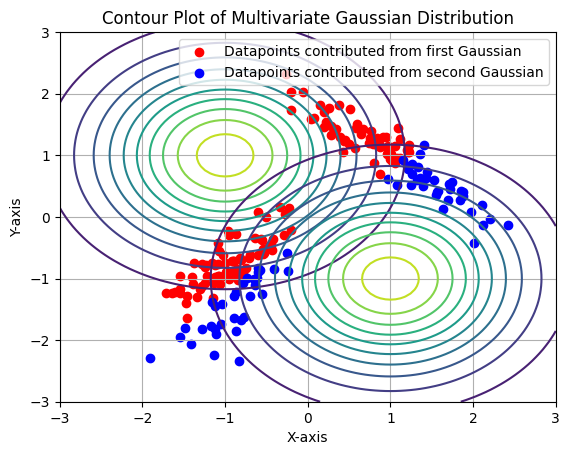

Iteration Number:1
Current Likelihood: -437.4732720667974


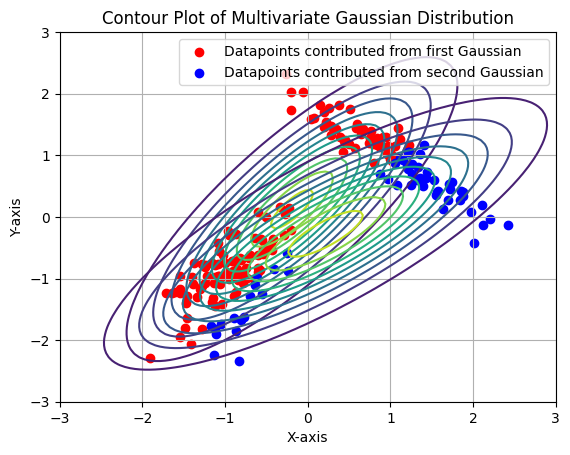

Iteration Number:2
Current Likelihood: -432.4096768073845


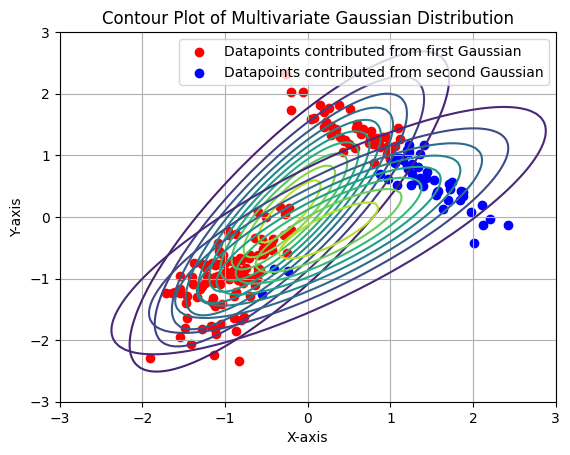

Iteration Number:3
Current Likelihood: -430.4285197568672


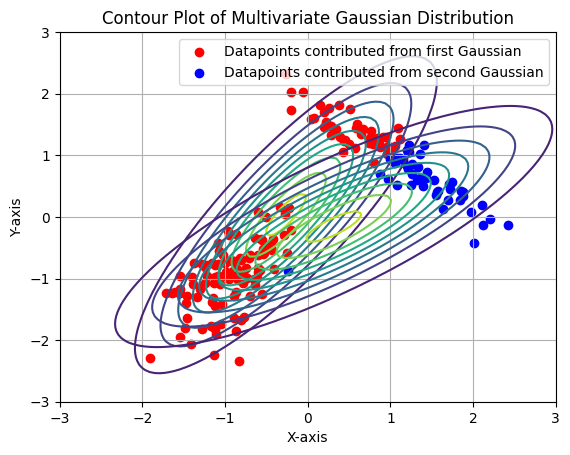

Iteration Number:4
Current Likelihood: -429.85430142016116


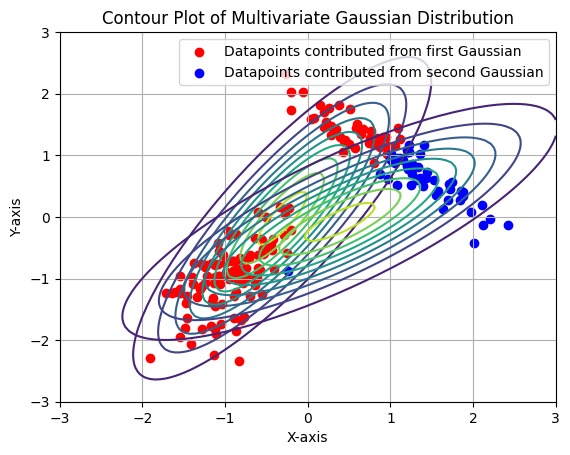

Iteration Number:5
Current Likelihood: -430.3074329087691


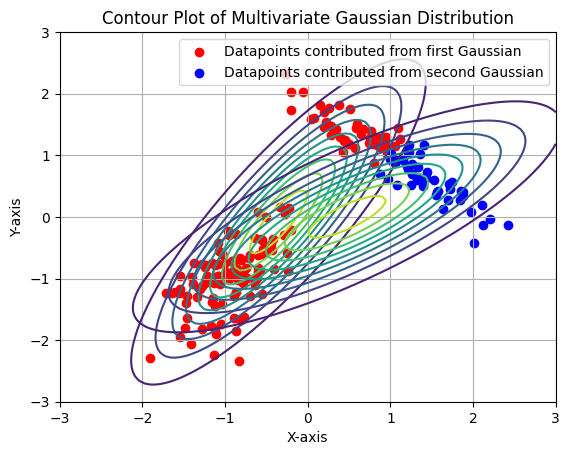

Iteration Number:6
Current Likelihood: -431.75790412010986


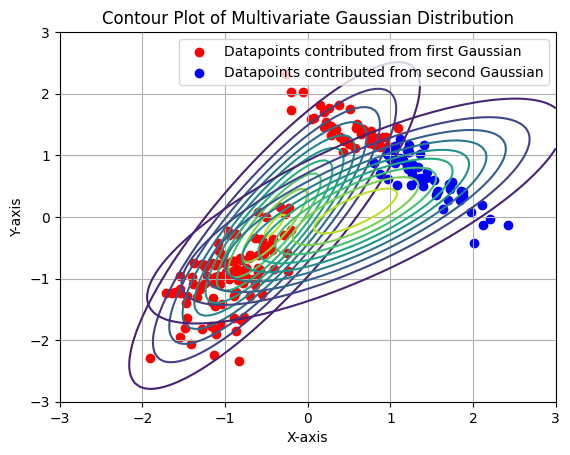

Iteration Number:7
Current Likelihood: -434.32719205096856


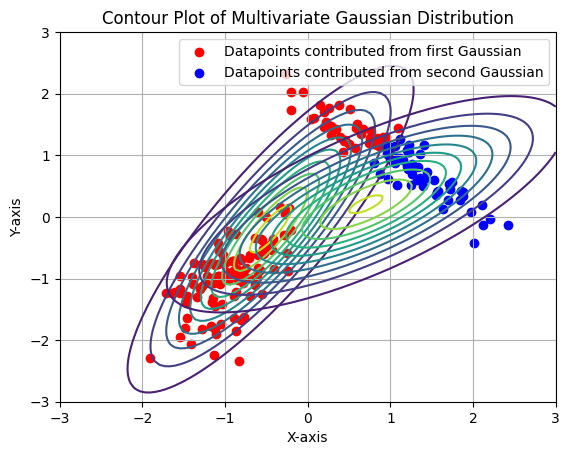

Iteration Number:8
Current Likelihood: -438.0265275575243


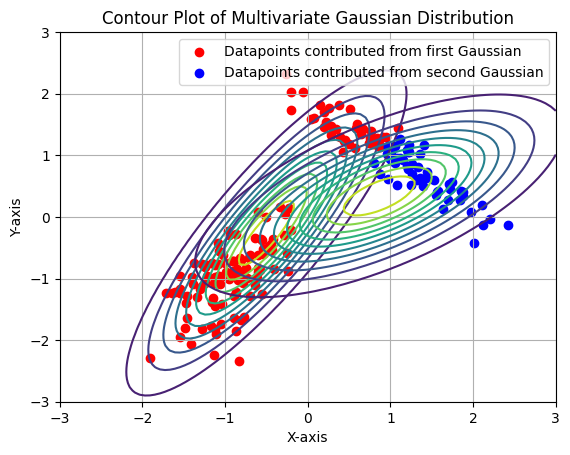

Iteration Number:9
Current Likelihood: -441.01828294026996


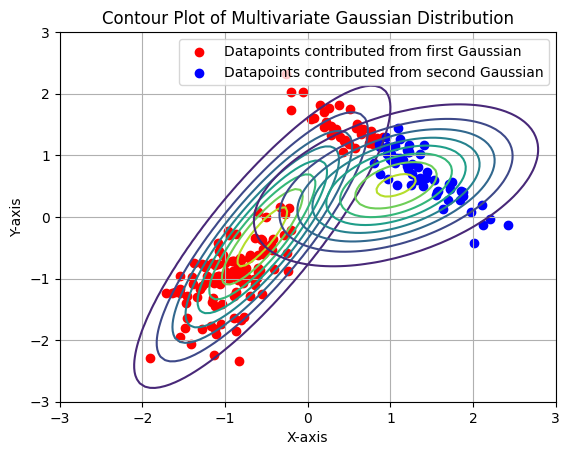

Iteration Number:10
Current Likelihood: -424.461286348675


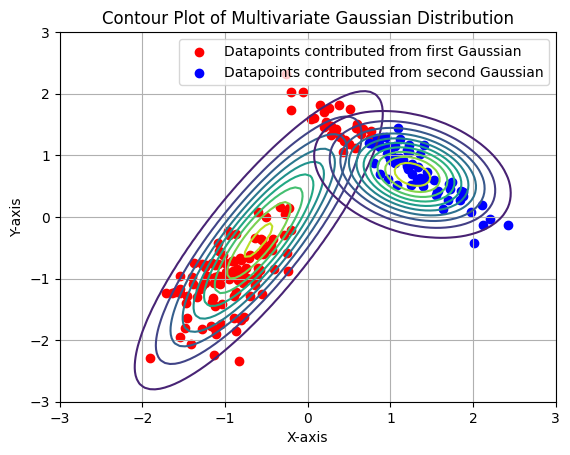

Iteration Number:11
Current Likelihood: -381.37153078852236


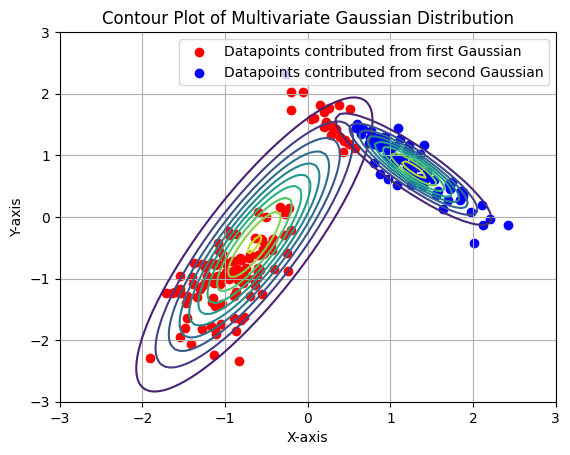

Iteration Number:12
Current Likelihood: -371.78234882472793


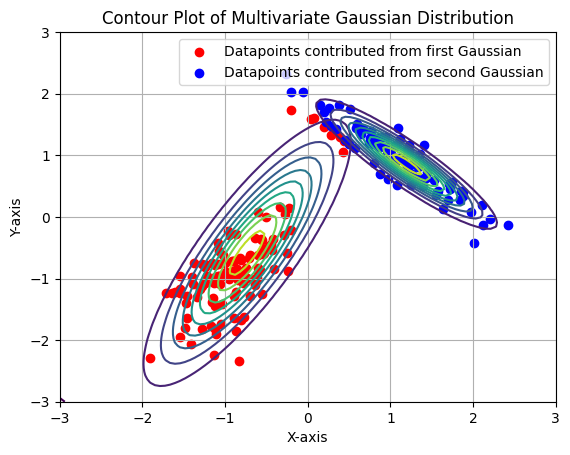

Iteration Number:13
Current Likelihood: -367.83281851740844


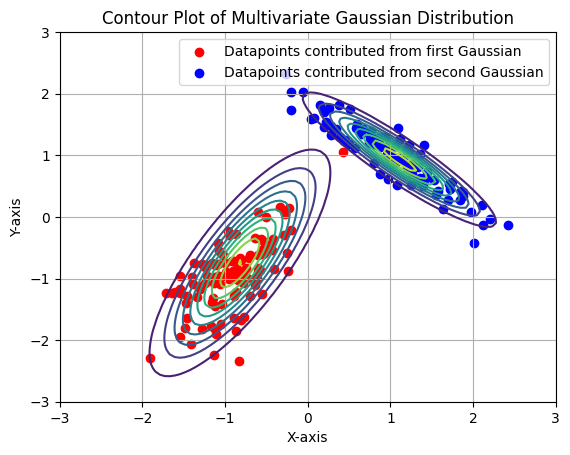

Iteration Number:14
Current Likelihood: -376.68906591301175


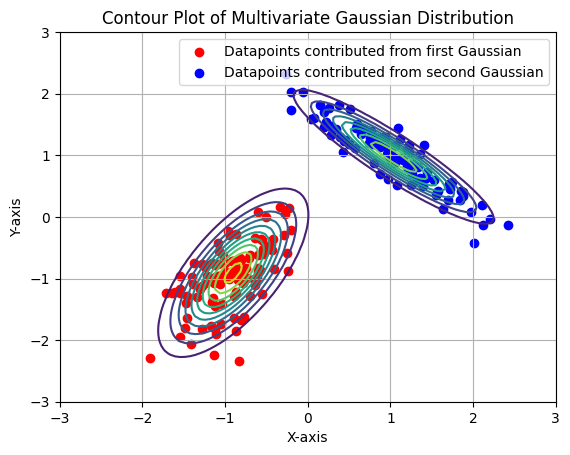

Iteration Number:15
Current Likelihood: -391.38994275851815


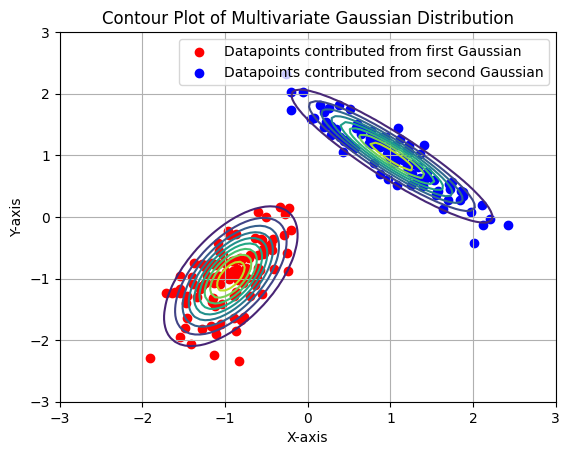

Iteration Number:16
Current Likelihood: -391.9959626829881


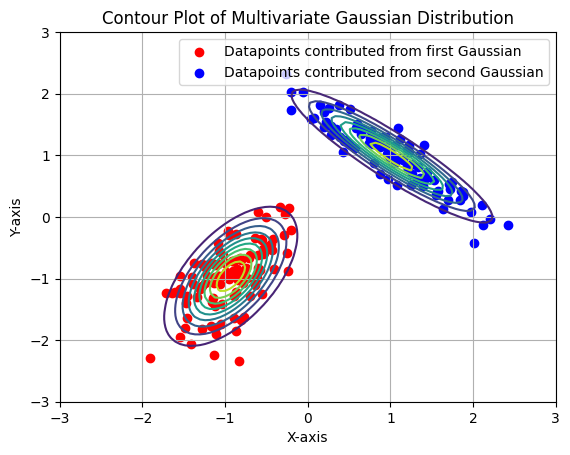

Iteration Number:17
Current Likelihood: -391.9987437790323


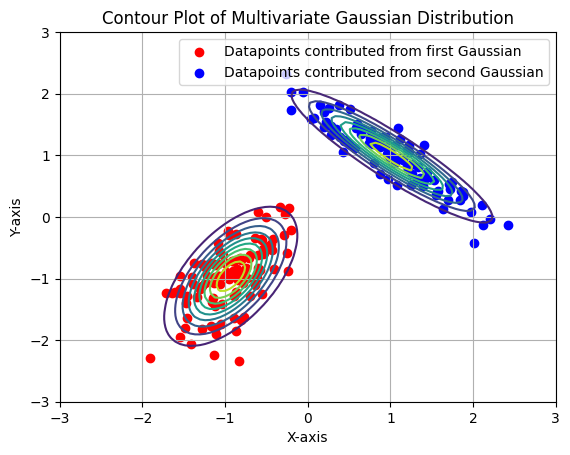

Iteration Number:18
Current Likelihood: -391.99875581170136


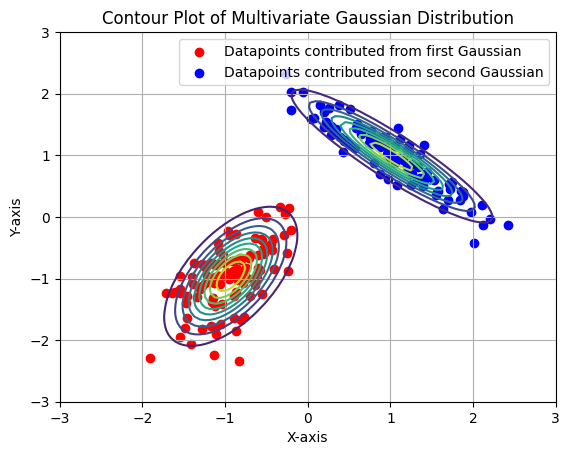

Iteration Number:19
Current Likelihood: -391.99875586376834


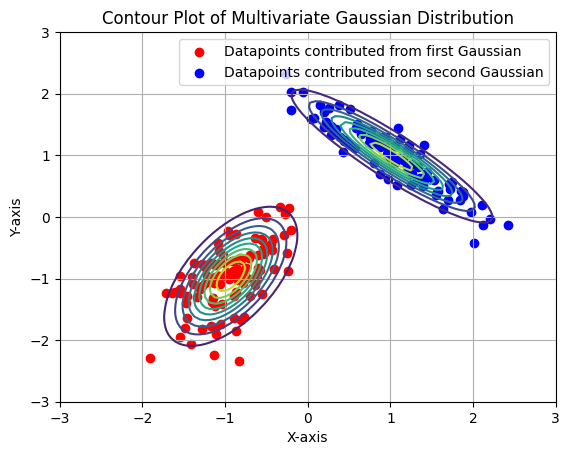

Iteration Number:20
Current Likelihood: -391.99875586399367


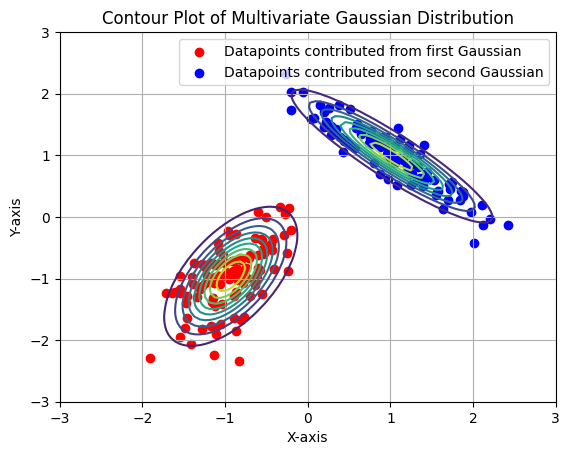

Iteration Number:21
Current Likelihood: -391.9987558639946


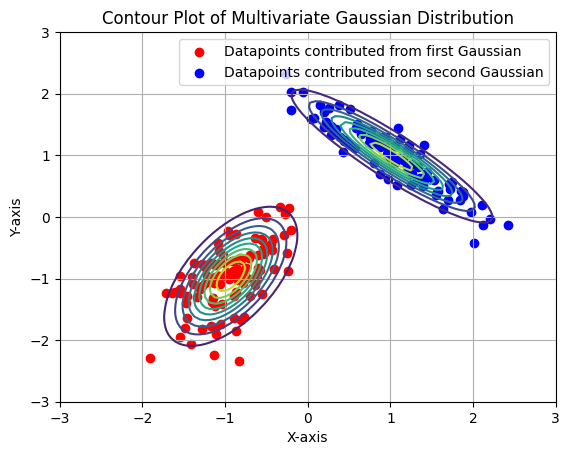

Iteration Number:22
Current Likelihood: -391.9987558639946


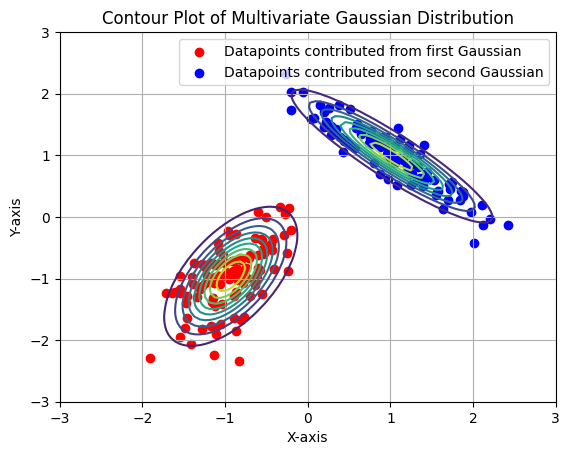

Iteration Number:23
Current Likelihood: -391.9987558639946


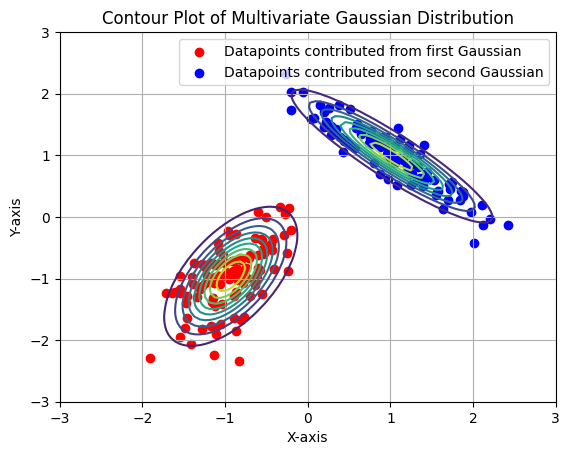

Iteration Number:24
Current Likelihood: -391.9987558639946


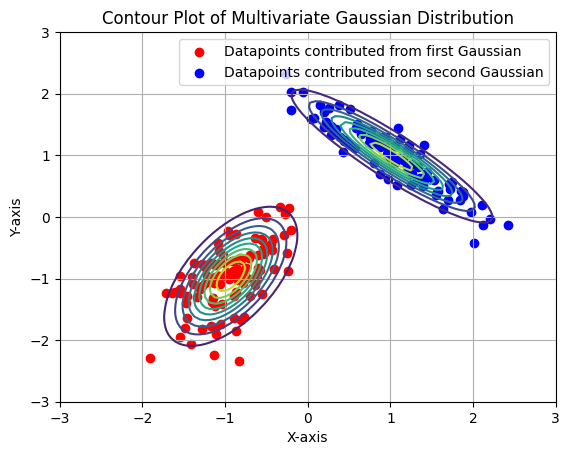

Iteration Number:25
Current Likelihood: -391.9987558639946


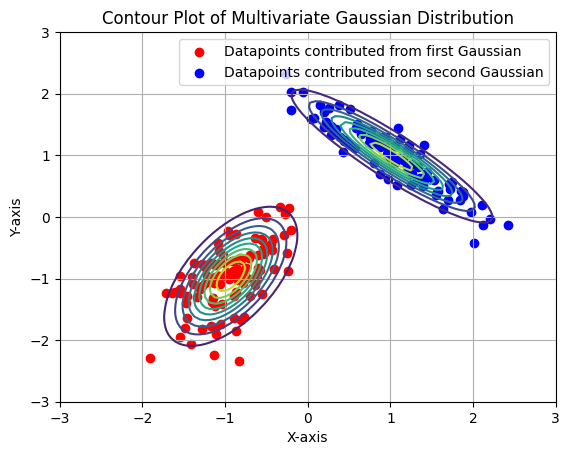

Iteration Number:26
Current Likelihood: -391.9987558639946


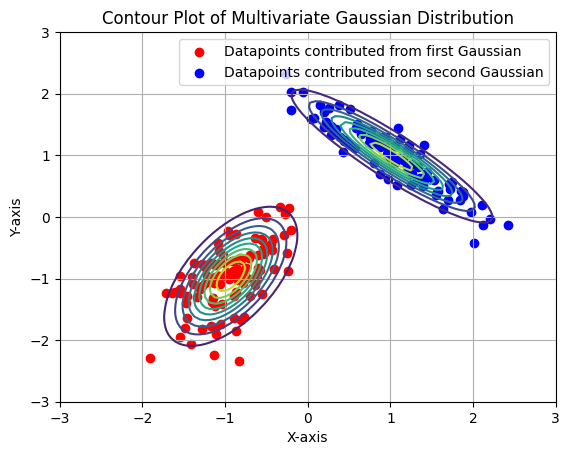

Iteration Number:27
Current Likelihood: -391.9987558639946


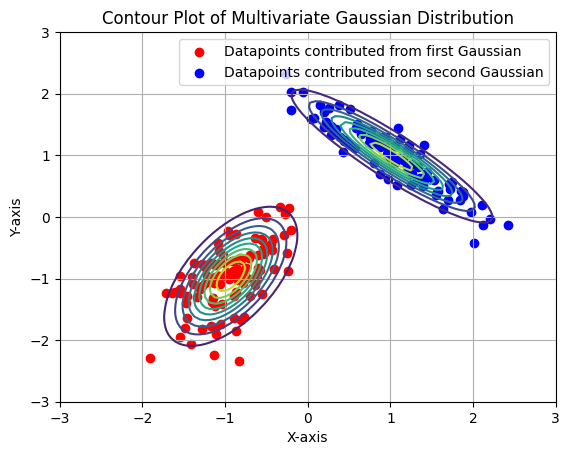

Iteration Number:28
Current Likelihood: -391.9987558639946


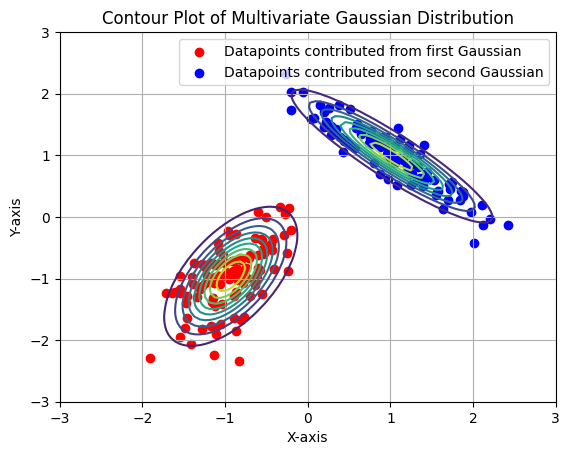

Iteration Number:29
Current Likelihood: -391.9987558639946


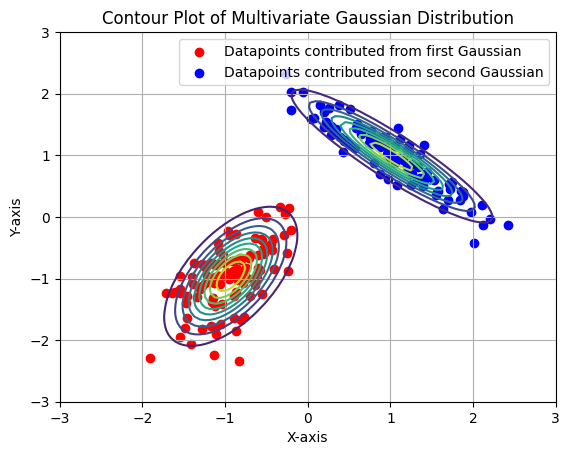

Iteration Number:30
Current Likelihood: -391.9987558639946


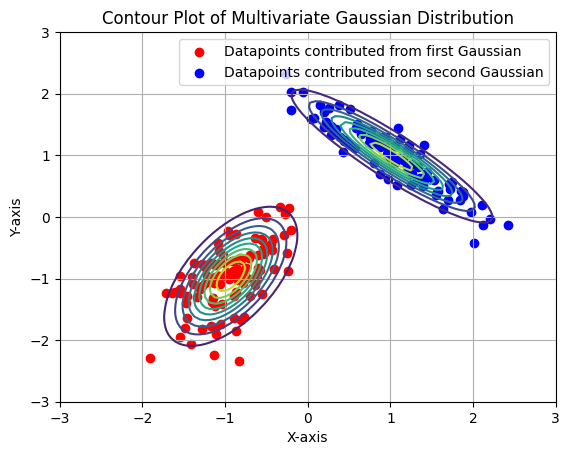

Iteration Number:31
Current Likelihood: -391.9987558639946


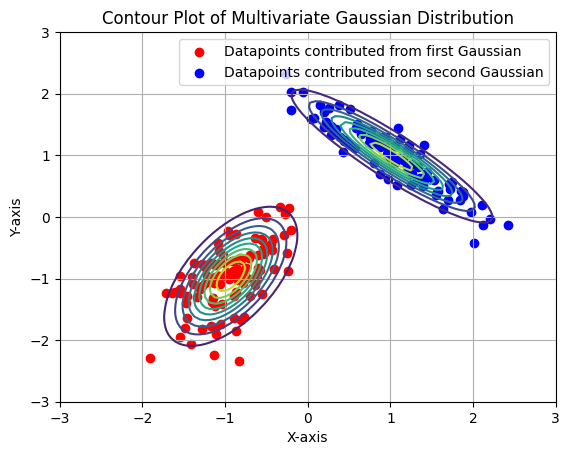

Iteration Number:32
Current Likelihood: -391.9987558639946


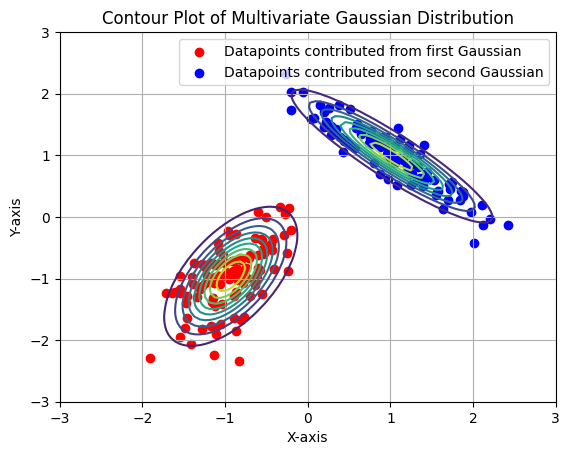

Iteration Number:33
Current Likelihood: -391.9987558639946


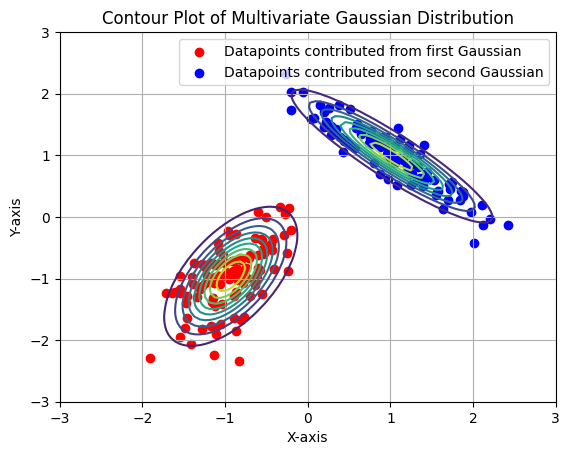

Iteration Number:34
Current Likelihood: -391.9987558639946


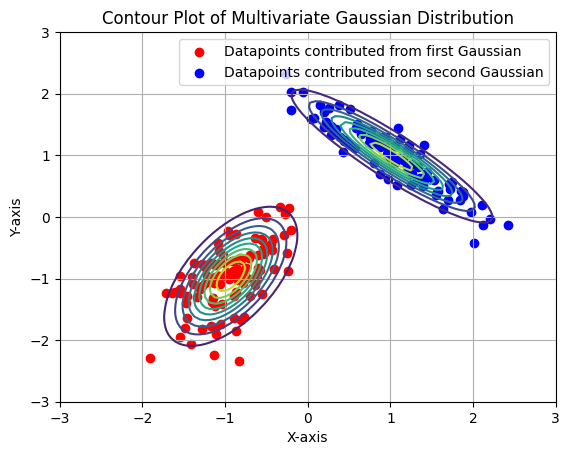

Iteration Number:35
Current Likelihood: -391.9987558639946


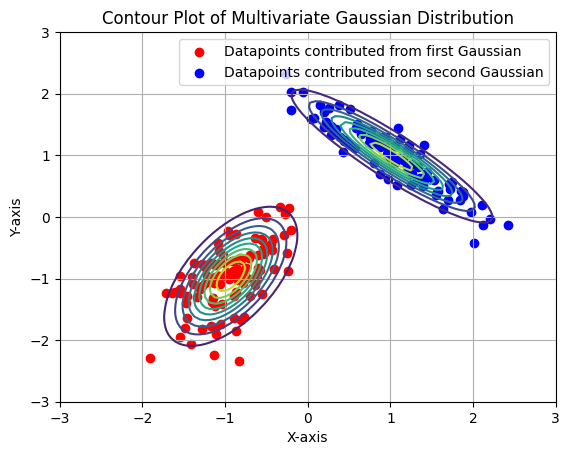

Iteration Number:36
Current Likelihood: -391.9987558639946


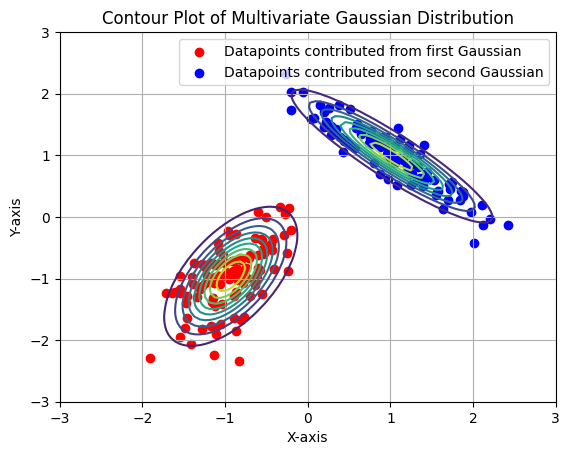

Iteration Number:37
Current Likelihood: -391.9987558639946


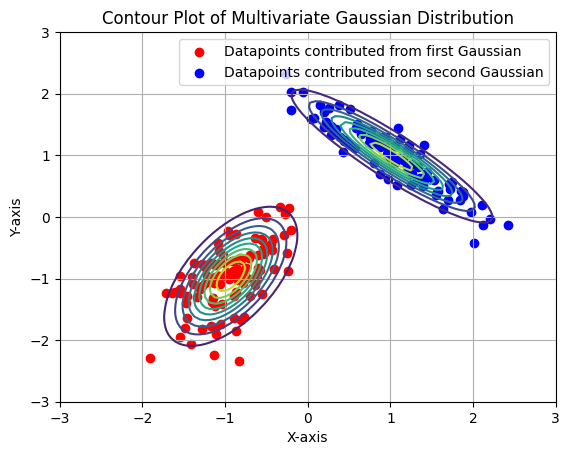

Iteration Number:38
Current Likelihood: -391.9987558639946


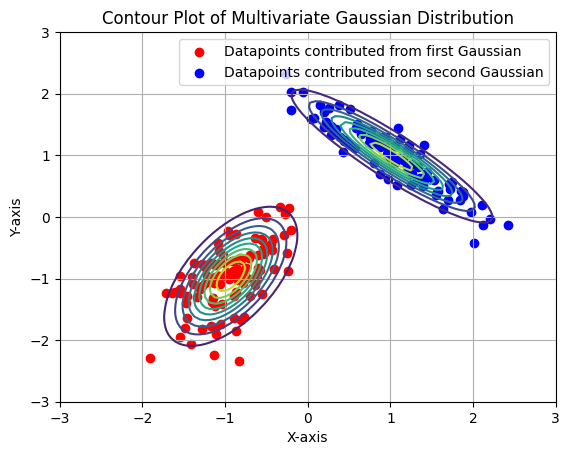

Iteration Number:39
Current Likelihood: -391.9987558639946


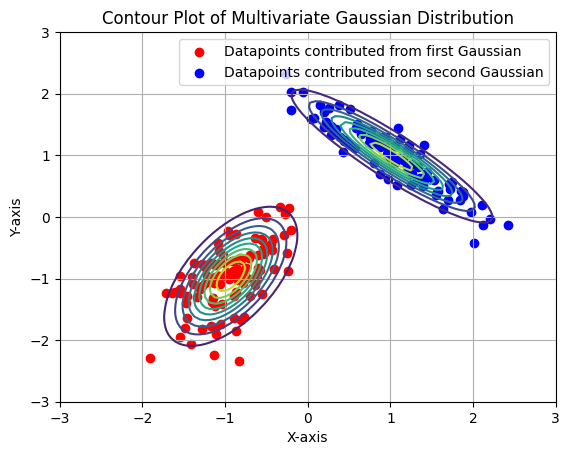

Iteration Number:40
Current Likelihood: -391.9987558639946


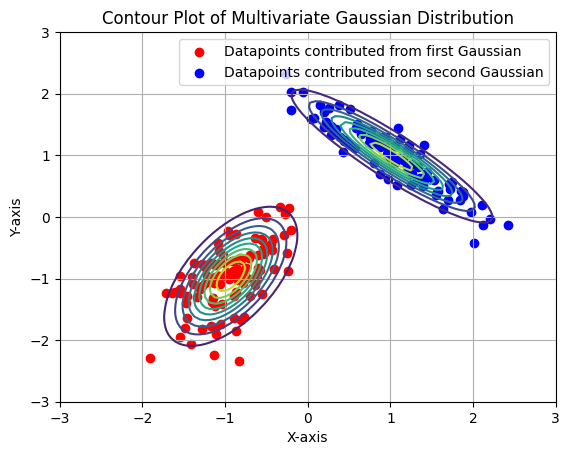

Iteration Number:41
Current Likelihood: -391.9987558639946


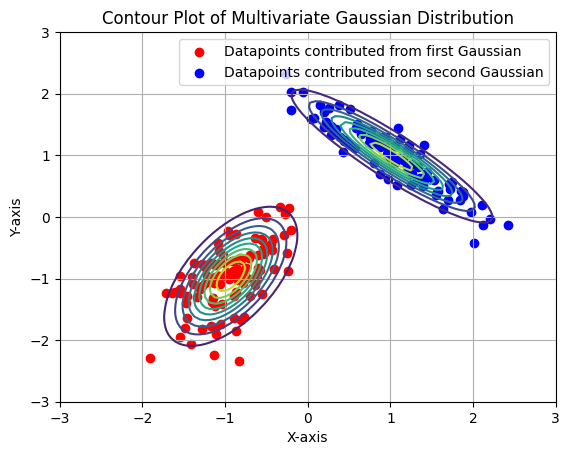

Iteration Number:42
Current Likelihood: -391.9987558639946


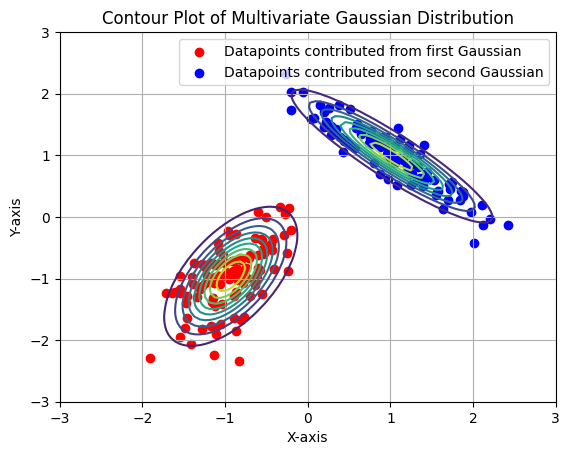

Iteration Number:43
Current Likelihood: -391.9987558639946


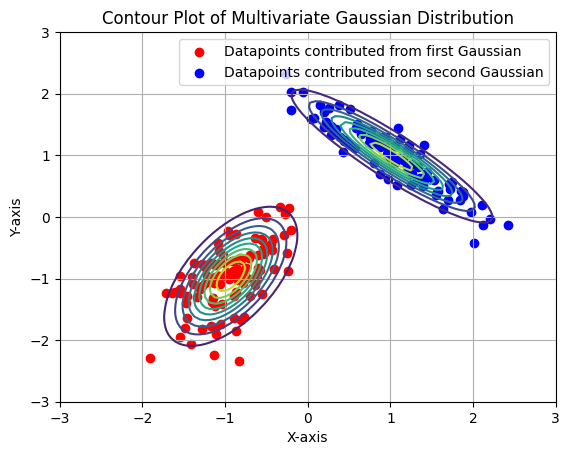

Iteration Number:44
Current Likelihood: -391.9987558639946


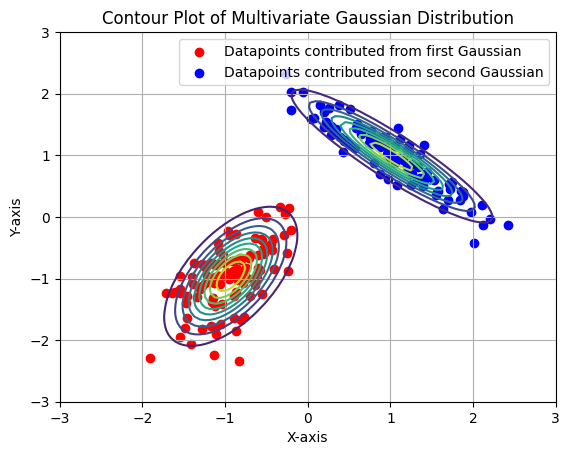

Iteration Number:45
Current Likelihood: -391.9987558639946


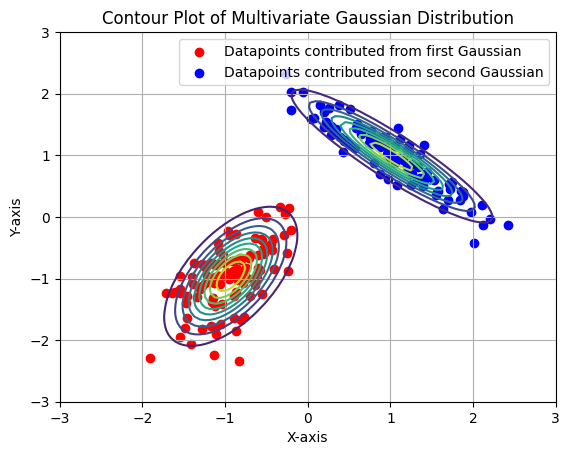

Iteration Number:46
Current Likelihood: -391.9987558639946


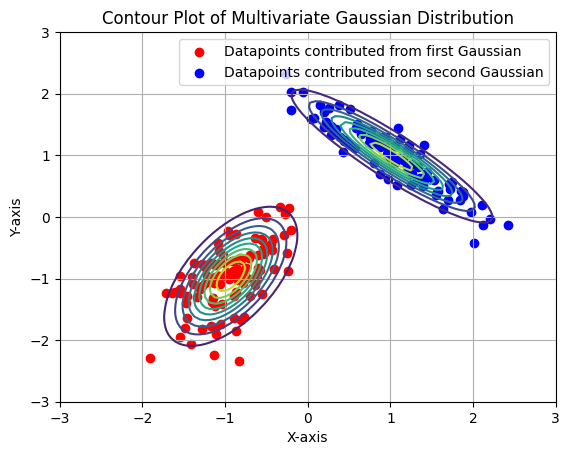

Iteration Number:47
Current Likelihood: -391.9987558639946


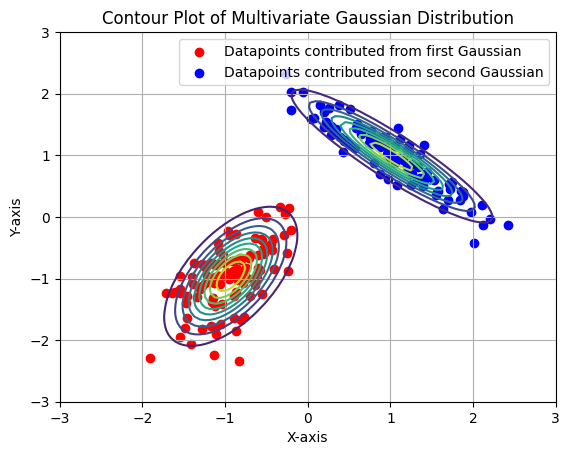

Iteration Number:48
Current Likelihood: -391.9987558639946


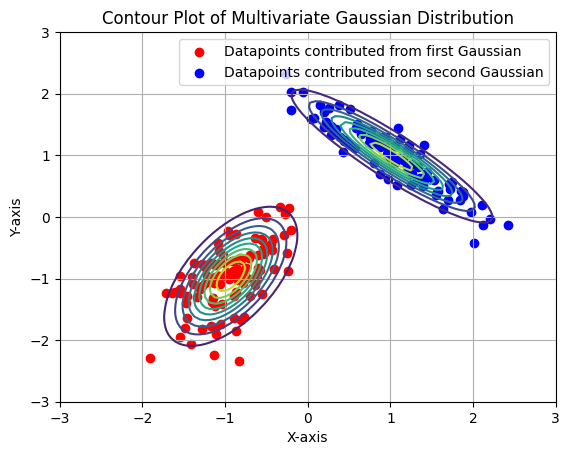

Iteration Number:49
Current Likelihood: -391.9987558639946


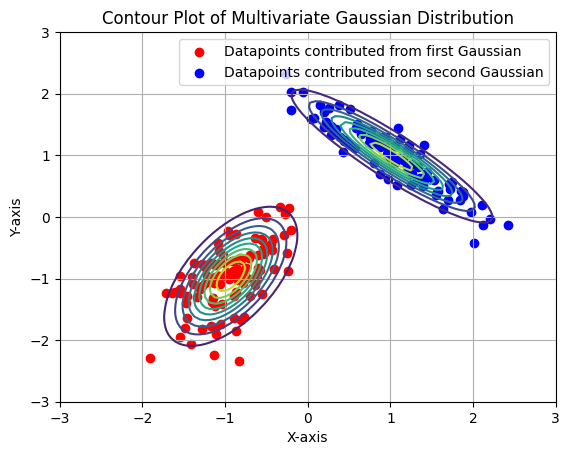

In [ ]:
############################################################################
##Part-6)-d: Understand the issues with EM algorithm
############################################################################


# Alternate initialization of the means


data = data_full    #data to run EM-algorithm
labels = labels_full  #labels
N = 200       #number of input examples
D = 2       #data dimension
M = 2       #no.of components in GMM

pi = np.array([0.6, 0.4])      #Initialize the prior probabilities
mu1_i = np.array([-1, 1])
mu2_i = np.array([1, -1])
sig1_i = np.array([[1, 0], [0, 1]])
sig2_i = np.array([[1, 0], [0, 1]])

mu = np.asarray([mu1_i, mu2_i])      #Initialize the mean vectors
sigma = np.asarray([sig1_i, sig2_i])   #Initialize the covariance matrices


nsteps = 50  #Number of steps to run EM algorithm
for index in range(0,nsteps,1):

  print("Iteration Number:" + str(index))

  #Compute the likelihood
  ll = likelihood(data, pi, mu, sigma, log_likelihood=True)
  print("Current Likelihood: " + str(ll))

  #Expectation step
  gamma = expectation(data, pi, mu, sigma)

  #Plot the contours
  plot_contours(data, labels, pi, mu, sigma, gamma)

  #Maximization step
  pi, mu, sigma = maximization(data, gamma)

In [ ]:
############################################################################
##Part-6)-d: Understand the issues with EM algorithm
############################################################################


# Spherical covariance
# Singularity may occur with this initialization

data = data_sp    #data to run EM-algorithm
labels = labels_sp  #labels
N = 200       #number of input examples
D = 2       #data dimension
M = 2       #no.of components in GMM

pi = np.array([0.5, 0.5])      #Initialize the prior probabilities
mu1_i = np.array([-1, 1])
mu2_i = np.array([1, -1])
sig1_i = np.array([[1, 0], [0, 1]])
sig2_i = np.array([[1, 0], [0, 1]])

mu = np.asarray([mu1_i, mu2_i])      #Initialize the mean vectors
sigma = np.asarray([sig1_i, sig2_i])   #Initialize the covariance matrices


nsteps = 50  #Number of steps to run EM algorithm
for index in range(0,nsteps,1):

  print("Iteration Number:" + str(index))

  #Compute the likelihood
  ll = likelihood(data, pi, mu, sigma, log_likelihood=True)
  print("Current Likelihood: " + str(ll))

  #Expectation step
  gamma = expectation(data, pi, mu, sigma)

  #Plot the contours
  plot_contours(data, labels, pi, mu, sigma, gamma)

  #Maximization step
  pi, mu, sigma = maximization(data, gamma)

Iteration Number:0
Current Likelihood: -549.1658955298909


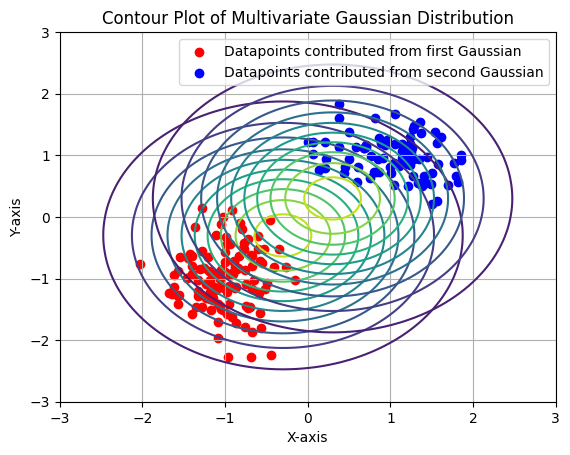

Iteration Number:1
Current Likelihood: -419.6223909592089


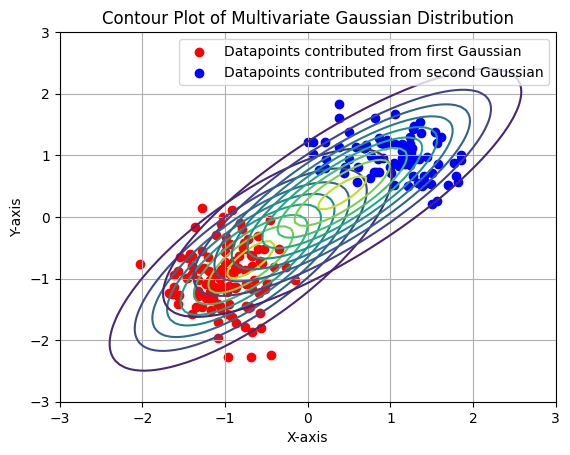

Iteration Number:2
Current Likelihood: -424.4575902676088


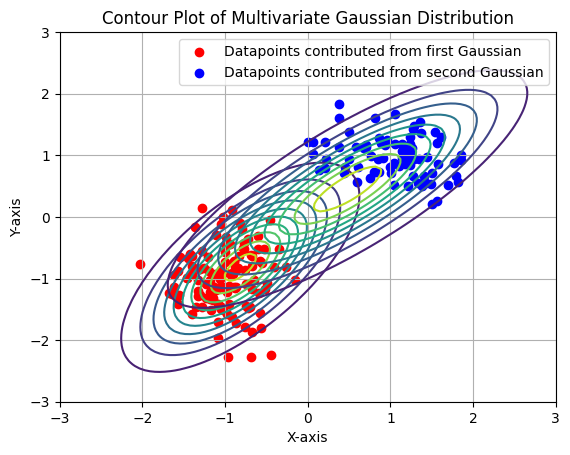

Iteration Number:3
Current Likelihood: -429.89220599329474


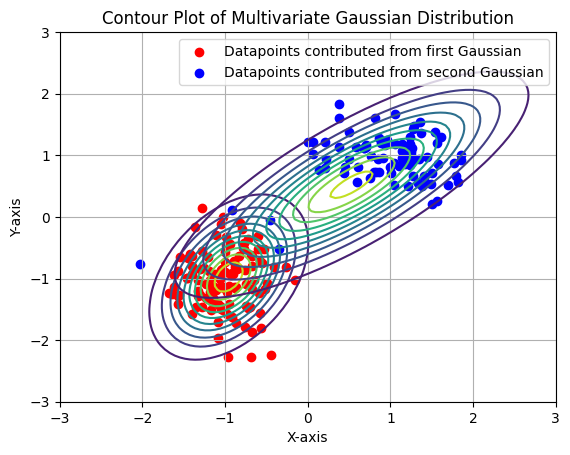

Iteration Number:4
Current Likelihood: -441.44813503403594


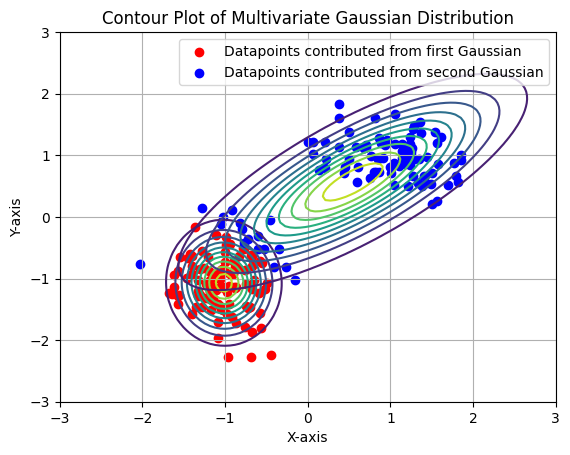

Iteration Number:5
Current Likelihood: -444.65635395382253


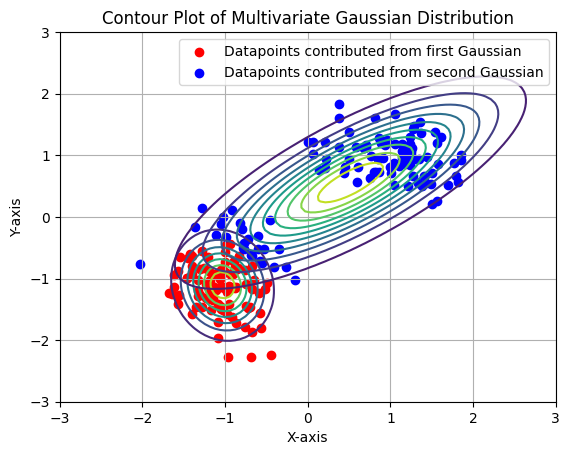

Iteration Number:6
Current Likelihood: -443.7334093974007


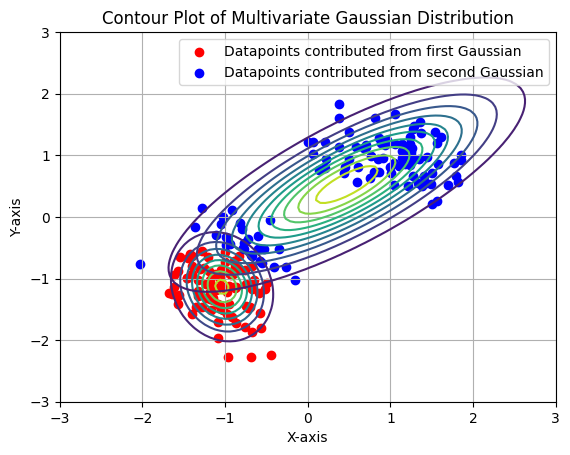

Iteration Number:7
Current Likelihood: -439.77278492361336


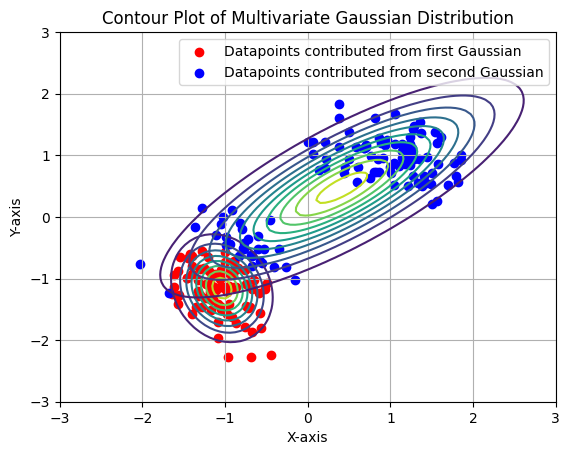

Iteration Number:8
Current Likelihood: -433.4164924666862


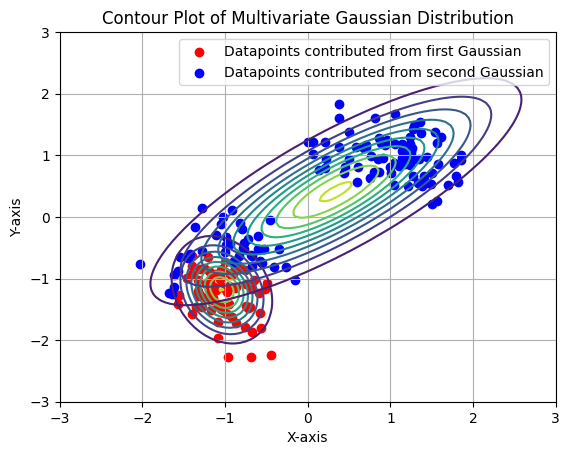

Iteration Number:9
Current Likelihood: -425.5638084741661


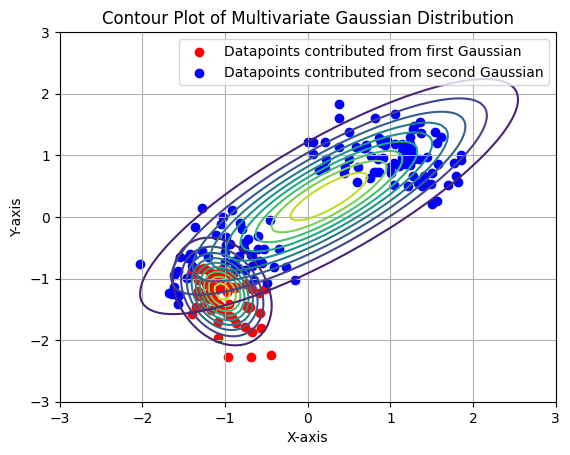

Iteration Number:10
Current Likelihood: -417.5092572319021


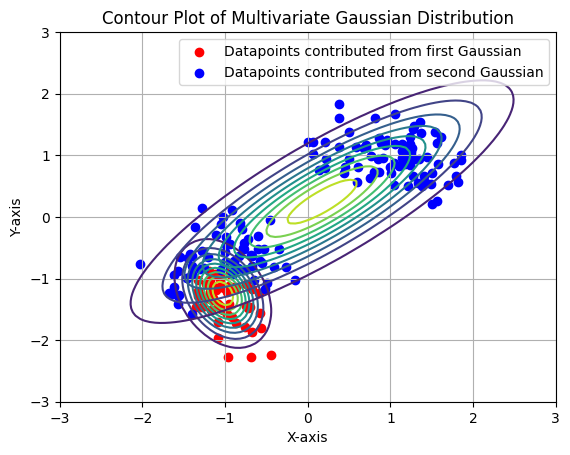

Iteration Number:11
Current Likelihood: -410.46590852058785


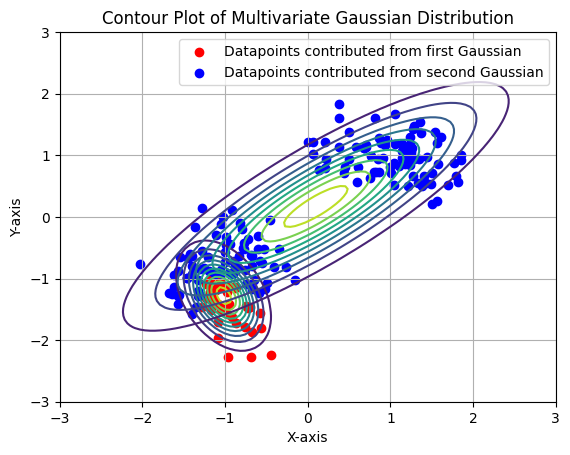

Iteration Number:12
Current Likelihood: -405.0433153057901


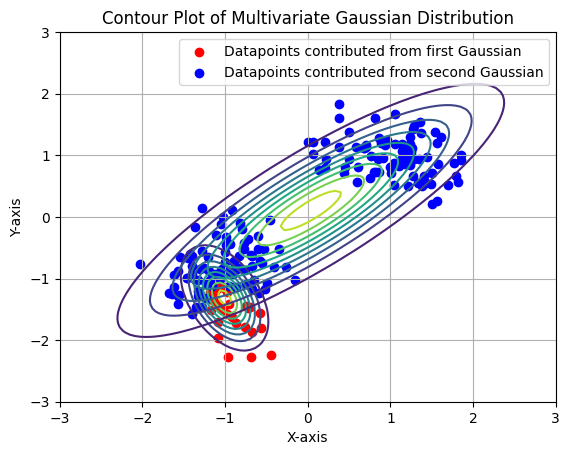

Iteration Number:13
Current Likelihood: -401.2274587361734


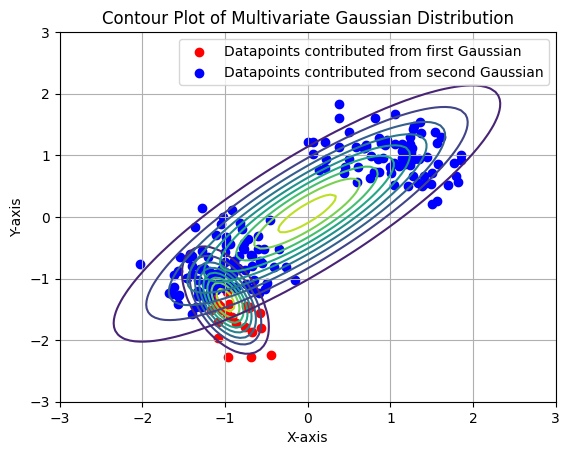

Iteration Number:14
Current Likelihood: -398.68042145757755


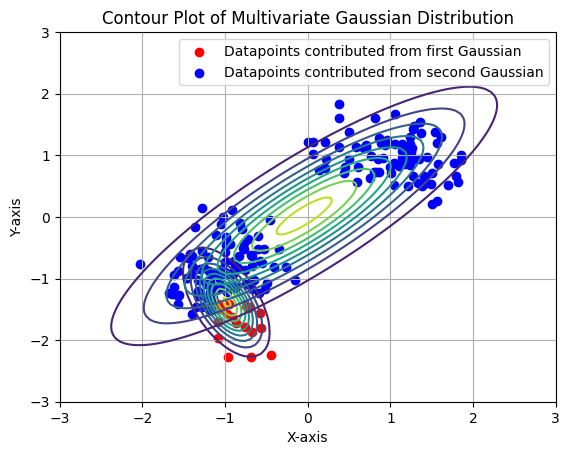

Iteration Number:15
Current Likelihood: -397.01088764602275


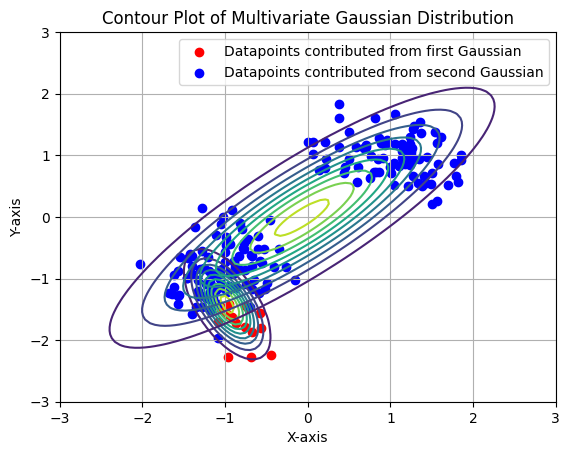

Iteration Number:16
Current Likelihood: -395.9051013450007


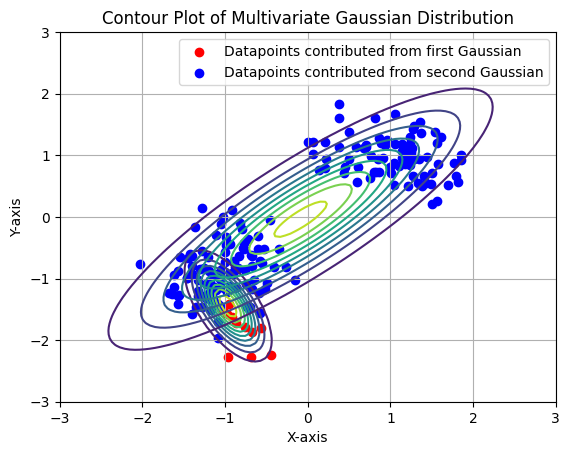

Iteration Number:17
Current Likelihood: -395.15195533872554


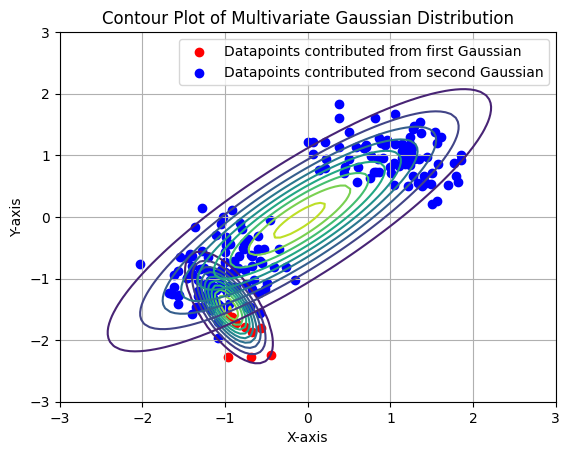

Iteration Number:18
Current Likelihood: -394.62110280913646


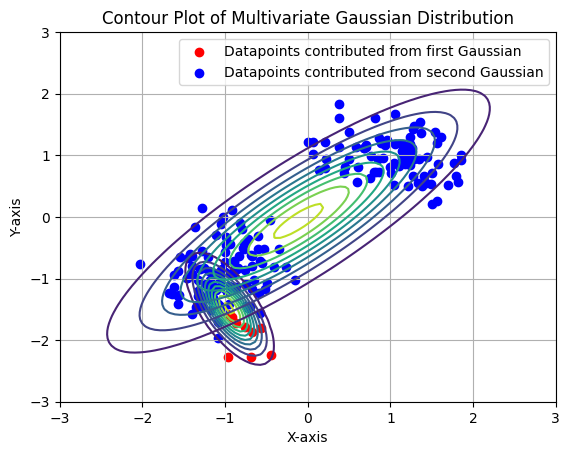

Iteration Number:19
Current Likelihood: -394.233914569871


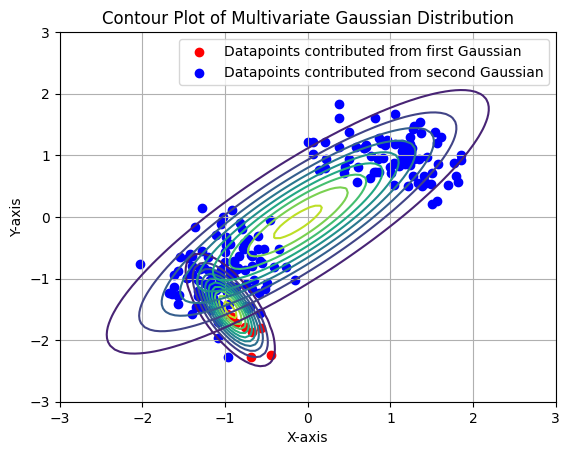

Iteration Number:20
Current Likelihood: -393.9421419185938


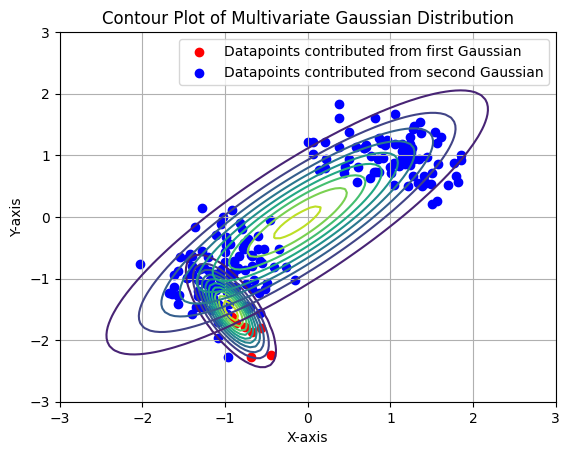

Iteration Number:21
Current Likelihood: -393.7151492260807


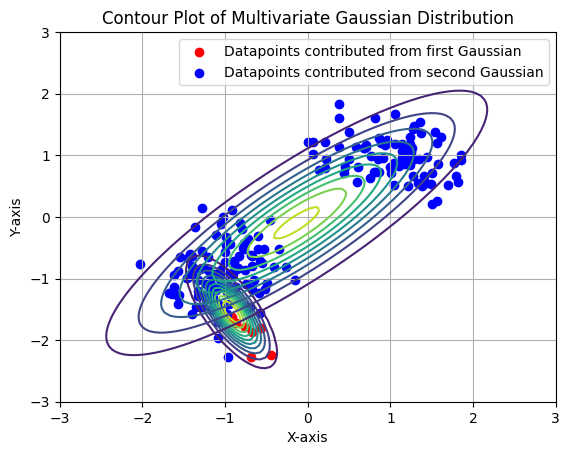

Iteration Number:22
Current Likelihood: -393.5328444624853


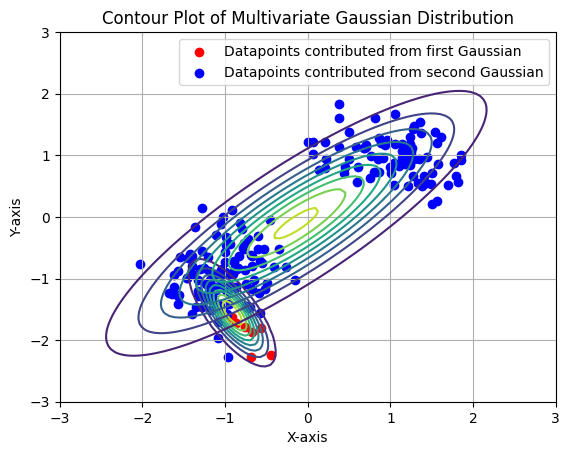

Iteration Number:23
Current Likelihood: -393.3818308696235


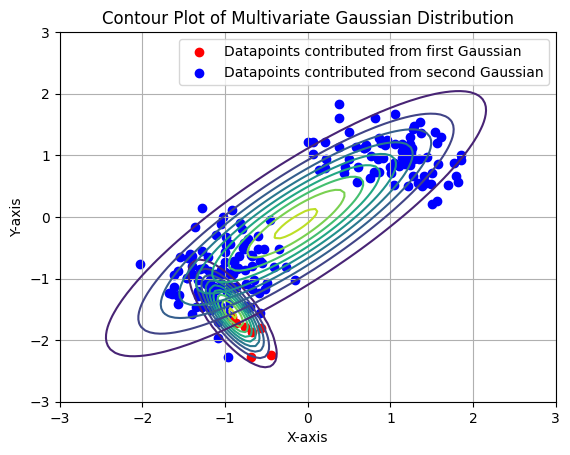

Iteration Number:24
Current Likelihood: -393.253309540342


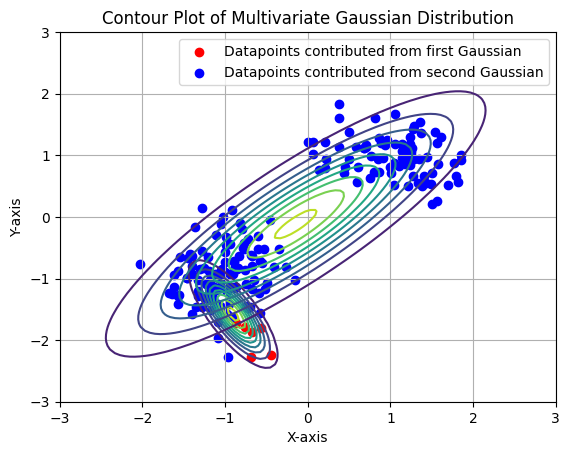

Iteration Number:25
Current Likelihood: -393.1419189145661


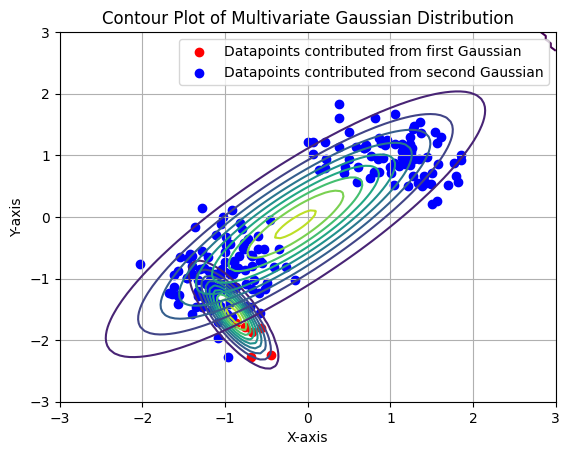

Iteration Number:26
Current Likelihood: -393.0449820732923


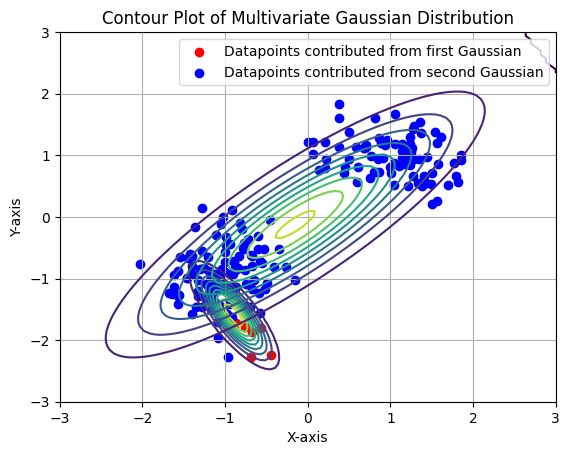

Iteration Number:27
Current Likelihood: -392.96174495948696


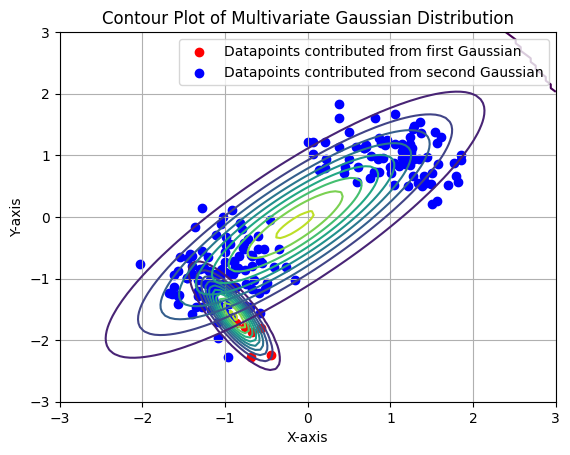

Iteration Number:28
Current Likelihood: -392.89238611722806


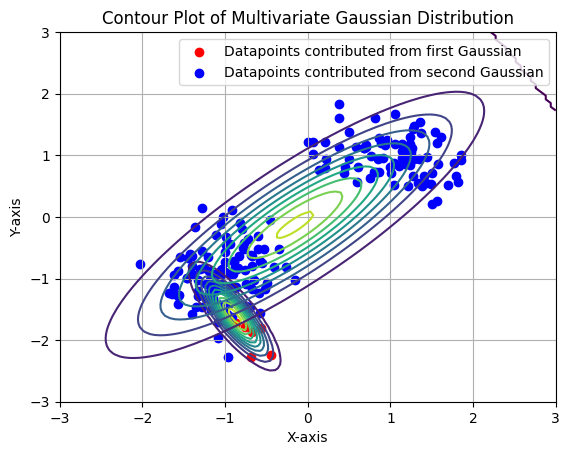

Iteration Number:29
Current Likelihood: -392.8369700388957


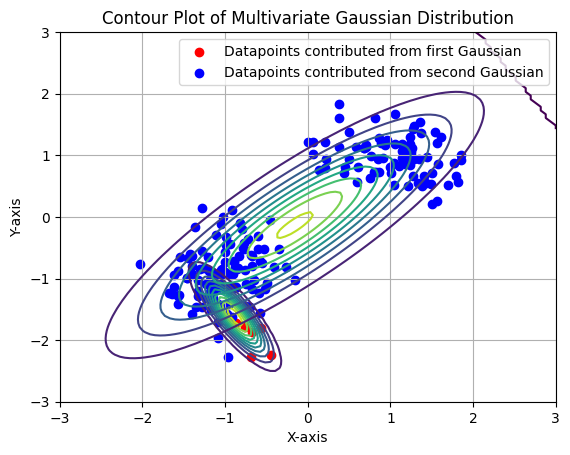

Iteration Number:30
Current Likelihood: -392.7947909219945


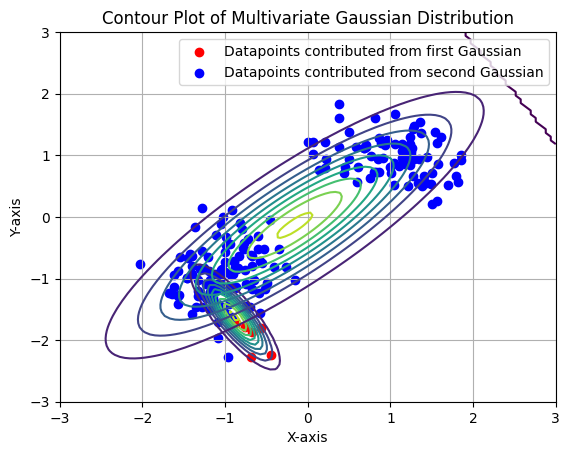

Iteration Number:31
Current Likelihood: -392.76433566538134


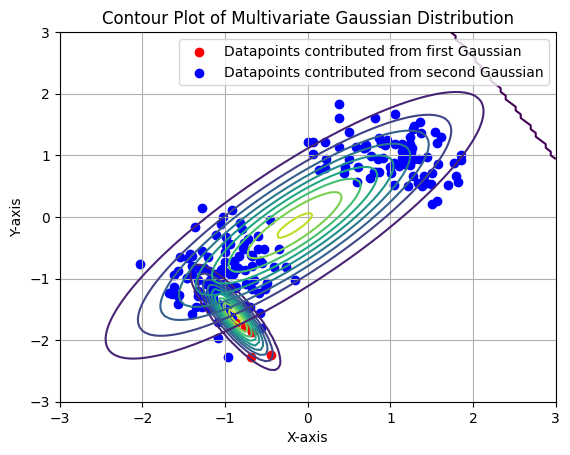

Iteration Number:32
Current Likelihood: -392.7436463662651


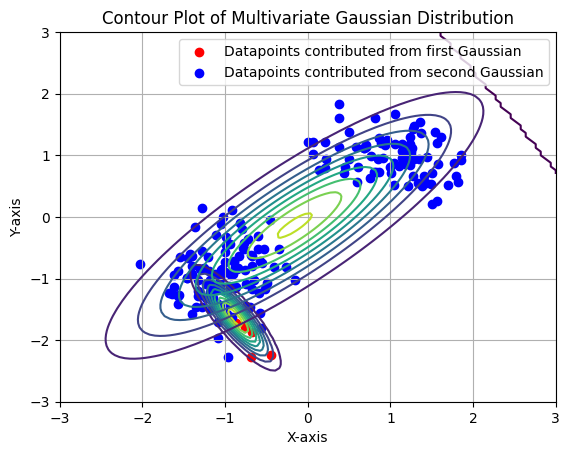

Iteration Number:33
Current Likelihood: -392.7307217096083


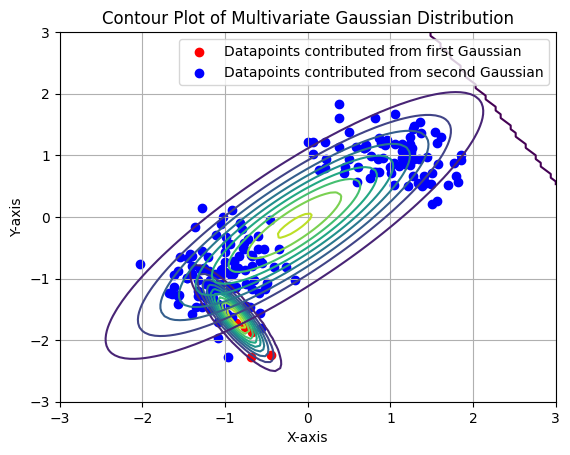

Iteration Number:34
Current Likelihood: -392.7237713566423


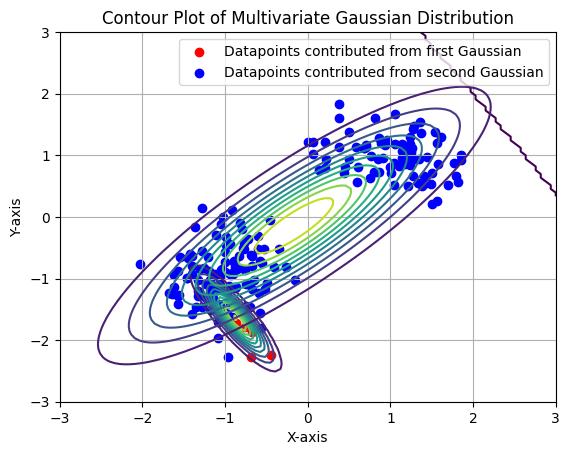

Iteration Number:35
Current Likelihood: -392.7213178760723


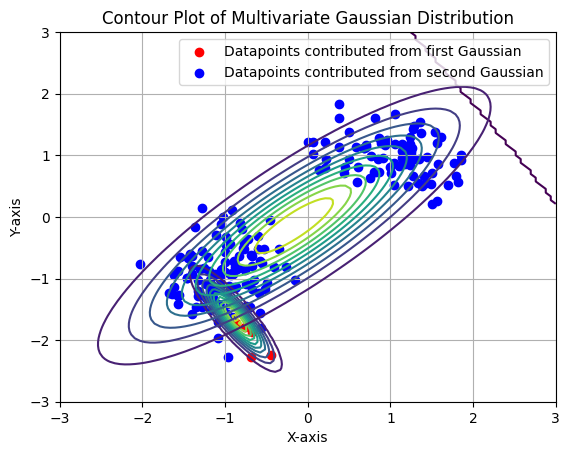

Iteration Number:36
Current Likelihood: -392.72220310726334


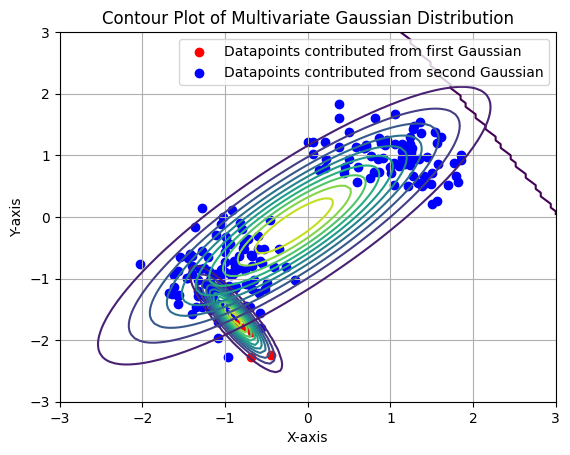

Iteration Number:37
Current Likelihood: -392.72554939757543


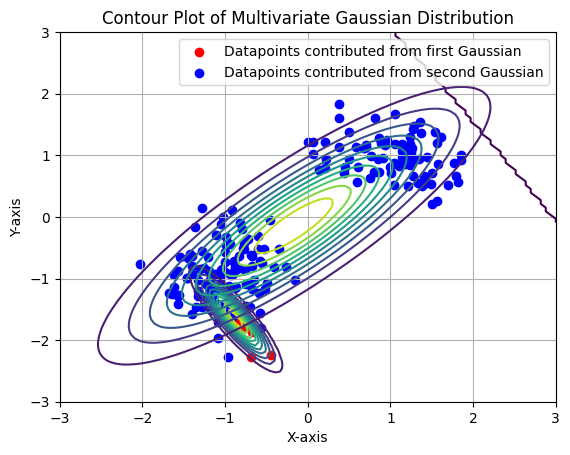

Iteration Number:38
Current Likelihood: -392.73070602431255


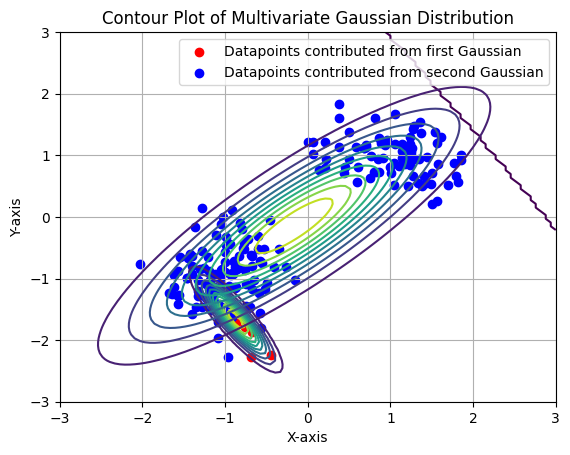

Iteration Number:39
Current Likelihood: -392.73719607017756


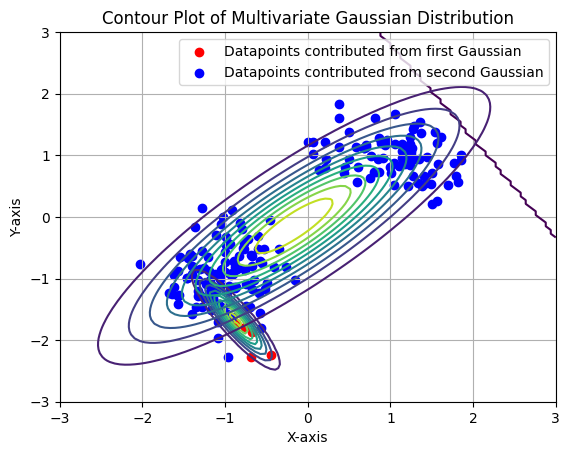

Iteration Number:40
Current Likelihood: -392.74467030504354


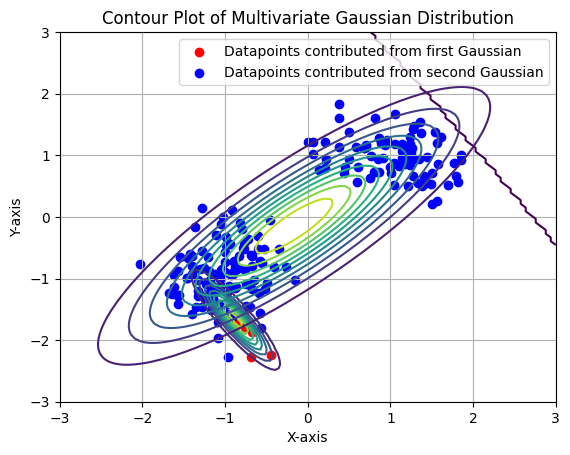

Iteration Number:41
Current Likelihood: -392.7528700577743


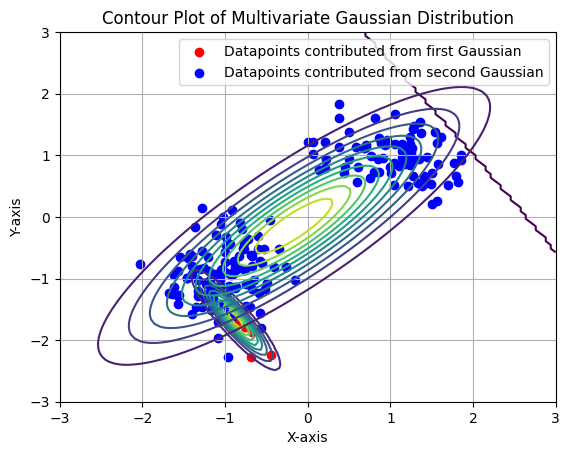

Iteration Number:42
Current Likelihood: -392.7615988708166


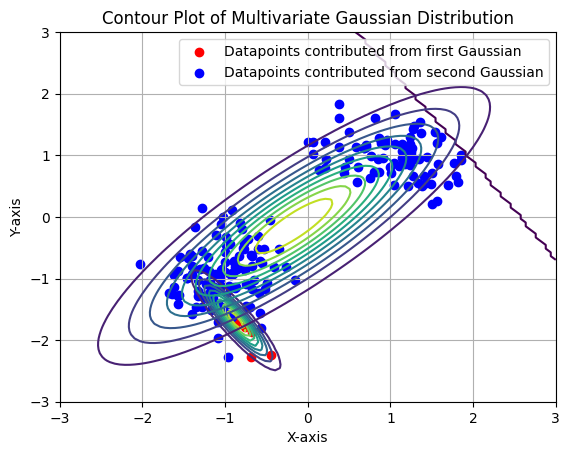

Iteration Number:43
Current Likelihood: -392.77070183161834


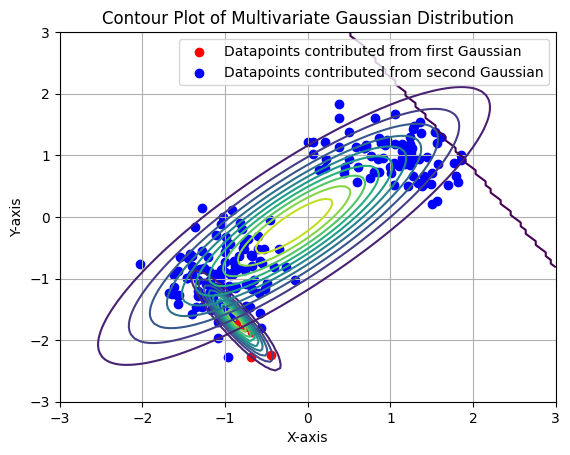

Iteration Number:44
Current Likelihood: -392.78005122829313


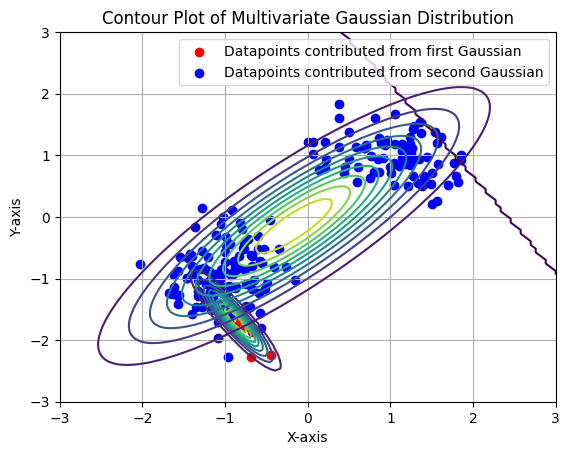

Iteration Number:45
Current Likelihood: -392.7895372171221


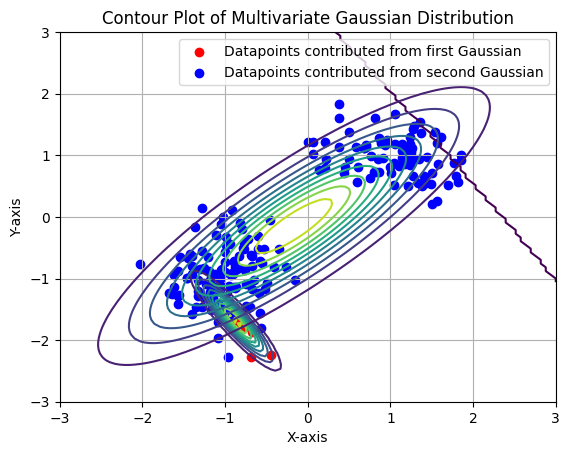

Iteration Number:46
Current Likelihood: -392.7990623228285


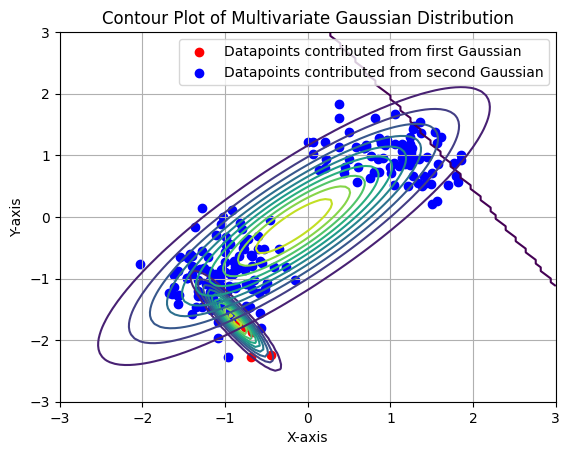

Iteration Number:47
Current Likelihood: -392.80853872291175


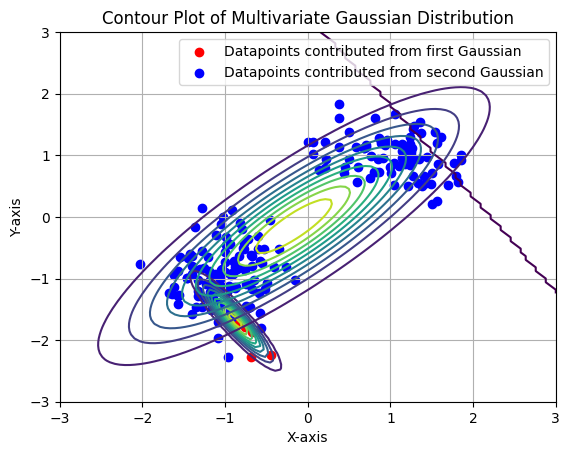

Iteration Number:48
Current Likelihood: -392.81788733831047


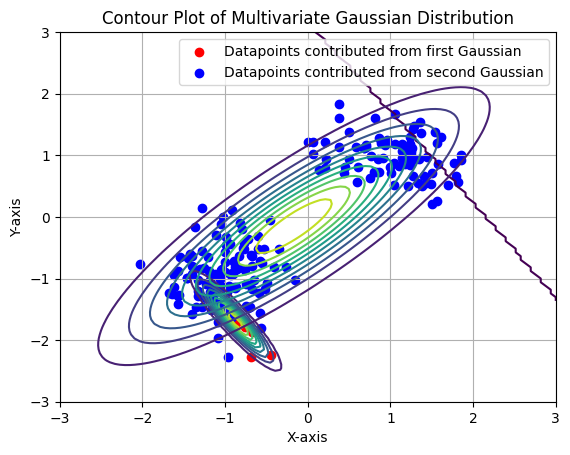

Iteration Number:49
Current Likelihood: -392.82703770227397


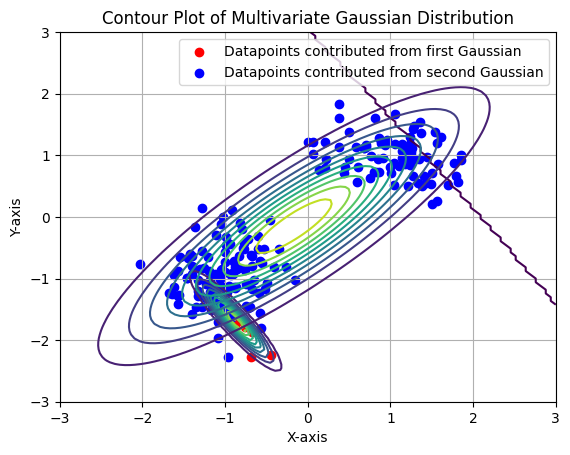

In [ ]:
############################################################################
##Part-6)-d: Understand the issues with EM algorithm
############################################################################


# Diagonal Covariances
# Singularity may occur with below initialization

data = data_dg    #data to run EM-algorithm
labels = labels_dg  #labels
N = 200       #number of input examples
D = 2       #data dimension
M = 2       #no.of components in GMM

pi = np.array([0.5, 0.5])      #Initialize the prior probabilities
mu1_i = np.array([-0.3, -0.3])
mu2_i = np.array([0.3, 0.3])
sig1_i = np.array([[1, 0], [0, 1]])
sig2_i = np.array([[1, 0], [0, 1]])

mu = np.asarray([mu1_i, mu2_i])      #Initialize the mean vectors
sigma = np.asarray([sig1_i, sig2_i])   #Initialize the covariance matrices


nsteps = 50  #Number of steps to run EM algorithm
for index in range(0,nsteps,1):

  print("Iteration Number:" + str(index))

  #Compute the likelihood
  ll = likelihood(data, pi, mu, sigma, log_likelihood=True)
  print("Current Likelihood: " + str(ll))

  #Expectation step
  gamma = expectation(data, pi, mu, sigma)

  #Plot the contours
  plot_contours(data, labels, pi, mu, sigma, gamma)

  #Maximization step
  pi, mu, sigma = maximization(data, gamma)

<b> Report your observations </b>

1. Expectation-Maximation is highly dependent on parameter initialization for optimal convergence

2. When parameters are poorly initialized, one of the gaussians captures the entire dataset, and the other one locks onto a single point, trying to capture the single point better. This causes singularity.

3. When the clusters are 'further away' and each cluster are 'closer', the model performs better. Hence, for the given datasets, the data_full dataset converged more easily compared to the data_sp and the data_dg datasets. The other two datasets were more prone to singularity on testing

